<b><font size="6"> Data Mining Project - Group 40 2025/2026 </font></b><br><br>
<i> <font size="4"> Amazing International Airlines Inc. (AIAI)</font></i>

`Group 40`

20250380 Maria Fonseca <br>
20250405 Ana Macedo <br>
20250453 Lourenço Silva <br>

### <font color='#BFD72F'>**Methodology** </font> <a class="anchor" id='toc'></a> 


- [1. Import libraries](#1) 
- [2. Loading the Data](#2) 
- [3. Metadata](#3)
- [4. Business Understanding](#4)
- [5. Data Understanding](#5)
    - [5.1 Flights Dataset](#5_1)
        - [5.1.1 General Look at the DataSet (FlightsDB)](#5_1_1)
        - [5.1.2 Data Quality Check (FlightsDB)](#5_1_2)
        - [5.1.3 Deeper Analysis on FlightsDB dataset](#5_1_3)
    - [5.2 Customer Dataset](#5_2)
        - [5.2.1 General Look at the Data (CustomerDB)](#5_2_1)
        - [5.2.2 Data Quality Check (CustomerDB)](#5_2_2)
        - [5.2.3 Deeper Analysis on CustomerDB dataset](#5_2_3)
- [6. Descriptive Statistics and Visualisations](#6)
    - [6.1 FlightsDB](#6_1)
        - [6.1.1 Metric Features Visualizations](#6_1_1)
        - [6.1.2 Relationship between Metric Features](#6_1_2)
        - [6.1.3 Categorical Features Visualizations](#6_1_3)
        - [6.1.4 Numeric and Categorical Features Visualizations](#6_1_4)
    - [6.2 CustomerDB](#6_2)
        - [6.2.1 Metric Features Visualizations](#6_2_1)
        - [6.2.2 Relationship between Metric Features (CustomerDB)](#6_2_2)
        - [6.2.3 Categorical visualizations (CustomerDB)](#6_2_3)
        - [6.2.4 Relationship between Categorical Features](#6_2_4)
- [7. Geo-Spatial Insights (Extra 1)](#7)
- [8. Interactive EDA Dashboard (Extra 2)](#8)
    - [8.1 Prerequisit Files](#8_1)
    - [8.2 Write Streamlit Dashboard](#8_2)
- [9. Feature Engineering](#9)
    - [9.1 FlightsDB](#9_1)
        - [9.1.1 Selecting Created Features](#9_1_1)
    - [9.2 CustomerDB](#9_2)
        - [9.2.1 Selecting Created Features](#9_2_1)
    - [9.3 Feature Engineering with Merged Datasets](#9_3)
        - [9.3.1 Merge Datasets](#9_3_1)
        - [9.3.2 Add Features](#9_3_2)
        - [9.3.3 Select Created Features](#9_3_3)
    - [9.4 Summary of Engineered Features](#9_4)
- [10. Engineered Features' Visualisations](#10)
    - [10.1 FlightsDB](#10_1)
    - [10.2 CustomerDB](#10_2)
    - [10.3 Merged Datasets](#10_3)




<a class="anchor" id="1">

# **1. Import libraries**

[Back to TOC](#toc)
</a>

In this section, we import the essential Python libraries that will support data processing, visualization, and analysis throughout the project. Each library provides specific functionality that helps streamline the workflow.

In [89]:
import sqlite3
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from math import ceil

# To show all columns in the dataframe
!pip install tabulate
import itertools
from itertools import zip_longest
from tabulate import tabulate

# For Geo-Spatial Insights Extra
!pip install folium
from itertools import product
from ydata_profiling import ProfileReport
import folium
from folium.plugins import MarkerCluster
from IPython.display import display
from folium import IFrame


# For Interactive EDA Dashboard Extra
!pip install streamlit streamlit-jupyter

# for better resolution plots
%config InlineBackend.figure_format = 'retina'

# svg can amplify graphs infinitely without losing image quality but it can be slow with complex graphs 
# so we will use retina for better performance

np.random.seed(40311)
sns.set()

<a class="anchor" id="2">

# **2. Loading the Data**

[Back to TOC](#toc)
</a>

In this section, we load the datasets from CSV files using commas as column separators and set the unique customer identifier as the index for both tables. This step ensures that the data is properly structured, accessible, and ready for further exploration and analysis.

In [90]:
flightsDB = pd.read_csv('data/DM_AIAI_FlightsDB.csv', sep = ",", index_col= "Loyalty#")
customerDB = pd.read_csv('data/DM_AIAI_CustomerDB.csv', sep = ",", index_col= "Loyalty#")
metaData = pd.read_csv('data/DM_AIAI_Metadata.csv', sep = ";", header= None)

Remove the 'Unnamed' column referring to a sequential numbering of the rows, as we set the column "Loyalty#" as the index

In [91]:
customerDB = customerDB.iloc[:, 1:]
customerDB

,First Name,Last Name,Customer Name,Country,Province or State,City,Latitude,Longitude,Postal code,Gender,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType
Loyalty#,,,,,,,,,,,,,,,,,,,
480934,Cecilia,Householder,Cecilia Householder,Canada,Ontario,Toronto,43.653225,-79.383186,M2Z 4K1,female,Bachelor,Urban,70146.0,Married,Star,2/15/2019,NaN,3839.14,Standard
549612,Dayle,Menez,Dayle Menez,Canada,Alberta,Edmonton,53.544388,-113.490930,T3G 6Y6,male,College,Rural,0.0,Divorced,Star,3/9/2019,NaN,3839.61,Standard
429460,Necole,Hannon,Necole Hannon,Canada,British Columbia,Vancouver,49.282730,-123.120740,V6E 3D9,male,College,Urban,0.0,Single,Star,7/14/2017,1/8/2021,3839.75,Standard
608370,Queen,Hagee,Queen Hagee,Canada,Ontario,Toronto,43.653225,-79.383186,P1W 1K4,male,College,Suburban,0.0,Single,Star,2/17/2016,NaN,3839.75,Standard
530508,Claire,Latting,Claire Latting,Canada,Quebec,Hull,45.428730,-75.713364,J8Y 3Z5,male,Bachelor,Suburban,97832.0,Married,Star,10/25/2017,NaN,3842.79,2021 Promotion
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100012,Ethan,Thompson,Ethan Thompson,Canada,Quebec,Quebec City,46.759733,-71.141009,Y0C 7D6,male,Bachelor,Suburban,NaN,Single,Star,2/27/2019,2/27/2019,NaN,Standard
100013,Layla,Young,Layla Young,Canada,Alberta,Edmonton,53.524829,-113.546357,L3S 9Y3,female,Bachelor,Rural,NaN,Married,Star,9/20/2017,9/20/2017,NaN,Standard
100014,Amelia,Bennett,Amelia Bennett,Canada,New Brunswick,Moncton,46.051866,-64.825428,G2S 2B6,male,Bachelor,Rural,NaN,Married,Star,11/28/2020,11/28/2020,NaN,Standard


<a class="anchor" id="3">

# **3. Metadata**

[Back to TOC](#toc)
</a>

In this section, we provide a detailed description of the features contained in both datasets, FlightsDB and CustomerDB. Understanding the meaning and structure of each attribute is essential for interpreting the data correctly and guiding subsequent analytical steps.

**FlightsDB Database feature Description**
- **Loyalty#:**	Unique customer identifier linking to CustomerDB
- **Year:**	Year of flight activity record
- **Month:**	Month of flight activity record (1-12)
- **YearMonthDate:**	First day of the month for the activity period
- **NumFlights:**	Total number of flights taken by customer in the month
- **NumFlightsWithCompanions:**	Number of flights where customer traveled with companions
- **DistanceKM:**	Total distance traveled in kilometers for the month
- **PointsAccumulated:**	Loyalty points earned by customer during the month
- **PointsRedeemed:**	Loyalty points spent/redeemed by customer during the month
- **DollarCostPointsRedeemed:**	Dollar value of points redeemed during the month

**CustomerDB Database feature Description**
- **Loyalty#:**  Unique customer identifier for loyalty program members
- **First Name:**   Customer's first name
- **Last Name:**   Customer's last name 
- **Customer Name:** Customer's full name (concatenated)
- **Country:**	Customer's country of residence
- **Province or State:**	Customer's province or state
- **City:**	Customer's city of residence
- **Latitude:**	Geographic latitude coordinate of customer location
- **Longitude:**	Geographic longitude coordinate of customer locatio
- **Postal code:**	Customer's postal/ZIP code
- **Gender:**	Customer's gender
- **Education:**	Customer's highest education level (Bachelor, College, etc.)
- **Location:** Code	Urban/Suburban/Rural classification of customer residence
- **Income:**	Customer's annual income
- **Marital Status:**	Customer's marital status (Married, Single, Divorced)
- **LoyaltyStatus:**	Current tier status in loyalty program (Star > Nova > Aurora)
- **EnrollmentDateOpening:**	Date when customer joined the loyalty program
- **CancellationDate:**	Date when customer left the program
- **Customer Lifetime:** Value	Total calculated monetary value of customer relationship
- **EnrollmentType:**	Method of joining loyalty program

<a class="anchor" id="4">

# **4. Business Understanding**

[Back to TOC](#toc)
</a>

Amazing International Airlines Inc. (AIAI) operates in a highly competitive industry, where customer retention and loyalty are essential for profitability. 

The company has a loyalty program but lacks personalization and individualized engagement strategies, limiting its ability to achieve high levels of customer satisfaction. As a result, marketing campaigns and rewards are often generic, reducing the effectiveness of loyalty initiatives. 

The company’s main challenge is to reduce customer churn and optimize the performance of its loyalty program. Without detailed insights into the different customer profiles, it becomes difficult to offer personalized services and targeted offers that enhance satisfaction and engagement. 

The main goal is to implement a data-driven approach to segment AIAI’s customers, identifying distinct groups based on behavioral, demographic, and value-related factors. This segmentation will allow the company to create personalized marketing strategies, develop targeted loyalty offers, and ultimately reduce customer churn by 5%, which corresponds to approximately €50,000 in monthly savings. To support these business goals, the project will aim to develop a clustering model capable of distinguishing customer profiles, create customer segments and ensure the model is scalable and adaptable to evolving customer behavior.

 The project will follow five main stages, aligned with the CRISP-DM methodology. 
 It will begin with an exploratory data analysis (EDA) to understand the available data, assess its quality, and identify potential issues such as missing values or outliers. 
 The second stage will involve data preprocessing, including cleaning, normalization, and transformation to prepare the dataset for clustering. 
 Next, clustering techniques will be applied to identify distinct customer groups based on behavioral, demographic, and value-related factors. 
 The fourth stage will focus on evaluating the model’s performance and interpreting the resulting segments to extract actionable marketing insights. Finally, the model will be deployed and continuously monitored to ensure scalability and adaptability as customer behavior evolves.

<a class="anchor" id="5">

# **5. Data Understanding**

[Back to TOC](#toc)
</a>

In this section, we explore the datasets to gain a comprehensive understanding of their structure and content. This includes inspecting the shape, column names, and data types, as well as generating summary statistics and basic insights using functions such as info(), describe() among others. These steps help identify patterns, potential issues, and the general characteristics of the data.

<a class="anchor" id="3_1">

## **5.1** Flights Dataset

[Back to TOC](#toc)
</a>

<a class="anchor" id="5_1_1">

### **5.1.1** General Look at the DataSet (FlightsDB)
[Back to TOC](#toc)
</a>

Here we take an initial overview of the FlightsDB dataset, examining its structure, and general characteristics to gain a better understanding of the data before performing deeper analyses.

In [92]:
flightsDB.shape

(608436, 9)

In [93]:
flightsDB.head(15)


,Year,Month,YearMonthDate,NumFlights,NumFlightsWithCompanions,DistanceKM,PointsAccumulated,PointsRedeemed,DollarCostPointsRedeemed
Loyalty#,,,,,,,,,
413052,2021,12,12/1/2021,2.0,2.0,9384.0,938.0,0.0,0.0
464105,2021,12,12/1/2021,0.0,0.0,0.0,0.0,0.0,0.0
681785,2021,12,12/1/2021,10.0,3.0,14745.0,1474.0,0.0,0.0
185013,2021,12,12/1/2021,16.0,4.0,26311.0,2631.0,3213.0,32.0
216596,2021,12,12/1/2021,9.0,0.0,19275.0,1927.0,0.0,0.0
486956,2021,12,12/1/2021,12.0,7.0,23967.0,2396.0,0.0,0.0
247514,2021,12,12/1/2021,17.0,7.0,23029.0,2302.0,0.0,0.0
711864,2021,12,12/1/2021,6.0,0.0,25995.0,2599.0,0.0,0.0
721372,2021,12,12/1/2021,11.0,3.0,30758.0,3075.0,0.0,0.0


In [94]:
flightsDB.tail(15)

,Year,Month,YearMonthDate,NumFlights,NumFlightsWithCompanions,DistanceKM,PointsAccumulated,PointsRedeemed,DollarCostPointsRedeemed
Loyalty#,,,,,,,,,
999498,2019,12,12/1/2019,0.9,0.9,30283.2,3028.32,0.0,0.0
999513,2019,12,12/1/2019,0.0,0.0,0.0,0.00,0.0,0.0
999524,2019,12,12/1/2019,13.5,4.5,22572.9,2257.29,0.0,0.0
999550,2019,12,12/1/2019,8.1,0.0,18168.3,1816.83,0.0,0.0
999589,2019,12,12/1/2019,0.0,0.0,0.0,0.00,0.0,0.0
999631,2019,12,12/1/2019,3.6,1.8,12262.5,1226.25,0.0,0.0
999731,2019,12,12/1/2019,0.0,0.0,0.0,0.00,0.0,0.0
999758,2019,12,12/1/2019,0.0,0.0,0.0,0.00,0.0,0.0
999788,2019,12,12/1/2019,0.0,0.0,0.0,0.00,0.0,0.0


From the visualization of the head and tail of the data base we can already understand that some errors exist:

    - NumFlights and NumFlightsWithCompanions as floats...
    - PointsAccumulated and PointsRedeemed as floats. Should they be integers?
    - PointsRedeemed higher that PointsAccumulated can not happen.
We will further analyse this using describe and info.


<a class="anchor" id="5_1_2">

### **5.1.2** Data Quality Check (FlightsDB)
[Back to TOC](#toc)
</a>

In this section, we evaluate the quality of our datasets to ensure they are suitable for analysis. This includes checking for missing values, duplicates, and other potential data issues.

In [95]:
flightsDB.info()

<class 'pandas.core.frame.DataFrame'>
Index: 608436 entries, 413052 to 999986
Data columns (total 9 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Year                      608436 non-null  int64  
 1   Month                     608436 non-null  int64  
 2   YearMonthDate             608436 non-null  object 
 3   NumFlights                608436 non-null  float64
 4   NumFlightsWithCompanions  608436 non-null  float64
 5   DistanceKM                608436 non-null  float64
 6   PointsAccumulated         608436 non-null  float64
 7   PointsRedeemed            608436 non-null  float64
 8   DollarCostPointsRedeemed  608436 non-null  float64
dtypes: float64(6), int64(2), object(1)
memory usage: 46.4+ MB


From info we can see that:

    - NumFlights and NumFlightsWithCompanions as floats...
    - PointsAccumulated and PointsRedeemed as floats. Should they be integers? 
    - There aren't missing values

What will we do?

    Analyse with describe to have a different view

Before performing any detailed analysis, it is important to confirm confirm the missing values in the dataset. 
This step helps assess data quality and ensures that the analyses we perform later are reliable.
The following function calculates both the count and percentage of missing values for each column, making it easy to identify any gaps in the data.

After implementing the function and use it for Flights dataset we verify that this dataset has no missing values, indicating that the data is complete and ready for analysis.

In [96]:
# This function checks for missing values in a dataset. 
# It calculates both the absolute count and the percentage of missing values per column, 
# making it easy to quickly identify data quality issues and it can be used to check missing values in customer dataset.
def check_missing(df, name="Dataset"):
    missing_values = df.isna().sum()
    percentage = df.isna().mean() * 100
    result = pd.DataFrame({
        "Missing Count": missing_values,
        "Missing %": percentage
    })
    if result["Missing Count"].sum() == 0:
        print(f"No missing values in {name}!")
    else:
        print(f"Missing values in {name}:")
        display(result[ result["Missing Count"] > 0 ])  # show only columns with missing values


check_missing(flightsDB, "Flights Dataset")

No missing values in Flights Dataset!


In [97]:
flightsDB.describe().T

,count,mean,std,min,25%,50%,75%,max
Year,608436.0,2020.000000,0.816497,2019.0,2019.00,2020.000,2021.0000,2021.0
Month,608436.0,6.500000,3.452055,1.0,3.75,6.500,9.2500,12.0
NumFlights,608436.0,3.908107,5.057889,0.0,0.00,0.000,7.2000,21.0
NumFlightsWithCompanions,608436.0,0.983944,2.003785,0.0,0.00,0.000,0.9000,11.0
DistanceKM,608436.0,7939.341419,10260.421873,0.0,0.00,856.400,15338.1750,42040.0
PointsAccumulated,608436.0,793.777781,1025.918521,0.0,0.00,85.275,1533.7125,4204.0
PointsRedeemed,608436.0,235.251678,983.233374,0.0,0.00,0.000,0.0000,7496.0
DollarCostPointsRedeemed,608436.0,2.324835,9.725168,0.0,0.00,0.000,0.0000,74.0


In [98]:
flightsDB.describe(include='object')

,YearMonthDate
count,608436
unique,36
top,12/1/2021
freq,16901


From both numeric and categorical describe we can conclude that the dataset contains a large proportion of low or inactive months, as shown by the median number of monthly flights equal to zero. However, features such as DistanceKM and PointsAccumulated have non-zero medians, indicating that a substantial subset of customers still engage in flight activity during many months.

All major numeric features are strongly right-skewed, with minimum values of 0 in all of them and very high maximum values that suggest the presence of a small group of highly active travelers who contribute disproportionately to total distance and point accumulation. PointsRedeemed and DollarCostPointsRedeemed have medians of zero, confirming that redemption activity is relatively rare compared to earning.

The dataset includes records for every month over three years (2019–2021), totaling 36 distinct monthly periods, and identical count values across all numeric features seem to indicate that there is no missing data. Overall, the data appears to show consistent coverage, good quality, and variability in customer engagement levels.

<a class="anchor" id="5_1_2">

### **5.1.3** Deeper Analysis on FlightsDB dataset
[Back to TOC](#toc)
</a>

This section delves into a more detailed examination of the FlightsDB dataset, exploring distributions, patterns, and relationships between features to uncover insights and better understand customer behavior.

<p style="font-size:24px;">Unique</p>

This analysis of unique values gives a quick overview of the dataset, showing which features are diverse, nearly unique, or categorical with limited options.

After this analysis we can se that the features Year, Month, and YearMonthDate columns show full temporal coverage, confirming that all expected periods are represented. Numeric activity features (NumFlights, NumFlightsWithCompanions, DistanceKM, PointsAccumulated, PointsRedeemed, DollarCostPointsRedeemed) exhibit a large number of unique values, indicating continuous or high-cardinality data. Some values in NumFlights, NumFlightsWithCompanions appear as floats with fractional values, suggesting possible errors. Zeros are common across most activity features, highlighting frequent inactivity periods for many customers. Extreme maximum values in distance and points indicate the presence of outliers and possible errors.

The unique values analysis highlights feature diversity and potential data issues, providing a foundation for further exploration and cleaning.


In [99]:
for column in flightsDB.columns:
    unique_values = flightsDB[column].unique()
    print(f"Unique values on the column '{column}': {unique_values}")
    print('-----------------------------------')
    print('')

Unique values on the column 'Year': [2021 2020 2019]
-----------------------------------

Unique values on the column 'Month': [12  6  5  4  3  2  1 11 10  9  8  7]
-----------------------------------

Unique values on the column 'YearMonthDate': ['12/1/2021' '6/1/2020' '5/1/2020' '4/1/2020' '3/1/2020' '2/1/2020'
 '1/1/2020' '11/1/2021' '10/1/2021' '6/1/2021' '9/1/2021' '5/1/2021'
 '4/1/2021' '8/1/2021' '7/1/2021' '3/1/2021' '2/1/2021' '1/1/2021'
 '12/1/2020' '11/1/2020' '10/1/2020' '9/1/2020' '8/1/2020' '7/1/2020'
 '1/1/2019' '2/1/2019' '3/1/2019' '4/1/2019' '5/1/2019' '6/1/2019'
 '7/1/2019' '8/1/2019' '9/1/2019' '10/1/2019' '11/1/2019' '12/1/2019']
-----------------------------------

Unique values on the column 'NumFlights': [ 2.   0.  10.  16.   9.  12.  17.   6.  11.   7.   3.  13.  14.   8.
  5.   4.   1.  15.  18.  20.  19.  21.   2.7  5.4  9.9  7.2  8.1  3.6
  6.3  4.5  1.8  0.9 11.7 10.8 12.6 13.5 14.4 15.3 17.1 16.2 18.9]
-----------------------------------

Unique values on 

<p style="font-size:24px;">Values Count</p>


The value_counts() analysis shows the distribution of values across the dataset.

After this analysis we are able to check again that the dataset shows balanced temporal coverage across years and months. A large proportion of customer-months have zero flights or zero flights with companions, highlighting frequent inactivity. Numeric activity features (DistanceKM, PointsAccumulated, PointsRedeemed, DollarCostPointsRedeemed) are highly feature. Once more we notice that some features count based contain fractional values (NumFlights, NumFlightsWithCompanions). Beyond these general patterns, customer-level aggregation reveals variation in total flights, distances traveled, and points activity. Ratios like points per kilometer or companion travel rates can be further analysed to enrich the understanding of customer behavior. 

Overall, the value counts highlight which categories and values are most frequent, giving a sense of concentration versus diversity in the dataset.

In [100]:
for column in flightsDB.columns:
    unique_values = flightsDB[column].value_counts()
    print(f"The number of the distinct values in the column '{column}': {unique_values}")
    print('-----------------------------------')
    print('')

The number of the distinct values in the column 'Year': Year
2021    202812
2020    202812
2019    202812
Name: count, dtype: int64
-----------------------------------

The number of the distinct values in the column 'Month': Month
12    50703
6     50703
5     50703
4     50703
3     50703
2     50703
1     50703
11    50703
10    50703
9     50703
8     50703
7     50703
Name: count, dtype: int64
-----------------------------------

The number of the distinct values in the column 'YearMonthDate': YearMonthDate
12/1/2021    16901
6/1/2020     16901
10/1/2020    16901
9/1/2020     16901
8/1/2020     16901
7/1/2020     16901
1/1/2019     16901
2/1/2019     16901
3/1/2019     16901
4/1/2019     16901
5/1/2019     16901
6/1/2019     16901
7/1/2019     16901
8/1/2019     16901
9/1/2019     16901
10/1/2019    16901
11/1/2019    16901
11/1/2020    16901
12/1/2020    16901
1/1/2021     16901
10/1/2021    16901
5/1/2020     16901
4/1/2020     16901
3/1/2020     16901
2/1/2020     16901
1/1/202

<p style="font-size:24px;">Check Duplicated Values</p>


In [101]:
#Check how many duplicates exist
print(flightsDB.duplicated().sum())

#check the percentage of duplicates in our DataFrame
print(flightsDB.duplicated().sum() / len(flightsDB) * 100)

301411
49.53865320263758


!!!!    The percentage of duplicates ir almost 50%    !!!!

Because of this we understand that having Loyalty# as an index can be a wrong approach to check the duplicates so we read again our csv file and assign it to the feature flightsDB with the Loyalty# as a feature to check again the duplicates considering this feature.

In [102]:
flightsDB = pd.read_csv('data/DM_AIAI_FlightsDB.csv', sep = ",")
flightsDB.duplicated().sum() / len(flightsDB) * 100

np.float64(0.4771249564457067)

From the new calculation, we found only 0.48% duplicated records. Dropping these duplicates would not result in a significant loss of information, as they represent a very small portion of the dataset. Further we will decide what to do with them.

In [103]:
flightsDB[flightsDB["Loyalty#"] == 263267]
#Here we check that there are duplicates for the Loyalty# number 263267
#the DataFrame below show us all the Data associated to this Loyalty number and we can see that some rows have the exactly same information


,Loyalty#,Year,Month,YearMonthDate,NumFlights,NumFlightsWithCompanions,DistanceKM,PointsAccumulated,PointsRedeemed,DollarCostPointsRedeemed
1092,263267,2020,6,6/1/2020,0.0,0.0,0.0,0.0,0.0,0.0
3150,263267,2020,6,6/1/2020,0.0,0.0,0.0,0.0,0.0,0.0
14057,263267,2020,5,5/1/2020,0.0,0.0,0.0,0.0,0.0,0.0
25441,263267,2020,5,5/1/2020,0.0,0.0,0.0,0.0,0.0,0.0
37425,263267,2020,4,4/1/2020,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
560775,263267,2019,10,10/1/2019,0.0,0.0,0.0,0.0,0.0,0.0
577675,263267,2019,11,11/1/2019,0.0,0.0,0.0,0.0,0.0,0.0
577676,263267,2019,11,11/1/2019,0.0,0.0,0.0,0.0,0.0,0.0
594576,263267,2019,12,12/1/2019,0.0,0.0,0.0,0.0,0.0,0.0


There are 72 equal rows meaning all 36 unique values (corresponding to 12 months over 3 years) are duplicated.

As said before, to be sure that we are not losing any information, we need to introduce the column "Loyalty#" as a feature and not a index. Because of that the code that follows assign the feature FlightsDB to the new feature created that consider "Loyalty#" as a feature.

After all the reasoning about the duplicates we decide to drop the duplicates, since they represent a minimal percentage of the total data and such a loss of information will not be significant for the final objective of this work.

In [104]:
#we drop the duplicates from the DataFrame with index
flightsDB.drop_duplicates(inplace= True)

# Check that the duplicates were removed
flightsDB.duplicated().sum()

np.int64(0)

<p style="font-size:24px;">New Values Count</p>


After removing the small percentage of duplicated records, the overall distributions remain similar, but minor imbalances in the dataset became more apparent. Counts for years, months, and YearMonthDate are no longer perfectly uniform, showing slight variations across periods. Counts for NumFlights, NumFlightsWithCompanions, DistanceKM, PointsAccumulated, PointsRedeemed, and DollarCostPointsRedeemed decreased slightly, yet the general patterns of zeros, variability, and extreme values remain unchanged. This removal slightly altered record distribution without affecting the main trends in customer activity.

In [105]:
for column in flightsDB.columns:
    unique_values = flightsDB[column].value_counts()
    print(f"Unique values on the column '{column}': {unique_values}")
    print('-----------------------------------')
    print('')


Unique values on the column 'Loyalty#': Loyalty#
736504    72
650466    72
890702    72
617489    72
876062    72
          ..
617916    36
255108    36
146839    36
887464    36
854855    36
Name: count, Length: 16737, dtype: int64
-----------------------------------

Unique values on the column 'Year': Year
2021    202033
2020    201750
2019    201750
Name: count, dtype: int64
-----------------------------------

Unique values on the column 'Month': Month
12    50488
11    50484
9     50481
10    50480
8     50473
7     50462
6     50461
5     50454
4     50453
3     50442
2     50433
1     50422
Name: count, dtype: int64
-----------------------------------

Unique values on the column 'YearMonthDate': YearMonthDate
10/1/2021    16846
9/1/2021     16845
12/1/2021    16842
11/1/2021    16842
8/1/2021     16839
7/1/2021     16838
4/1/2021     16833
6/1/2021     16833
5/1/2021     16832
1/1/2021     16828
3/1/2021     16828
2/1/2021     16827
12/1/2020    16823
12/1/2019    16823
11/1/2

<p style="font-size:24px;">Correlation Between features</p>

In this section, we examine the relationships between numerical features using a correlation matrix. This allows us to identify strong associations, potential redundancies, and patterns that may inform further analysis or feature selection.

In [106]:
new = flightsDB[["Year", "Month", "NumFlights", "NumFlightsWithCompanions", "DistanceKM", "PointsAccumulated", "PointsRedeemed", "DollarCostPointsRedeemed"]]

new.corr(method="pearson")

,Year,Month,NumFlights,NumFlightsWithCompanions,DistanceKM,PointsAccumulated,PointsRedeemed,DollarCostPointsRedeemed
Year,1.000000,-0.000022,0.068696,0.038227,0.078328,0.078237,0.024397,0.024377
Month,-0.000022,1.000000,0.076518,0.057650,0.065348,0.065350,0.020329,0.020416
NumFlights,0.068696,0.076518,1.000000,0.506650,0.615470,0.615425,0.190857,0.190800
NumFlightsWithCompanions,0.038227,0.057650,0.506650,1.000000,0.392353,0.392324,0.335402,0.335259
DistanceKM,0.078328,0.065348,0.615470,0.392353,1.000000,1.000000,0.188284,0.188198
PointsAccumulated,0.078237,0.065350,0.615425,0.392324,1.000000,1.000000,0.188269,0.188183
PointsRedeemed,0.024397,0.020329,0.190857,0.335402,0.188284,0.188269,1.000000,0.999971
DollarCostPointsRedeemed,0.024377,0.020416,0.190800,0.335259,0.188198,0.188183,0.999971,1.000000


From the code before it's difficult to get conclusions. We will visualize this matrix in a easy way of getting conclusions.

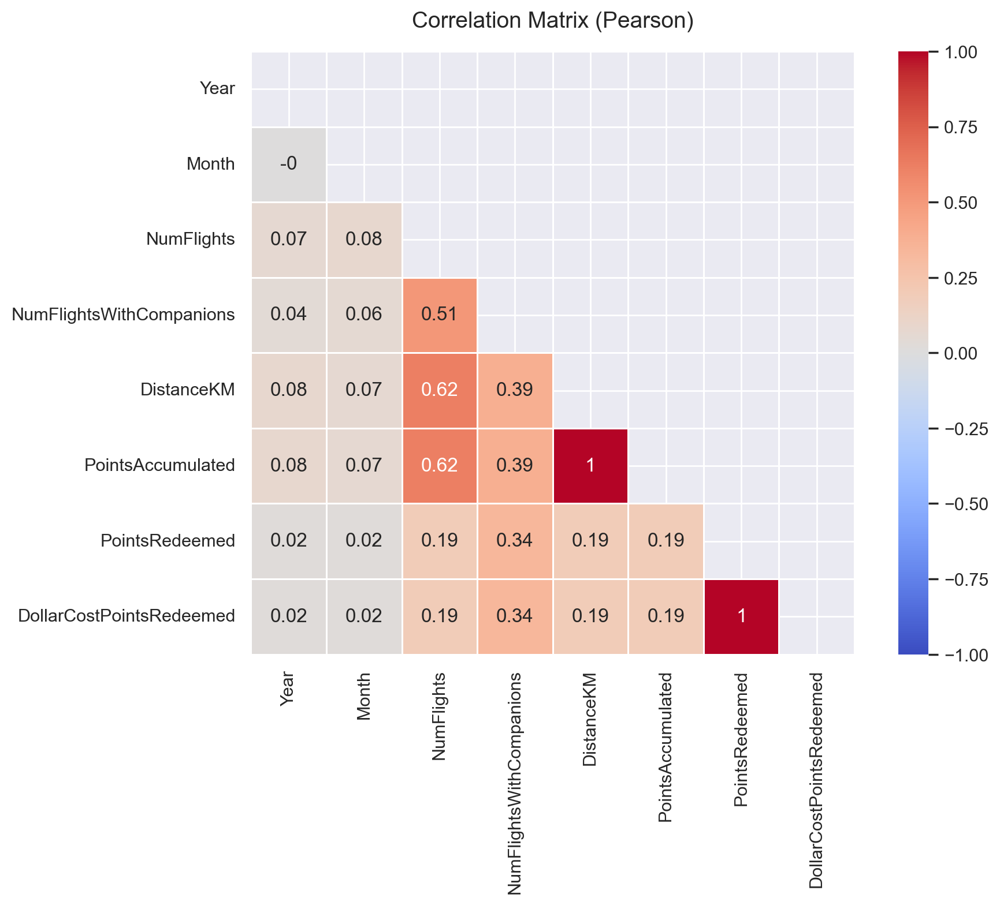

In [107]:
corr = new.corr(method="pearson"). round(2)

# Create a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Visualize correlation matrix
fig = plt.figure(figsize=(10, 8))

sns.heatmap(
    corr,
    mask=mask,                # hide upper triangle
    annot=True,               # show values
    cmap="coolwarm",          # divergent color map
    center=0,                 # center colormap in 0
    linewidths=0.5,           # lines between cells to help visualization
    vmin=-1, vmax=1,          # fix scale
    square=True               # make cells square-shaped
)


plt.title("Correlation Matrix (Pearson)", fontsize=14, pad=15)
plt.tight_layout() # improve layout by reducing overlaps
plt.show()


The correlation analysis between features provides a clearer understanding of their relationships. Some features are highly or perfectly correlated, suggesting that not all features may be necessary for subsequent analyses. In particular, PointsRedeemed and DollarCostPointsRedeemed, as well as DistanceKM and PointsAccumulated, show very strong correlations, indicating potential redundancy.

Still on this section we will examine the correlation between features using Spearman's rank correlation coefficient. Unlike Pearson correlation, Spearman correlation measures the strength and direction of a monotonic relationship between features, making it more robust to non-linear relationships and outliers. This approach allows us to better understand dependencies in the data, especially for features that may not follow a normal distribution.

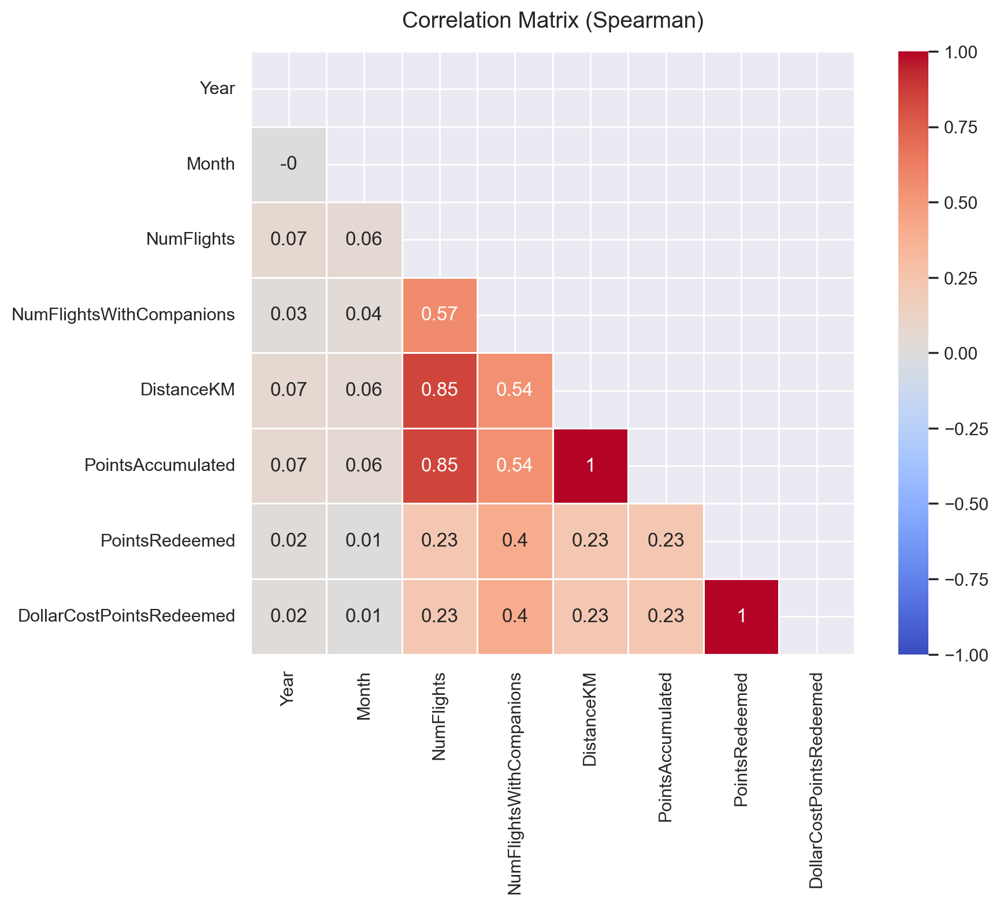

In [108]:
corr = new.corr(method="spearman"). round(2)

# Create a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Visualize correlation matrix
fig = plt.figure(figsize=(10, 8))

sns.heatmap(
    corr,
    mask=mask,                # hide upper triangle
    annot=True,               # show values
    cmap="coolwarm",          # divergent color map
    center=0,                 # center colormap in 0
    linewidths=0.5,           # lines between cells to help visualization
    vmin=-1, vmax=1,          # fix scale
    square=True               # make cells square-shaped
)


plt.title("Correlation Matrix (Spearman)", fontsize=14, pad=15)
plt.tight_layout() # improve layout by reducing overlaps
plt.show()


The conclusions from the Spearman correlation analysis are largely consistent with the previous correlation analysis.

<a class="anchor" id="5_2">

## **5.2** Customer Dataset

[Back to TOC](#toc)
</a>

<a class="anchor" id="5_2_1">

### **5.2.1** General Look at the Data (CustomerDB)

[Back to TOC](#toc)
</a>

In this section, we provide an initial overview of the CustomerDB dataset, examining its structure, and general characteristics to gain a better understanding of the customer information before deeper analysis.

In [109]:
customerDB.shape

(16921, 19)

In [110]:
customerDB.head(10)

,First Name,Last Name,Customer Name,Country,Province or State,City,Latitude,Longitude,Postal code,Gender,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType
Loyalty#,,,,,,,,,,,,,,,,,,,
480934,Cecilia,Householder,Cecilia Householder,Canada,Ontario,Toronto,43.653225,-79.383186,M2Z 4K1,female,Bachelor,Urban,70146.0,Married,Star,2/15/2019,NaN,3839.14,Standard
549612,Dayle,Menez,Dayle Menez,Canada,Alberta,Edmonton,53.544388,-113.490930,T3G 6Y6,male,College,Rural,0.0,Divorced,Star,3/9/2019,NaN,3839.61,Standard
429460,Necole,Hannon,Necole Hannon,Canada,British Columbia,Vancouver,49.282730,-123.120740,V6E 3D9,male,College,Urban,0.0,Single,Star,7/14/2017,1/8/2021,3839.75,Standard
608370,Queen,Hagee,Queen Hagee,Canada,Ontario,Toronto,43.653225,-79.383186,P1W 1K4,male,College,Suburban,0.0,Single,Star,2/17/2016,NaN,3839.75,Standard
530508,Claire,Latting,Claire Latting,Canada,Quebec,Hull,45.428730,-75.713364,J8Y 3Z5,male,Bachelor,Suburban,97832.0,Married,Star,10/25/2017,NaN,3842.79,2021 Promotion
193662,Leatrice,Hanlin,Leatrice Hanlin,Canada,Yukon,Whitehorse,60.721188,-135.056840,Y2K 6R0,male,Bachelor,Rural,26262.0,Married,Star,5/7/2015,NaN,3844.57,Standard
927943,Hue,Sellner,Hue Sellner,Canada,Ontario,Toronto,43.653225,-79.383186,P5S 6R4,female,College,Urban,0.0,Single,Star,6/9/2017,NaN,3857.95,Standard
188893,Nakia,Cash,Nakia Cash,Canada,Ontario,Trenton,44.101128,-77.576309,K8V 4B2,male,Bachelor,Suburban,93272.0,Married,Star,12/8/2019,NaN,3861.49,Standard
852392,Arlene,Conterras,Arlene Conterras,Canada,Quebec,Montreal,45.501690,-73.567253,H2Y 2W2,female,Bachelor,Suburban,93272.0,Married,Star,5/30/2018,NaN,3861.49,Standard


In [111]:
customerDB.tail(20)

,First Name,Last Name,Customer Name,Country,Province or State,City,Latitude,Longitude,Postal code,Gender,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType
Loyalty#,,,,,,,,,,,,,,,,,,,
999987,Layla,Murphy,Layla Murphy,Canada,New Brunswick,Fredericton,46.029263,-66.565150,R4H 2Y2,female,Bachelor,Urban,NaN,Single,Star,3/7/2017,3/7/2017,NaN,Standard
999988,Jana,Parker,Jana Parker,Canada,Quebec,Montreal,45.573672,-73.523012,N6B 1N3,male,College,Rural,NaN,Single,Star,8/22/2017,8/22/2017,NaN,Standard
999989,Ethan,Parker,Ethan Parker,Canada,Ontario,Trenton,44.075379,-77.550375,P8F 5C8,male,College,Rural,NaN,Married,Star,9/12/2015,9/12/2015,NaN,Standard
999990,Ryan,Anderson,Ryan Anderson,Canada,New Brunswick,Moncton,46.106617,-64.714267,B6P 6D0,female,College,Rural,NaN,Married,Star,6/10/2019,6/10/2019,NaN,Standard
999991,Olivia,Cote,Olivia Cote,Canada,New Brunswick,Fredericton,45.950000,-66.652437,X3W 5N2,female,College,Suburban,NaN,Married,Star,7/20/2019,7/20/2019,NaN,Standard
999992,Ella,Roy,Ella Roy,Canada,Ontario,Toronto,43.706878,-79.437412,P6D 6N2,male,College,Suburban,NaN,Single,Star,3/27/2021,3/27/2021,NaN,Standard
999993,Elijah,Cook,Elijah Cook,Canada,British Columbia,Dawson Creek,55.701475,-120.181716,W6H 0Z7,female,College,Suburban,NaN,Married,Star,1/27/2015,1/27/2015,NaN,Standard
999994,Ethan,Chan,Ethan Chan,Canada,Ontario,Ottawa,45.365906,-75.723181,B2F 3E1,female,College,Rural,NaN,Married,Star,5/5/2016,5/5/2016,NaN,Standard
999995,Liam,Wong,Liam Wong,Canada,Ontario,Ottawa,45.471557,-75.704868,B3A 2R0,female,College,Suburban,NaN,Married,Star,3/2/2020,3/2/2020,NaN,Standard


From the visualization of the head and tail of the data base we can already understand that some errors exist:

    - Missing values in some features
    - EnrollmentType as "2021 Promotion" when it's suppose to be a type
We will further analyse this using describe and info.

It's also possible to see that some features are redundante, such as Costumer Name, First Name and Last Name
To solve this problem we will uniformize all the values in data preparation.

<a class="anchor" id="5_2_2">

### **5.2.2** Data Quality Check (CustomerDB)

[Back to TOC](#toc)
</a>

In this section, we evaluate the quality of our datasets to ensure they are suitable for analysis. This includes checking for missing values, duplicates, and other potential data issues.

In [112]:
customerDB.info()

<class 'pandas.core.frame.DataFrame'>
Index: 16921 entries, 480934 to 100016
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   First Name               16921 non-null  object 
 1   Last Name                16921 non-null  object 
 2   Customer Name            16921 non-null  object 
 3   Country                  16921 non-null  object 
 4   Province or State        16921 non-null  object 
 5   City                     16921 non-null  object 
 6   Latitude                 16921 non-null  float64
 7   Longitude                16921 non-null  float64
 8   Postal code              16921 non-null  object 
 9   Gender                   16921 non-null  object 
 10  Education                16921 non-null  object 
 11  Location Code            16921 non-null  object 
 12  Income                   16901 non-null  float64
 13  Marital Status           16921 non-null  object 
 14  LoyaltyStatus        

From info we can see that:

    - missing values in Income, CustomerLifetimeValue, CancellationDate
* the missing values in the features Income can make sense in cases where customers do not want to share their personal annual income. Or they may also be input errors. (Depends on interpretation).

* We can also believe that it makes sense to have NaN values in “CancellationDate,” as this means that there are customers who have not left the program.

* For the “CustomerLifetimeValue” feature, we believe that it does not make sense to have NaN values because even if the customer has no value for the company, their CustomerLifetimeValue will be 0.

What will we do?

    Analyse with describe to have a different view

Before that we will better analyse the missing values using the function implemented before. 

The result showned that the Customer Dataset contains some missing values. The CancellationDate column has a large proportion of missing data (over 86%), likely because many customers have not cancelled. Income and Customer Lifetime Value have very few missing values, representing less than 0.2% of the dataset, which should have minimal impact on analysis.

In [113]:
check_missing(customerDB, "Customer Dataset")

Missing values in Customer Dataset:


,Missing Count,Missing %
Income,20,0.118196
CancellationDate,14611,86.348325
Customer Lifetime Value,20,0.118196


In [114]:
customerDB.describe()

,Latitude,Longitude,Income,Customer Lifetime Value
count,16921.000000,16921.000000,16901.000000,16901.000000
mean,47.174500,-91.814768,37758.038400,7990.460188
std,3.307971,22.242429,30368.992499,6863.173093
min,42.984924,-135.056840,0.000000,1898.010000
25%,44.231171,-120.237660,0.000000,3979.720000
50%,46.087818,-79.383186,34161.000000,5780.180000
75%,49.282730,-74.596184,62396.000000,8945.690000
max,60.721188,-52.712578,99981.000000,83325.380000


In [115]:
customerDB.describe(include='object').T

,count,unique,top,freq
First Name,16921,4941,Deon,13
Last Name,16921,15404,Salberg,4
Customer Name,16921,16921,Cecilia Householder,1
Country,16921,1,Canada,16921
Province or State,16921,11,Ontario,5468
City,16921,29,Toronto,3390
Postal code,16921,75,V6E 3D9,917
Gender,16921,2,female,8497
Education,16921,5,Bachelor,10586
Location Code,16921,3,Suburban,5716


From the numeric and categorical describe of CustomerDB, we can see that the dataset contains 16,921 customer records, all located in Canada. 
Income and Customer Lifetime Value (CLV) have substantial variability, and 20 missing values exist in both fields. Income also contains zeros, which may indicate unreported data rather than true zero earnings.

Most customers are still active, as indicated by the small number of recorded cancellations. The distribution of EnrollmentDateOpening shows clusters of identical dates, because out of 16,921 customer records, only 2,449 unique enrollment dates exist. This means many customers share the same enrollment date, suggesting promotional campaigns or cohort effects, rather than a uniform distribution of enrollments over time. 

Categorical features such as Education and EnrollmentType are heavily skewed, with the majority of customers having a Bachelor degree (10586 out of 16921 values) and a Standard enrollment type (15773 out of 1691 values). Similarly, City and PostalCode are concentrated in a few values, indicating that a small number of locations dominate the dataset.


<a class="anchor" id="5_2_3">

### **5.2.3** Deeper Analysis on CustomerDB dataset

[Back to TOC](#toc)
</a>

<p style="font-size:24px;">Unique</p>

This analysis of unique values gives a quick overview of the dataset, showing which features are diverse, nearly unique, or categorical with limited options.

After this analysis we can see that customer-level categorical features show reasonable diversity. First Name, Last Name, and Customer Name seemed nearly unique, as expected. Country has a single value (Canada), while Province/State, City, and Postal Code have distinct values. 

Categorical feature such as Gender, Education, Location Code, Marital Status, LoyaltyStatus, and EnrollmentType have a limited set of distinct values. Date related vfeature such as EnrollmentDateOpening, CancellationDate and continuous feature Income and Customer Lifetime Value contain many unique values and some missing values or close to zero values, reflecting varied customer activity, enrollment over time and maybe some erros.

The unique values analysis highlights featurediversity and potential data issues, providing a foundation for further exploration and cleaning.

In [116]:
for column in customerDB.columns:
    unique_values = customerDB[column].unique()
    print(f"Unique values on the column '{column}': {unique_values}")
    print('-----------------------------------')
    print('')

Unique values on the column 'First Name': ['Cecilia' 'Dayle' 'Necole' ... 'Juliann' 'Olivia' 'Liam']
-----------------------------------

Unique values on the column 'Last Name': ['Householder' 'Menez' 'Hannon' ... 'Bennett' 'Wilson' 'Martin']
-----------------------------------

Unique values on the column 'Customer Name': ['Cecilia Householder' 'Dayle Menez' 'Necole Hannon' ... 'Amelia Bennett'
 'Benjamin Wilson' 'Emma Martin']
-----------------------------------

Unique values on the column 'Country': ['Canada']
-----------------------------------

Unique values on the column 'Province or State': ['Ontario' 'Alberta' 'British Columbia' 'Quebec' 'Yukon' 'New Brunswick'
 'Manitoba' 'Nova Scotia' 'Saskatchewan' 'Newfoundland'
 'Prince Edward Island']
-----------------------------------

Unique values on the column 'City': ['Toronto' 'Edmonton' 'Vancouver' 'Hull' 'Whitehorse' 'Trenton' 'Montreal'
 'Dawson Creek' 'Quebec City' 'Moncton' 'Fredericton' 'Ottawa' 'Tremblant'
 'Calgary' 'Whis

<p style="font-size:24px;">Values Count</p>

This analysis will show us the distribution of values across the dataset. 

All customers have unique Customer Name entries, and first/last names are rare, with a few recurring more frequently. All customers are in Canada, with the highest concentration in Ontario, British Columbia, and Quebec. Cities such as Toronto, Vancouver, and Montreal dominate the dataset, while many smaller cities have much fewer records.
Categorical feature show clear prevalence. Gender is almost balanced, Education is dominated by Bachelor degrees, Location Code is fairly even across Suburban, Rural, and Urban, Marital Status is mainly Married, LoyaltyStatus is mostly Star nad EnrollmentType is overwhelmingly Standard.

Continuous and date-related feature (Income, Customer Lifetime Value, EnrollmentDateOpening, CancellationDate) exhibit a wide range of values, with some repeated peaks indicating common enrollment dates, cancellation dates, or popular income levels. 

Overall, the value counts highlight which categories and values are most frequent, giving a sense of concentration versus diversity in the dataset.

In [117]:
for column in customerDB.columns:
    count_values = customerDB[column].value_counts()
    print(f"The number of the distinct values in the column '{column}' is: {count_values}")
    print('-----------------------------------')
    print('')

The number of the distinct values in the column 'First Name' is: First Name
Deon          13
Stacey        13
Merrill       12
Rudy          12
Loren         12
              ..
Eldora         1
Kristopher     1
Violette       1
Rosanna        1
Liam           1
Name: count, Length: 4941, dtype: int64
-----------------------------------

The number of the distinct values in the column 'Last Name' is: Last Name
Salberg      4
Ypina        4
Amodei       3
Mesteth      3
Sather       3
            ..
Melick       1
Dagel        1
Pynes        1
Mcclaskey    1
Martin       1
Name: count, Length: 15404, dtype: int64
-----------------------------------

The number of the distinct values in the column 'Customer Name' is: Customer Name
Cecilia Householder    1
Agnes Beary            1
Larry Floss            1
Rosaline Goud          1
Lola Mamon             1
                      ..
Aiko Beaubien          1
Annalisa Kara          1
Hana Stibb             1
Allegra Lounder        1
Emma Martin

<p style="font-size:24px;">Check Duplicates</p>

In [118]:
customerDB.duplicated().sum()

np.int64(0)

Checking the duplicates we verify that we don´t have any.

But it's still important to check the duplicates without the names features.

In [119]:
customerDB_no_name = customerDB.drop(columns=["First Name", "Last Name", "Customer Name"])
customerDB_no_name.duplicated().sum()

np.int64(0)

The result is the same so we can conclude that there aren't duplicated values in this DataFrame.

Contrary to what we have seen with the Flights dataset, here is not important to consider the values of Loyalty# as a feature. Still, so we can be consistint when analysing our datasets, we will had this column as a feature also to this dataset.

In [120]:
customerDB = pd.read_csv('data/DM_AIAI_CustomerDB.csv', sep = ",")
# code that we also did in the begining because there's a column with the index numbers that is completely unuseful
customerDB = customerDB.iloc[:, 1:] 

# to verify that the Loyalty# is now a feature and not an index anymore
customerDB.head()

,Loyalty#,First Name,Last Name,Customer Name,Country,Province or State,City,Latitude,Longitude,Postal code,Gender,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType
0,480934,Cecilia,Householder,Cecilia Householder,Canada,Ontario,Toronto,43.653225,-79.383186,M2Z 4K1,female,Bachelor,Urban,70146.0,Married,Star,2/15/2019,NaN,3839.14,Standard
1,549612,Dayle,Menez,Dayle Menez,Canada,Alberta,Edmonton,53.544388,-113.490930,T3G 6Y6,male,College,Rural,0.0,Divorced,Star,3/9/2019,NaN,3839.61,Standard
2,429460,Necole,Hannon,Necole Hannon,Canada,British Columbia,Vancouver,49.282730,-123.120740,V6E 3D9,male,College,Urban,0.0,Single,Star,7/14/2017,1/8/2021,3839.75,Standard
3,608370,Queen,Hagee,Queen Hagee,Canada,Ontario,Toronto,43.653225,-79.383186,P1W 1K4,male,College,Suburban,0.0,Single,Star,2/17/2016,NaN,3839.75,Standard
4,530508,Claire,Latting,Claire Latting,Canada,Quebec,Hull,45.428730,-75.713364,J8Y 3Z5,male,Bachelor,Suburban,97832.0,Married,Star,10/25/2017,NaN,3842.79,2021 Promotion


<p style="font-size:24px;">Correlation between feature</p>

In this section, we examine the relationships between numerical feature using a correlation matrix. This allows us to identify strong associations, potential redundancies, and patterns that may inform further analysis or feature selection.

As before this correlation is also an important analysis to be done. However this doesn't make sense for all feature so we create a new DataFrame with only the vfeature we want to use to check the correlation.

In [121]:
# create a copy of the customerDB and select only the relevant columns for correlation analysis
new = customerDB.copy()
new = new[["Latitude", "Longitude", "Income", "Customer Lifetime Value", "EnrollmentDateOpening", "CancellationDate"]]

# converting date columns to datetime format
new['EnrollmentDateOpening'] = pd.to_datetime(new['EnrollmentDateOpening'], format='%m/%d/%Y', errors='coerce')
new['CancellationDate'] = pd.to_datetime(new['CancellationDate'], format='%m/%d/%Y', errors='coerce')

# using the two date columns converted before to create a new column with the customer duration in days
new['CustomerDurationDays'] = (new['CancellationDate'] - new['EnrollmentDateOpening']).dt.days

# choose the numerical columns for correlation analysis
cols = ["Latitude", "Longitude", "Income", "Customer Lifetime Value", "CustomerDurationDays"]
new[cols].corr(method='pearson')

,Latitude,Longitude,Income,Customer Lifetime Value,CustomerDurationDays
Latitude,1.000000,-0.764840,-0.002009,-0.002207,-0.015645
Longitude,-0.764840,1.000000,0.002928,0.006218,0.011865
Income,-0.002009,0.002928,1.000000,0.024026,-0.016729
Customer Lifetime Value,-0.002207,0.006218,0.024026,1.000000,-0.035992
CustomerDurationDays,-0.015645,0.011865,-0.016729,-0.035992,1.000000


From the code before it's difficult to get conclusions. We will visualize this matrix in a easy way of getting conclusions.

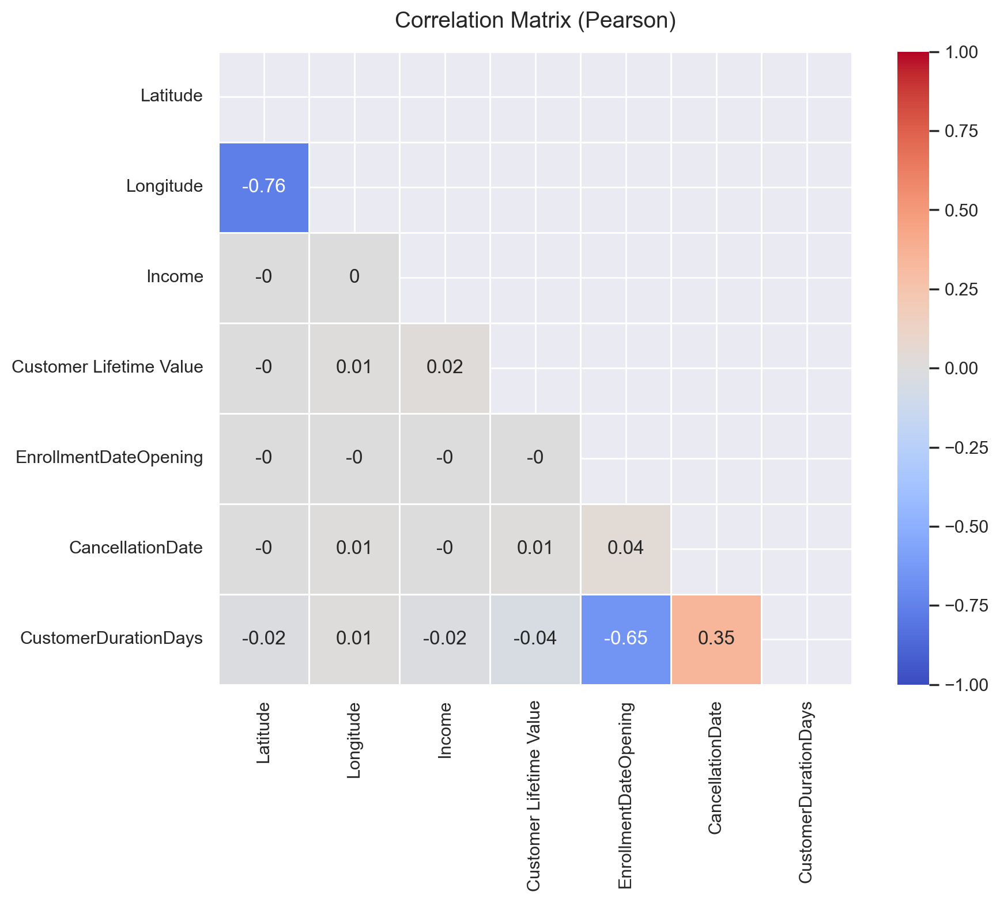

In [122]:
corr = new.corr(method="pearson"). round(2)

# Create a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Visualize correlation matrix
fig = plt.figure(figsize=(10, 8))

sns.heatmap(
    corr,
    mask=mask,                # hide upper triangle
    annot=True,               # show values
    cmap="coolwarm",          # divergent color map
    center=0,                 # center colormap in 0
    linewidths=0.5,           # lines between cells to help visualization
    vmin=-1, vmax=1,          # fix scale
    square=True               # make cells square-shaped
)


plt.title("Correlation Matrix (Pearson)", fontsize=14, pad=15)
plt.tight_layout() # improve layout by reducing overlaps
plt.show()


The correlation analysis between feature is now much easier to interpret. We can see that EnrollmentDateOpening and CustomerDurationDays are correlated; however, this correlation is not strong enough to justify dropping either vfeature Similarly, Latitude and Longitude show a higher correlation, but it is still not sufficient to remove one of them from the dataset.


Still on this section and in the same way that we did for the FlightsDB dataset we will examine the correlation between feature using Spearman's rank correlation coefficient.

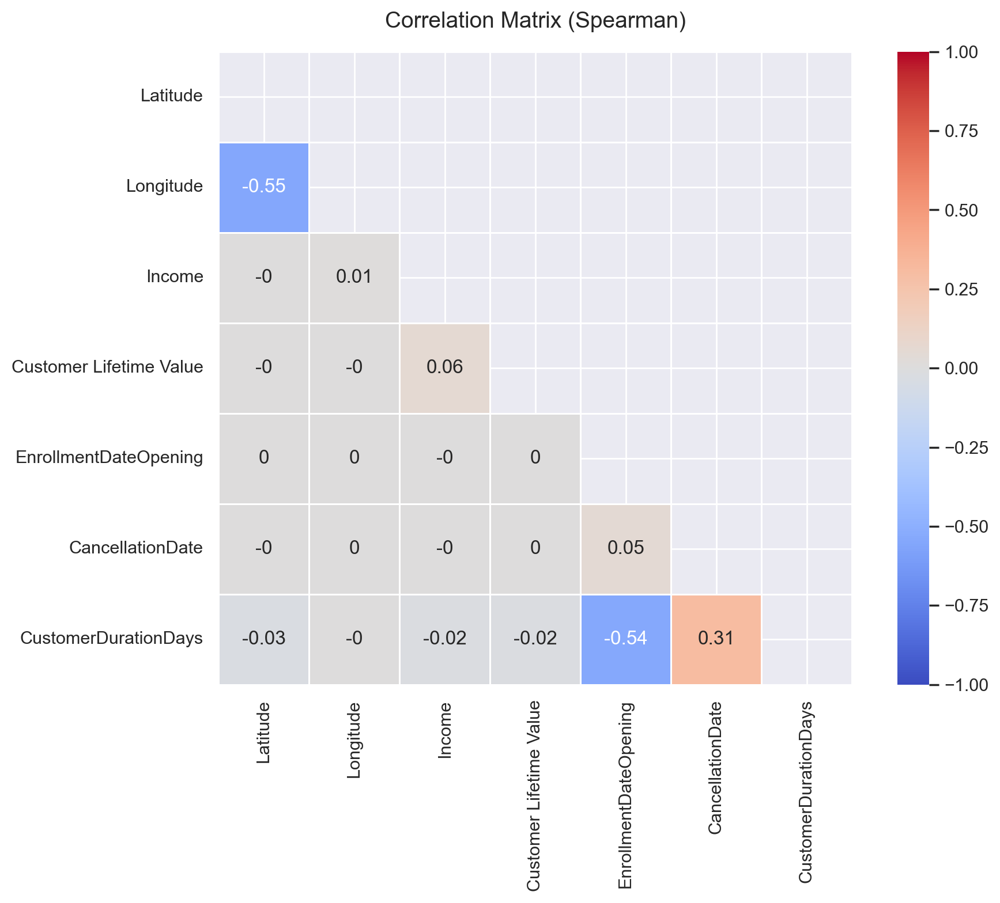

In [123]:
corr = new.corr(method="spearman").round(2)

# Create a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Visualize correlation matrix
fig = plt.figure(figsize=(10, 8))

sns.heatmap(
    corr,
    mask=mask,                # hide upper triangle
    annot=True,               # show values
    cmap="coolwarm",          # divergent color map
    center=0,                 # center colormap in 0
    linewidths=0.5,           # lines between cells to help visualization
    vmin=-1, vmax=1,          # fix scale
    square=True               # make cells square-shaped
)


plt.title("Correlation Matrix (Spearman)", fontsize=14, pad=15)
plt.tight_layout() # improve layout by reducing overlaps
plt.show()

The conclusions from the Spearman correlation analysis are largely consistent with the previous correlation analysis.

<a class="anchor" id="6">

# **6. Descriptive Statistics and Visualisations**

[Back to TOC](#toc)
</a>

In this section, we will redefine the feature, this time without using the index as the DataFrame index.
This adjustment is necessary because, for the graphical visualizations, having the previous index can cause confusion with duplicated values, making the plots harder to interpret correctly.

In [124]:
flightsDB = pd.read_csv('data/DM_AIAI_FlightsDB.csv', sep = ",")
customerDB = pd.read_csv('data/DM_AIAI_CustomerDB.csv', sep = ",")

Remove the 'Unnamed' column referring to a sequential numbering of the rows, as we set the column "Loyalty#" as the index

In [125]:
customerDB = customerDB.iloc[:, 1:]
customerDB

,Loyalty#,First Name,Last Name,Customer Name,Country,Province or State,City,Latitude,Longitude,Postal code,Gender,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType
0,480934,Cecilia,Householder,Cecilia Householder,Canada,Ontario,Toronto,43.653225,-79.383186,M2Z 4K1,female,Bachelor,Urban,70146.0,Married,Star,2/15/2019,NaN,3839.14,Standard
1,549612,Dayle,Menez,Dayle Menez,Canada,Alberta,Edmonton,53.544388,-113.490930,T3G 6Y6,male,College,Rural,0.0,Divorced,Star,3/9/2019,NaN,3839.61,Standard
2,429460,Necole,Hannon,Necole Hannon,Canada,British Columbia,Vancouver,49.282730,-123.120740,V6E 3D9,male,College,Urban,0.0,Single,Star,7/14/2017,1/8/2021,3839.75,Standard
3,608370,Queen,Hagee,Queen Hagee,Canada,Ontario,Toronto,43.653225,-79.383186,P1W 1K4,male,College,Suburban,0.0,Single,Star,2/17/2016,NaN,3839.75,Standard
4,530508,Claire,Latting,Claire Latting,Canada,Quebec,Hull,45.428730,-75.713364,J8Y 3Z5,male,Bachelor,Suburban,97832.0,Married,Star,10/25/2017,NaN,3842.79,2021 Promotion
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16916,100012,Ethan,Thompson,Ethan Thompson,Canada,Quebec,Quebec City,46.759733,-71.141009,Y0C 7D6,male,Bachelor,Suburban,NaN,Single,Star,2/27/2019,2/27/2019,NaN,Standard
16917,100013,Layla,Young,Layla Young,Canada,Alberta,Edmonton,53.524829,-113.546357,L3S 9Y3,female,Bachelor,Rural,NaN,Married,Star,9/20/2017,9/20/2017,NaN,Standard
16918,100014,Amelia,Bennett,Amelia Bennett,Canada,New Brunswick,Moncton,46.051866,-64.825428,G2S 2B6,male,Bachelor,Rural,NaN,Married,Star,11/28/2020,11/28/2020,NaN,Standard
16919,100015,Benjamin,Wilson,Benjamin Wilson,Canada,Quebec,Quebec City,46.862970,-71.133444,B1Z 8T3,female,College,Urban,NaN,Married,Star,4/9/2020,4/9/2020,NaN,Standard


<a class="anchor" id="6_1">

## **6.1.** FlightsDB

[Back to TOC](#toc)
</a>

This section begins by splitting the features in groups according to their type to ensure that the most appropriate statistical methods and plots were applied.
Through this structured approach, we uncover patterns related to flight frequency, distances, and spending behavior.
These insights provide an initial understanding of travel habits and operational trends, forming a foundation for subsequent behavioral and value-based segmentation.

In [126]:
non_metric_features_FDB = ["YearMonthDate"]
metric_features_FDB = flightsDB.columns.drop(non_metric_features_FDB).to_list()
continuous_features_FDB = ["DistanceKM", "PointsAccumulated", "PointsRedeemed", "DollarCostPointsRedeemed"]

data = list(zip_longest(
    metric_features_FDB,
    non_metric_features_FDB,
    continuous_features_FDB,
    fillvalue=""
))

headers = [
    "Metric Features",
    "Non-Metric Features",
    "Continuous Features",
]

print(tabulate(data, headers=headers, tablefmt="github"))

| Metric Features          | Non-Metric Features   | Continuous Features      |
|--------------------------|-----------------------|--------------------------|
| Loyalty#                 | YearMonthDate         | DistanceKM               |
| Year                     |                       | PointsAccumulated        |
| Month                    |                       | PointsRedeemed           |
| NumFlights               |                       | DollarCostPointsRedeemed |
| NumFlightsWithCompanions |                       |                          |
| DistanceKM               |                       |                          |
| PointsAccumulated        |                       |                          |
| PointsRedeemed           |                       |                          |
| DollarCostPointsRedeemed |                       |                          |


<a class="anchor" id="6_1_1">

### **6.1.1.** Metric Features Visualizations

[Back to TOC](#toc)
</a>

<p style="font-size:24px;">Histograms</p>

Now we analyze the distribution of several flight-related feature using histograms. This approach allows us to observe the overall shape, central tendency, and spread of each vfeature We also complement the histogram with a smoothing line to better reveal the underlying distribution, minimizing binning bias. 

It is important to note that some of these feature, particularly those representing the number of flights, are stored as float values instead of integers. This issue was already identified during the exploratory data analysis (EDA) and clearly represents a data quality inconsistency, since the number of flights should always be a discrete integer vfeature

Nevertheless, these feature were intentionally included in the histograms to illustrate how the data behave when treated as continuous. This choice helps visualize the overall distribution and highlight the underlying data quality issue, emphasizing the importance of proper data typing before any clustering or segmentation work.

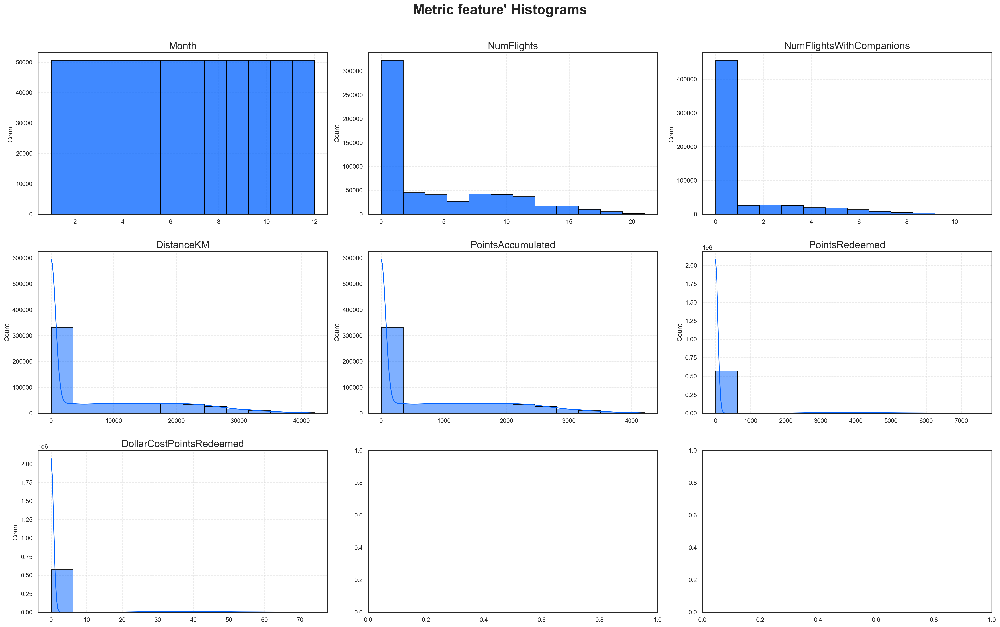

In [127]:
# Set number of rows and columns
sp_rows_FDB = 3
sp_cols_FDB = ceil(len(metric_features_FDB[2:]) / sp_rows_FDB)

# Set style
sns.set_style("white") # increase contrast

# Create figure
fig, axes = plt.subplots(sp_rows_FDB,
                         sp_cols_FDB,
                         figsize=(25, 15),
                         constrained_layout=True)

# Additional spacing between rows
fig.set_constrained_layout_pads(h_pad=.2)

# Plot data
for ax, feat in zip(axes.flatten(), metric_features_FDB[2:]): # "[2:]" to skip Year and Month features
    
    sns.histplot(flightsDB[feat],
                 bins=12,
                 kde=(feat in continuous_features_FDB), #smooth line only for continuous feature
                 ax=ax,
                 color="#0062FF",
                 edgecolor="black")
    
    ax.set_title(feat, fontsize=18)
    ax.grid(True, linestyle="--", alpha=0.4)
    ax.set_xlabel("")

# Global title
plt.suptitle("Metric feature' Histograms",
             fontsize=25,
             fontweight="bold",
             y=1.05)

# Save figure
os.makedirs(os.path.join('..', 'figures', 'eda'), exist_ok=True)
fig.savefig(os.path.join('..', 'figures', 'eda', 'numeric_feature_histograms.png'),
            dpi=200)

# display output
plt.show()


From the histograms above we can see that:

- `Number of Flights and Flights with Companions:` Most customers make few trips (1 to 3 flights). Few customers travel frequently—they are the outliers. As said before it's possible to visualize that are some number of flights as floats what doens't make sense;
- `Distance KM:` Most flights are short-haul. There are some long-haul flights that can represent the outliers;
- `Points Accumulated:` Only a small percentage of customers accumulate many points;
- `Points Redeemed:` Almost all customers do not redeem points or redeem very few;
- `Dollar Cost Points Redeemed:` As expected, this has the same behaviour as 'Points Redeemed' because it's just the equivalent in dollars.

<p style="font-size:24px;">Boxplots</p>

This subsection presents boxplots for the continuous feature, including those representing the number of flights.
Although, as previously discussed, the flight count feature are incorrectly stored as float values instead of integers, they were intentionally kept in this analysis. The goal is to examine the presence of outliers and assess the overall dispersion of these features.
Boxplots provide an effective way to detect extreme values, which can be particularly relevant for understanding unusual travel patterns or data recording errors that may affect the later process.

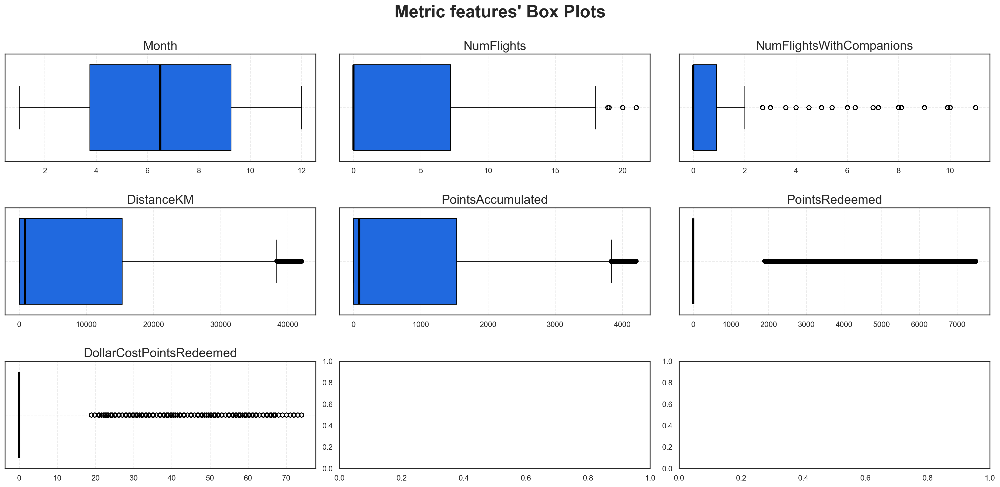

In [128]:
# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(sp_rows_FDB, 
                         sp_cols_FDB, 
                         figsize=(20, 10),
                         constrained_layout=True) # Adjust automatically spacing between subplot and labels 

# Increase vertical space between rows
fig.set_constrained_layout_pads(h_pad=.2)

# Plot data
# Iterate across axes objects and associate each box plot:
for ax, feat in zip(axes.flatten(), metric_features_FDB[2:]): # "[2:]" to skip Year and Month features
    sns.boxplot(x=flightsDB[feat], ax=ax,
                # Set inside color to blue
                color="#0062FF",
                # Set line colors to black
                boxprops=dict(edgecolor="black"),
                whiskerprops=dict(color="black"),
                capprops=dict(color="black"),
                medianprops=dict(color="black", linewidth=3),
                flierprops=dict(markeredgecolor="black"))
    
    # Put grid with low opacity and dashed line so it's visible, but not distracting
    ax.grid(True, linestyle="--", alpha=0.4)

    # Put title of each graph with bigger font
    ax.set_title(feat, fontsize=18)

    # Hide x label since we already have the boxlplot title at the top
    ax.set_xlabel("")
    
# Layout
# Add title and make it bigger
plt.suptitle("Metric features' Box Plots", 
             fontsize = 25, fontweight="bold")

# Create the folder '../figures/eda' if it doesn't already exist
os.makedirs(os.path.join('..', 'figures', 'eda'), exist_ok=True)

# Save figure to a png file in the folder created before
plt.savefig(os.path.join('..', 'figures', 'eda', 'numeric_features_boxplots.png'), dpi=200)

# Show plot
plt.show()

From the boxplots above we can conclude that:

- `Number of Flights:` Low median and strong skew to the right (positive asymmetry). Many outliers above ~15 flights — few customers travel frequently;
- `Number of Flights with Companions:` Median close to 0 and some outliers that represent the clients that travel in big groups;
- `Distance KM:` large number of short flights and a few very long ones that greatly influence the average;
- `Points Accumulated:` Very low median and a lot of outliers. This means that only a few customers accumulate large volumes of points;
-`Points Redeemed:` The same as before, a very big majority of values are low with a big number of outliers;
- `Dollar Cost Points Redeemed and Points Redeemed:` A very similar distribution to 'Points Redeemed' as expected, with the majority of values being close to 0 and many outliers.

<a class="anchor" id="6_1_2">

### **6.1.2.** Relationship between Metric Features

[Back to TOC](#toc)
</a>

<p style="font-size:24px;">Scatterplots</p>

Are used to visualize the relationships between numerical features in the dataset. These plots display individual data points along two axes, allowing us to observe patterns such as correlations, clusters, and outliers. Through this visualization, we can better understand how different factors, such as flight frequency, distance traveled, and loyalty points relate to each other. The scatterplots provide valuable insights into customer behavior, highlighting potential trends and dependencies between feature.

<p style="font-size:24px;">Initial Scatterplot</p>

We start by performing a general and straightforward analysis of several relationships between features that could potentially be significant. Based on the results of this initial exploration, we then focus on examining in greater detail the relationships that appear to be the most informative or meaningful for further analysis.

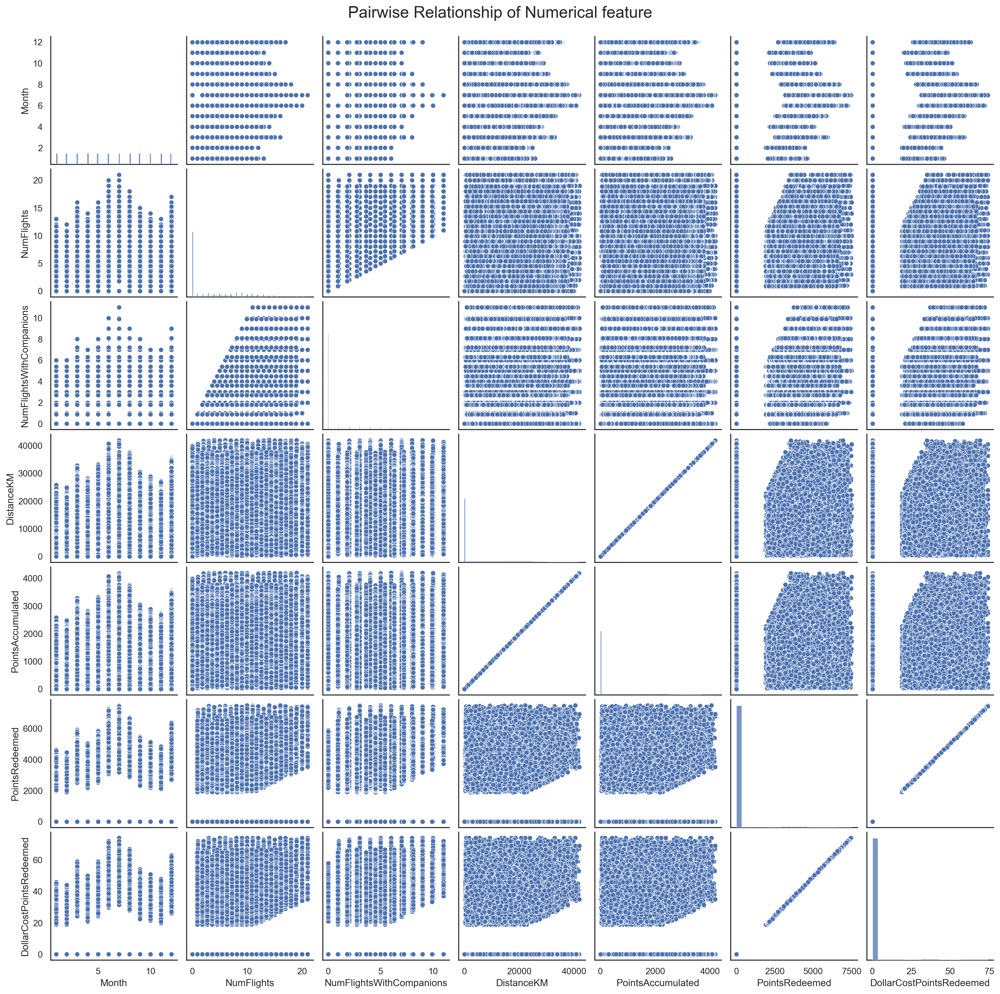

In [129]:
sns.pairplot(flightsDB[metric_features_FDB[2:]], diag_kind="hist") # "[2:]" to skip Year and Month features

plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical feature", fontsize=20)
plt.show()

These plots provided an overview of general trends, distributions, and potential correlations. From this initial exploration, certain relationships appear to be more meaningful and warrant deeper investigation. Specifically, we will focus on some scatterplots that show patterns that could reveal significant insights into customer behavior and the relationship between flight activity, loyalty points, and redemption value.

<p style="font-size:24px;">NumFlights vs NumFlightsWithCompanions</p>

This analysis explores the relationship between the total number of flights taken and the number of flights taken with companions. Understanding this connection may reveal behavioral patterns in group travel and customer loyalty dynamics.

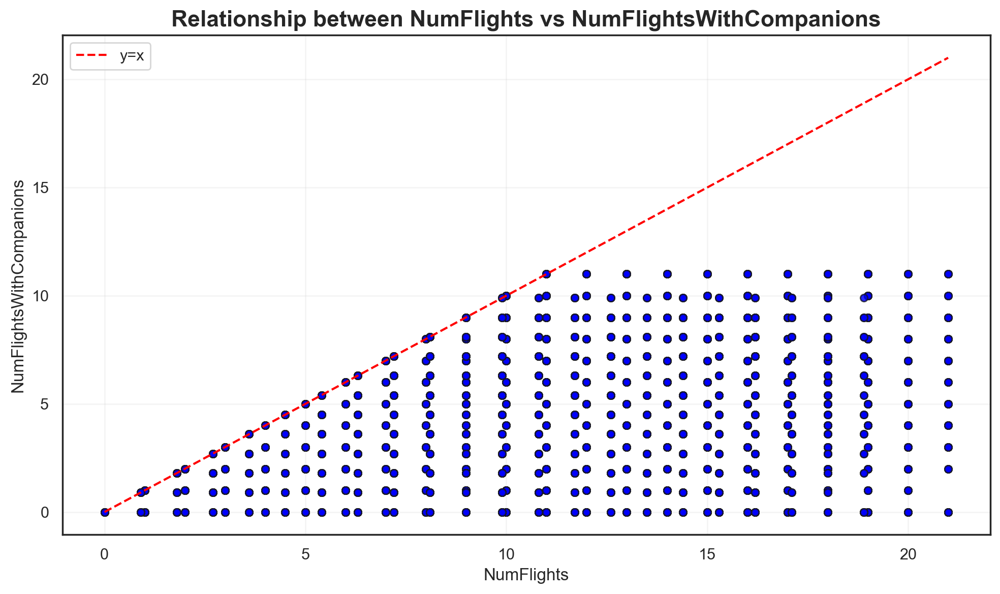

In [130]:
x = flightsDB["NumFlights"]
y = flightsDB["NumFlightsWithCompanions"]

plt.figure(figsize=(10, 6))
plt.scatter(x, y, s=25, alpha=0.3, c='blue', edgecolor='k')
plt.plot([0, x.max()], [0, x.max()], color='red', linestyle='--', label='y=x')
plt.title("Relationship between NumFlights vs NumFlightsWithCompanions", fontsize=16, fontweight='bold')
plt.xlabel("NumFlights")
plt.ylabel("NumFlightsWithCompanions")
plt.legend()
plt.grid(True, alpha=0.2)
plt.tight_layout()
plt.show()


The analysis shows a positive relationship between the features analysed. Passengers who fly more frequently also tend to travel more often with others, suggesting that regular travelers might belong to customer segments such as families or business groups. This insight could be useful for targeted marketing or loyalty program strategies focused on group travel.

<p style="font-size:24px;">DistanceKM and PointsAccumulated</p>

Here, the goal is to examine how the distance traveled influences the accumulation of loyalty points. This relationship can indicate whether longer trips directly contribute to higher reward earnings and program engagement.

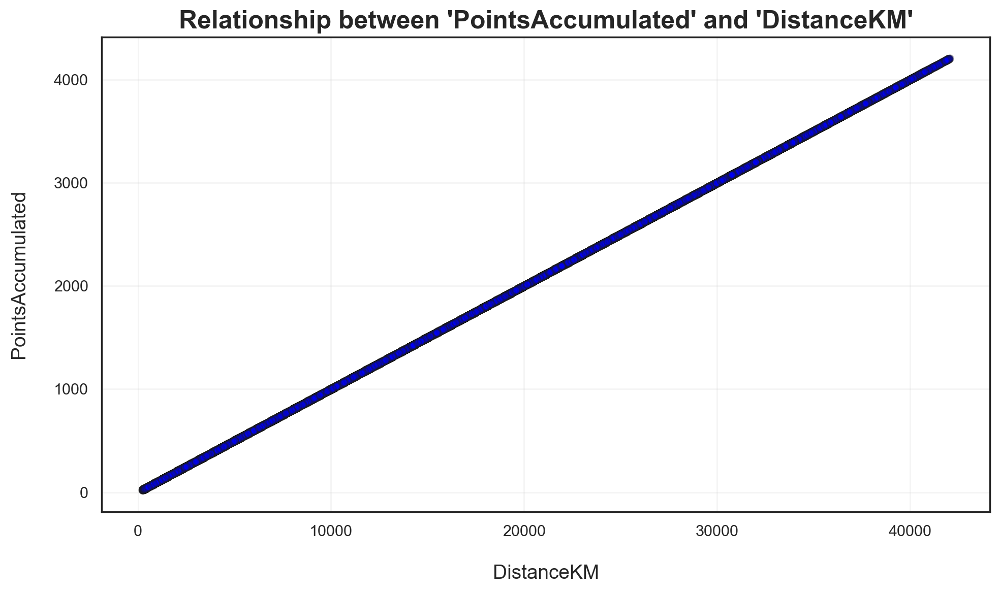

In [131]:
mask = ((flightsDB["DistanceKM"] > 0) &
        (flightsDB["PointsAccumulated"] > 0))

distance_clean = flightsDB.loc[mask, "DistanceKM"]
points_acc = flightsDB.loc[mask, "PointsAccumulated"]

# Scatter plot
plt.figure(figsize=(10, 6))
sns.set_style("white")
plt.scatter(distance_clean, points_acc, s=25, alpha=0.3, c='blue', edgecolor='k')

# The line below is commented out because it's not required once the scatter plot created has a completly linear trend.

# Fit a linear trend line
# coeffs = np.polyfit(distance_clean, points_acc, 1)
# trend = np.poly1d(coeffs)
# x = np.linspace(distance_clean.min(), distance_clean.max(), 100)
# plt.plot(x, trend(x), color='red', linewidth=2)  # Line

plt.title("Relationship between 'PointsAccumulated' and 'DistanceKM'", fontsize=18, fontweight='bold')
plt.xlabel("DistanceKM", fontsize=14, labelpad=18)
plt.ylabel("PointsAccumulated", fontsize=14, labelpad=18)
plt.grid(True, alpha=0.2)
plt.tight_layout()
plt.show()


A strong linear relationship was observed between distance traveled and points accumulated, indicating that the loyalty program rewards longer flights consistently. This predictable correlation confirms that distance is a key driver of point accumulation, and it may serve as a reliable metric for understanding customer engagement through mileage.

<p style="font-size:24px;">PointsAccumulated vs PointsRedeemed</p>

This section investigates the balance between points earned and points redeemed. Analyzing this relationship helps assess customer redemption behavior and the effectiveness of the loyalty program.

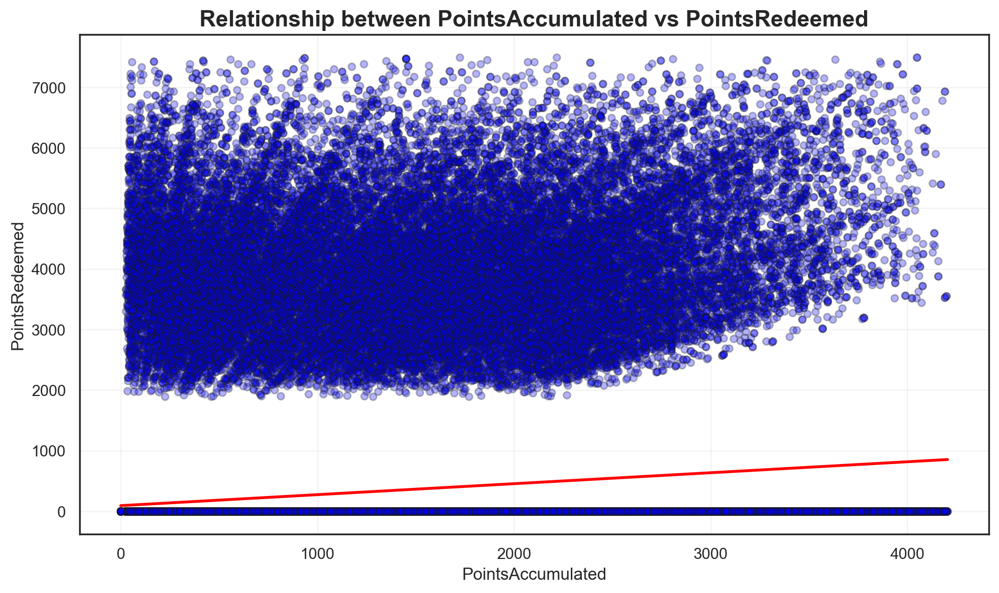

In [132]:
x = flightsDB["PointsAccumulated"]
y = flightsDB["PointsRedeemed"]

plt.figure(figsize=(10, 6))
plt.scatter(x, y, s=25, alpha=0.3, c='blue', edgecolor='k')

# Linear trend
coeffs = np.polyfit(x, y, 1)
trend = np.poly1d(coeffs)
x_vals = np.linspace(x.min(), x.max(), 100)
plt.plot(x_vals, trend(x_vals), color='red', linewidth=2)

plt.title("Relationship between PointsAccumulated vs PointsRedeemed", fontsize=16, fontweight='bold')
plt.xlabel("PointsAccumulated")
plt.ylabel("PointsRedeemed")
plt.grid(True, alpha=0.2)
plt.tight_layout()
plt.show()


The scatterplot suggests that while many customers accumulate points, a significant portion do not redeem them frequently. There is a general upward trend, but with notable dispersion, especially at lower redemption levels. This may indicate varying engagement levels or potential barriers to redemption, providing an opportunity to enhance program usability and encourage point utilization.

<p style="font-size:24px;">PointsRedeemed vs DollarCostPointsRedeemed</p>

In this part, the focus is on understanding the correlation between the number of points redeemed and their equivalent dollar value. This can provide insights into the real-world value of points and the efficiency of the redemption system.

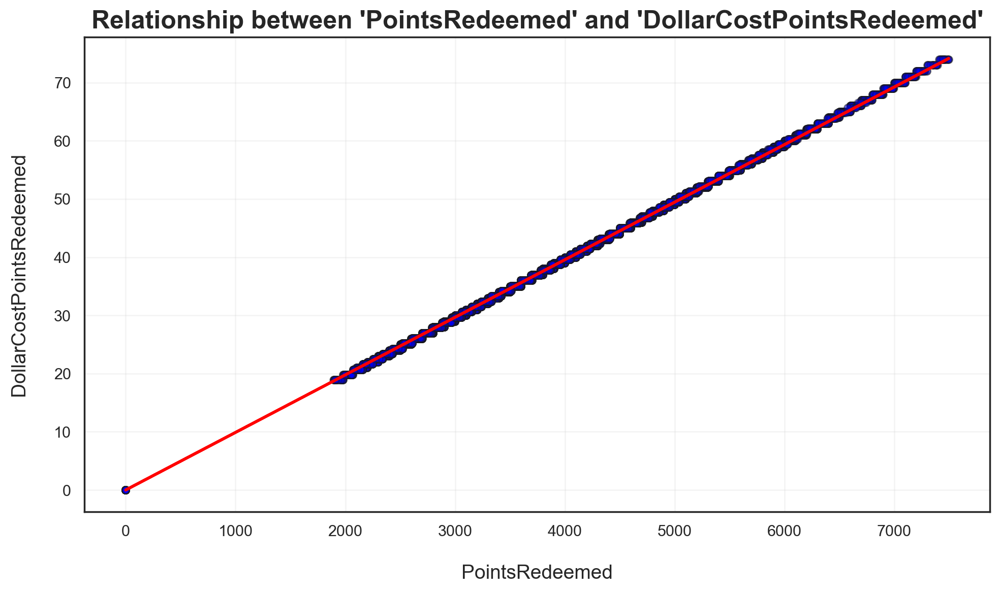

In [133]:
x = flightsDB["PointsRedeemed"]
y = flightsDB["DollarCostPointsRedeemed"]

# Scatter plot as before
plt.figure(figsize=(10, 6))
sns.set_style("white")
plt.scatter(x, y, s=25, alpha=0.3, c='blue', edgecolor='k')

# Fit a linear trend line
coeffs = np.polyfit(x, y, 1)
trend = np.poly1d(coeffs)
plt.plot(x, trend(x), color='red', linewidth=2)  # Line

plt.title("Relationship between 'PointsRedeemed' and 'DollarCostPointsRedeemed'", fontsize=18, fontweight='bold')
plt.xlabel("PointsRedeemed", fontsize=14, labelpad=18)
plt.ylabel("DollarCostPointsRedeemed", fontsize=14, labelpad=18)
plt.grid(True, alpha=0.2)
plt.tight_layout()
plt.show()


This relationship appears highly linear, showing that the dollar value increases proportionally with the number of points redeemed. This consistency suggests that the loyalty program maintains a stable and transparent conversion rate between points and monetary value, reinforcing customer trust in the redemption process.

<p style="font-size:24px;">Hexbin Plots</p>

Hexbin plots will be used as a complementary visualization technique. These plots provide a clearer view of data density and distribution, helping to identify areas of concentration and potential patterns that are less visible in traditional scatterplots.

Before show the next plot, several hexbin plots were generated to explore the relationships between numerical features in the dataset. However, most of the resulting visualizations were not suitable for meaningful analysis, as the plots appeared uniformly colored, indicating highly unbalanced data distributions and extreme value ranges. These characteristics caused the density representation to collapse, making it difficult to distinguish patterns or trends.
For this reason, only the final hexbin plot was retained for analysis, as it provided at least some visible variation and offered limited but interpretable insights.

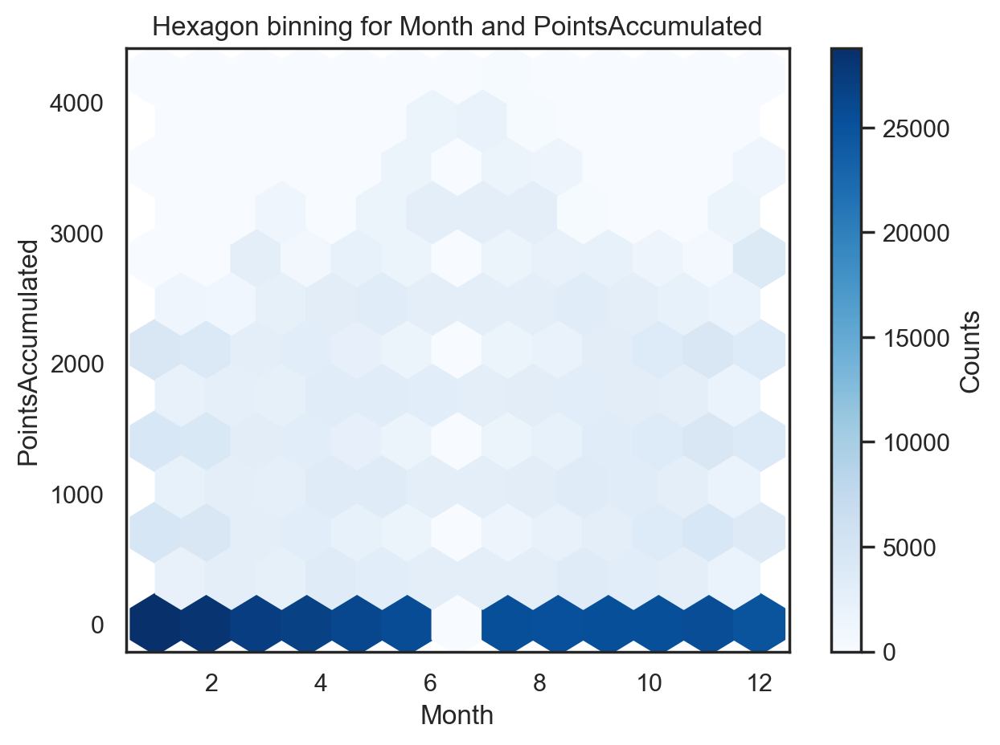

In [134]:
# Month vs PointsAccumulated
plt.hexbin(flightsDB["Month"], flightsDB["PointsAccumulated"], gridsize=12, cmap="Blues")
plt.title("Hexagon binning for Month and PointsAccumulated")
plt.xlabel("Month")
plt.ylabel("PointsAccumulated")
plt.colorbar(label="Counts")

plt.tight_layout()
plt.show()


The hexbin plot shows the distribution of loyalty points accumulated by customers across different months. Most of the data points are concentrated near the lower range of PointsAccumulated values (close to zero), regardless of the month. This indicates that, for the majority of customers, the number of points earned each month is relatively small.
There are no clear seasonal patterns or noticeable peaks in any particular month, this means that the density appears consistent throughout the year. Therefore, we can conclude that customer flight activity and point accumulation are relatively stable across months, with no significant seasonal variation observed.

<p style="font-size:24px;">KDE Plots (2D)</p>

This plots help us visualizing the probability density of continuous features, providing a smooth representation of their distributions.
However, due to the large size of the Flights Database, running KDE plots on the full dataset proved computationally heavy and time-consuming.
To address this, a random sample of 10,000 observations was used instead. Although this represents only a subset of the total data, it still covers nearly half of the full dataset, offering a reliable approximation of the overall distribution while keeping the code efficient and manageable.
This sampling approach allows us to preserve interpretability and performance without significantly compromising the quality of the insights.

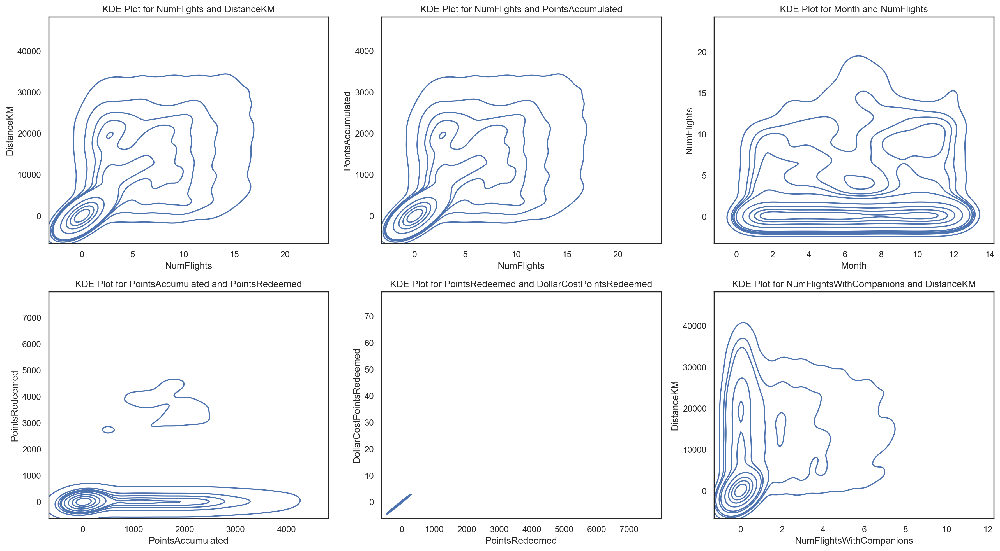

In [135]:
# a samples of 10,000 rows is created to make the plots less dense and it's possible to use this kind of plot
sample = flightsDB.sample(10_000, random_state=42)

plt.figure(figsize=(18, 10))

# NumFlights vs DistanceKM
plt.subplot(2, 3, 1)
sns.kdeplot(data=sample, x="NumFlights", y="DistanceKM")
plt.title("KDE Plot for NumFlights and DistanceKM")
plt.xlabel("NumFlights")
plt.ylabel("DistanceKM")

# NumFlights vs PointsAccumulated
plt.subplot(2, 3, 2)
sns.kdeplot(data=sample, x="NumFlights", y="PointsAccumulated")
plt.title("KDE Plot for NumFlights and PointsAccumulated")
plt.xlabel("NumFlights")
plt.ylabel("PointsAccumulated")

# NumFlights vs Month
plt.subplot(2, 3, 3)
sns.kdeplot(data=sample, x="Month", y="NumFlights")
plt.title("KDE Plot for Month and NumFlights")
plt.xlabel("Month")
plt.ylabel("NumFlights")

# PointsAccumulated vs PointsRedeemed
plt.subplot(2, 3, 4)
sns.kdeplot(data=sample, x="PointsAccumulated", y="PointsRedeemed")
plt.title("KDE Plot for PointsAccumulated and PointsRedeemed")
plt.xlabel("PointsAccumulated")
plt.ylabel("PointsRedeemed")

# PointsRedeemed vs DollarCostPointsRedeemed
plt.subplot(2, 3, 5)
sns.kdeplot(data=sample, x="PointsRedeemed", y="DollarCostPointsRedeemed")
plt.title("KDE Plot for PointsRedeemed and DollarCostPointsRedeemed")
plt.xlabel("PointsRedeemed")
plt.ylabel("DollarCostPointsRedeemed")

# NumFlightsWithCompanions vs DistanceKM
plt.subplot(2, 3, 6)
sns.kdeplot(data=sample, x="NumFlightsWithCompanions", y="DistanceKM")
plt.title("KDE Plot for NumFlightsWithCompanions and DistanceKM")
plt.xlabel("NumFlightsWithCompanions")
plt.ylabel("DistanceKM")


plt.tight_layout()
plt.show()


 Overall, the density distributions reveal that most clients tend to take only a few flights per month, travel relatively short distances, and accumulate and redeem few points. The results also show consistent and expected relationships, such as the positive association between the number of flights, total distance traveled, and points accumulated.

In contrast, only a small subset of customers stands out with higher activity levels, reflecting a typical loyalty program pattern where a minority of frequent flyers account for a large portion of total points and distance. The plots confirm the logical proportionality between redeemed points and their monetary value, while also showing that flights with companions are generally associated with shorter travel distances. 

The KDE analysis reinforces the main trends previously observed with scatterplots, offering a smoother and more interpretable view of the data density across key feature pairs.

<a class="anchor" id="6_1_3">

### **6.1.3.** Categorical Features Visualizations

[Back to TOC](#toc)
</a>


<p style="font-size:24px;">Bar Plots</p>

In this first part, boxplots are used to explore the distribution of flight activity across different time components, month/day/year.
The objective is to identify potential temporal patterns or irregularities in flight frequency and activity over the analyzed period.
This visualization helps reveal seasonal trends and possible anomalies related to specific time frames, providing an initial temporal perspective of customer flight behavior.

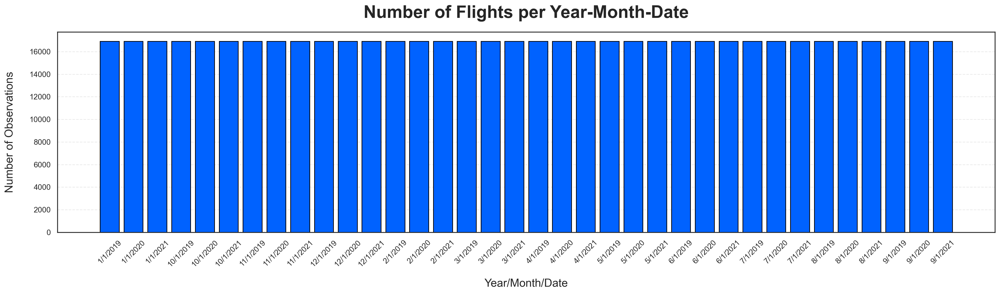

In [136]:
time_counts = flightsDB['YearMonthDate'].value_counts().sort_index()

plt.figure(figsize=(20,6))
bars = plt.bar(time_counts.index, time_counts.values, color="#0062FF", edgecolor="black")

plt.title("Number of Flights per Year-Month-Date", fontsize=25, fontweight="bold", pad=20)
plt.xlabel("Year/Month/Date", fontsize=16, labelpad=15)
plt.ylabel("Number of Observations", fontsize=16, labelpad=20)
plt.xticks(rotation=45)
plt.grid(True, linestyle="--", alpha=0.4, axis="y")
plt.tight_layout()
plt.show()

The bar chart refering to the YearMonthTime feature does not provide relevant information for the analysis, since this feature only considers de first day of each month so the values are uniques or have the same number of records. Therefore, no meaningful conclusions can be drawn from this visualization. However, it confirms a conclusion previously identified: the data is consistent across all months within the three years covered, with no missing entries. Thus, to obtain more relevant information, we will plot the features year and month in separated  and relate the categorical feature "YearMonthDate" with the numerical feature "NumFlights".

In the second part, a matrix of boxplots is presented. For this analysis, the number of flights features were converted from float to integer to correct the previously identified data type issue and ensure more accurate interpretation.
This adjustment allows us to draw more concrete conclusions about travel patterns and customer behavior, while also checking for potential outliers across different temporal and companion-related dimensions.
By comparing these distributions side by side, we gain a clearer understanding of how flight frequency and travel companionship vary throughout the dataset.

In [137]:
flightsDB[["NumFlights", "NumFlightsWithCompanions"]] = flightsDB[["NumFlights", "NumFlightsWithCompanions"]].astype(int)

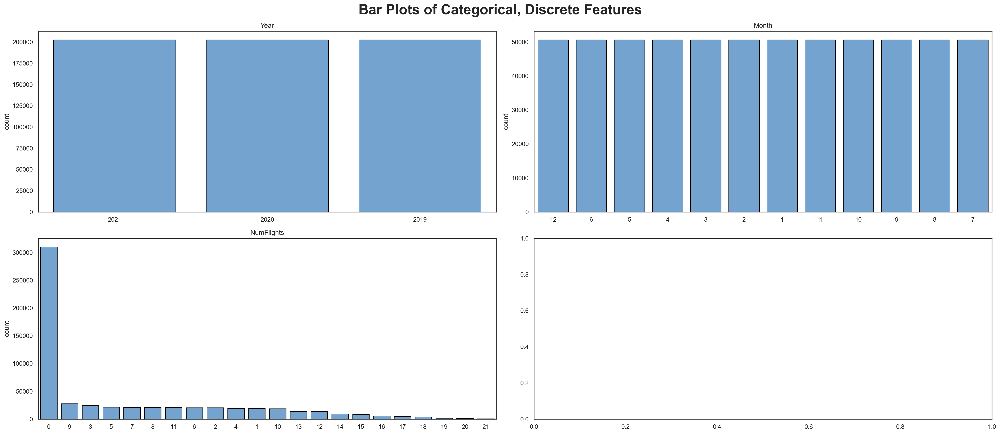

In [138]:
# To do bar plots we use Categorical + Discrete features + dates features
bar_plot_features = metric_features_FDB[:4] # "[:4]" to plot only the year, month
bar_plot_features.remove("Loyalty#")

sns.set(style="white")

fig, axes = plt.subplots(2, 2, figsize=(25, 11))

for ax, feat in zip(axes.flatten(), bar_plot_features):
    sns.countplot(x=flightsDB[bar_plot_features][feat], ax=ax, 
                  order=flightsDB[feat].value_counts().index, color="#66a4de", edgecolor="black") 
    ax.set_title(feat)
    ax.set_xlabel('') # Remove x-axis label for clarity

plt.suptitle("Bar Plots of Categorical, Discrete Features", fontsize=25, fontweight="bold")
plt.tight_layout() # Adjust spacing to prevent overlap
plt.show()

The bar plot analysis reveals a consistent distribution of flight activity across the three years and twelve months.
Regarding the number of flights, most customers have very few recorded flights, while only a small portion of the dataset represents frequent travelers.
A similar pattern is observed in the number of flights with companions, where the majority of passengers fly alone, and only a few travel with others on a regular basis.
These distributions highlight the natural skewness of airline data, where occasional travelers dominate the sample and reinforce the need to consider both frequent and infrequent flyers when defining customer segments later in the project.

<a class="anchor" id="6_1_4">

### **6.1.4.** Numeric and Categorical Features Visualizations

[Back to TOC](#toc)
</a>

<p style="font-size:24px;">Average Number of Flights per Customer</p>

This line plot shows the monthly trend of the average number of flights per customer over time.
By sorting and plotting the data by YearMonthDate, we can clearly observe the overall evolution of customer flight activity.
The results indicate that flight frequency tends to vary across months, with noticeable peaks and declines that may correspond to seasonal travel patterns or specific promotional periods.

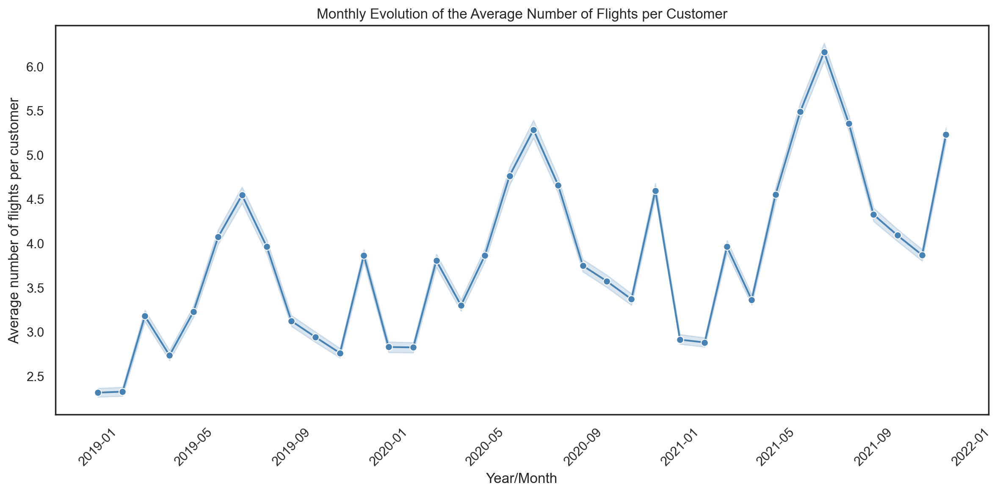

In [139]:
flightsDB["YearMonthDate"] = pd.to_datetime(flightsDB["YearMonthDate"])

# Ordenar pelas datas
flightsDB = flightsDB.sort_values("YearMonthDate")

plt.figure(figsize=(12,6))
sns.lineplot(
    x="YearMonthDate",
    y="NumFlights",
    data=flightsDB,
    marker="o",
    color="steelblue"
)

plt.title("Monthly Evolution of the Average Number of Flights per Customer")
plt.xlabel("Year/Month")
plt.ylabel("Average number of flights per customer")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

The graph shows the monthly evolution of the average number of flights per customer between 2019 and 2021.
A significant seasonal variation can be observed, with peaks of activity in certain months, possibly associated with holiday seasons, festive periods, or promotional campaigns and decreases in the following months.
The sharp decline at the beginning of 2020 coincides with the impact of the COVID 19 pandemic, which led to a strong reduction in air travel.
From 2021 onwards, a gradual recovery can be seen, reflecting the progressive return of customers to traveling.

<p style="font-size:24px;">Distribution of Monthly Flights per Customer (Boxplot)</p>

The boxplot visualizes the distribution of the number of flights per customer for each month of the year.
This representation allows us to identify seasonal behavior and the variability of flight activity within each month.
The analysis suggests that certain months consistently register higher flight activity, reflecting typical seasonal travel demand, while others show lower averages and less variation.

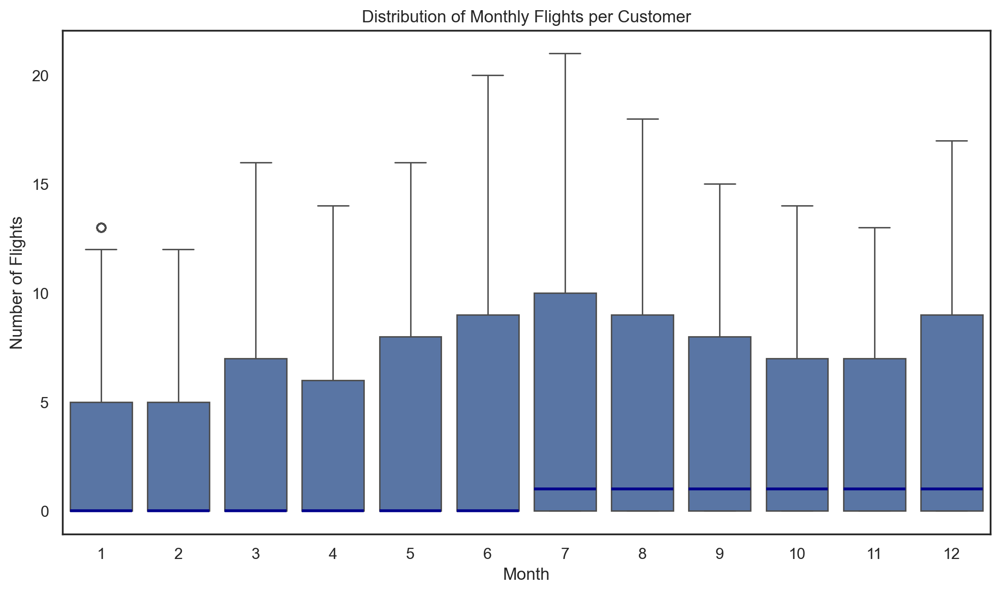

In [140]:
plt.figure(figsize=(10,6))
sns.boxplot(x="Month", y="NumFlights", data=flightsDB, medianprops={"color": "darkblue", "linewidth": 2})
plt.title("Distribution of Monthly Flights per Customer")
plt.xlabel("Month")
plt.ylabel("Number of Flights")
plt.tight_layout()
plt.show()

The boxplot reveals a clear seasonal trend in flight frequency, with higher median values and wider variability during the second part of the year, particularly starting in July until December which likely correspond to peak travel seasons.
In contrast, the first part of the year shows lower flight activity, indicating a slower travel period.

Overall, these results confirm that flight activity is not uniformly distributed throughout the year and that seasonality plays an important role in customer travel behavior, an aspect that can later be integrated into segmentation and marketing strategy development.

<p style="font-size:24px;">Average Number of Flights per Customer by Year (Bar Plot)</p>

This bar plot presents the average number of flights per customer aggregated by year.
It provides a clear overview of the long-term trend in flight activity, showing whether the overall number of flights per customer is increasing or decreasing over time.
The results highlight possible shifts in customer engagement or external factors (such as market changes or economic conditions) affecting yearly travel frequency.

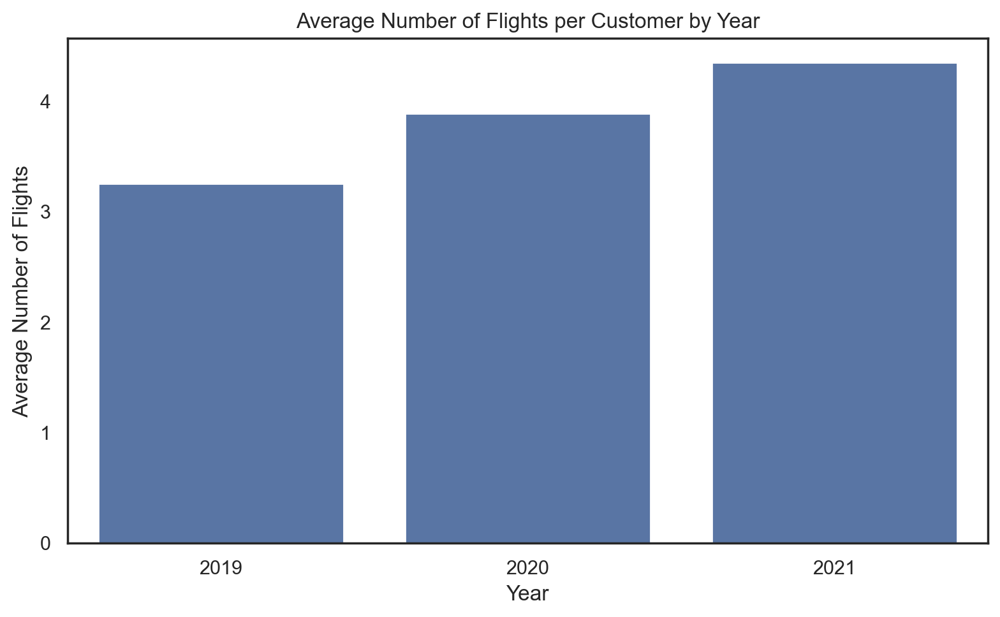

In [141]:
# we start by saving the average number of flights per customer by year in a new dataframe
flightsDB_year = flightsDB.groupby("Year", as_index=False)["NumFlights"].mean()

plt.figure(figsize=(8,5))
sns.barplot(x="Year", y="NumFlights", data=flightsDB_year)
plt.title("Average Number of Flights per Customer by Year")
plt.xlabel("Year")
plt.ylabel("Average Number of Flights")
plt.tight_layout()
plt.show()

The results indicate a steady increase in the average number of flights per customer from 2019 to 2021.
This upward trend suggests that, over the analyzed period, customers became more active and engaged with the airline, taking more flights on average each year.
Such growth may reflect the company’s successful loyalty initiatives, increased route availability, or gradual recovery and expansion of air travel demand following market fluctuations. This can be an important indicator of loyalty and potential value in future segmentation analyses.

<p style="font-size:24px;">Year vs. Month Heatmap of Average Flights</p>


The heatmap combines both yearly and monthly perspectives, showing the average number of flights per customer across different months and years.
This visualization allows for the quick identification of seasonal peaks and year-to-year variations, helping to reveal how travel patterns evolve over time.
The observed patterns confirm the presence of recurring high-activity months, as well as gradual changes across years, suggesting evolving customer travel behavior.

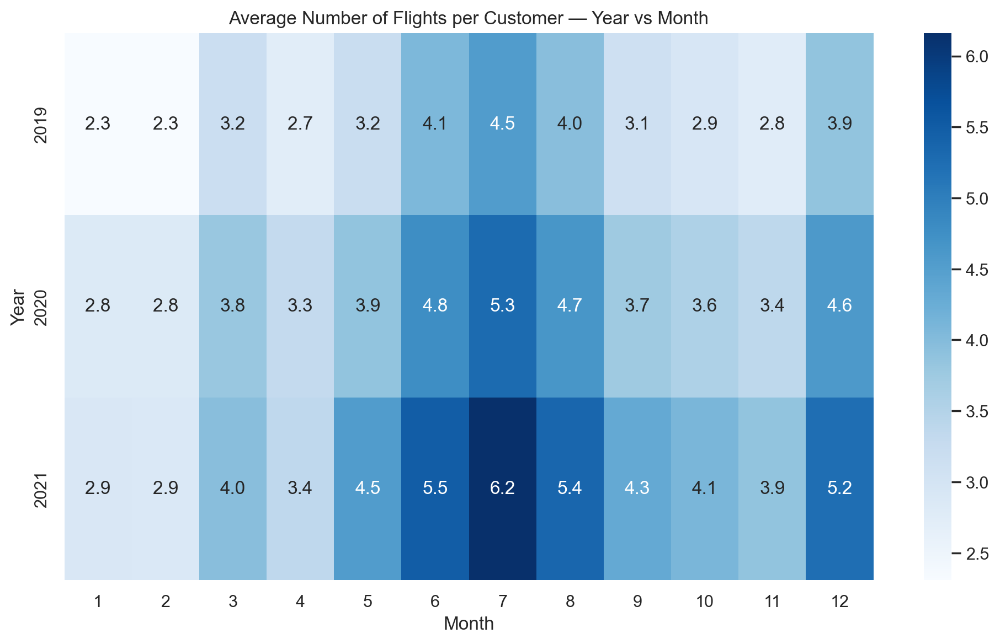

In [142]:
# We start creating the pivot table to use in the heatmap
flights_pivot = flightsDB.pivot_table( index="Year", columns="Month",
                                       values="NumFlights", aggfunc="mean")

plt.figure(figsize=(10,6))
sns.heatmap(flights_pivot, cmap="Blues", annot=True, fmt=".1f")
plt.title("Average Number of Flights per Customer — Year vs Month")
plt.xlabel("Month")
plt.ylabel("Year")
plt.tight_layout()
plt.show()

The heatmap clearly highlights both seasonal and yearly growth patterns in flight activity.
Across all three years, July consistently shows the highest average number of flights per customer, confirming it as the main peak travel month.
The summer months (June until August) display the most intense travel activity overall, while the beginning of the year record significantly lower averages.

In addition and in the same way as the previous graph, there is a noticeable increase in flight frequency over time, with 2021 showing higher monthly averages across nearly all months compared to 2019 and 2020.
This indicates a steady recovery and expansion in customer engagement, reflecting both growing travel demand and potentially more active participation in AIAI’s loyalty program.

<p style="font-size:24px;">Area Plot - Monthly Evolution of Points Accumulated and Redeemed</p>


This area plot displays the monthly evolution of points accumulated and redeemed by customers, offering a clear view of loyalty program activity over time. By aggregating data at a monthly level, it allows the identification of patterns and seasonal variations in customer engagement with the program.

<Axes: xlabel='YearMonthDate'>

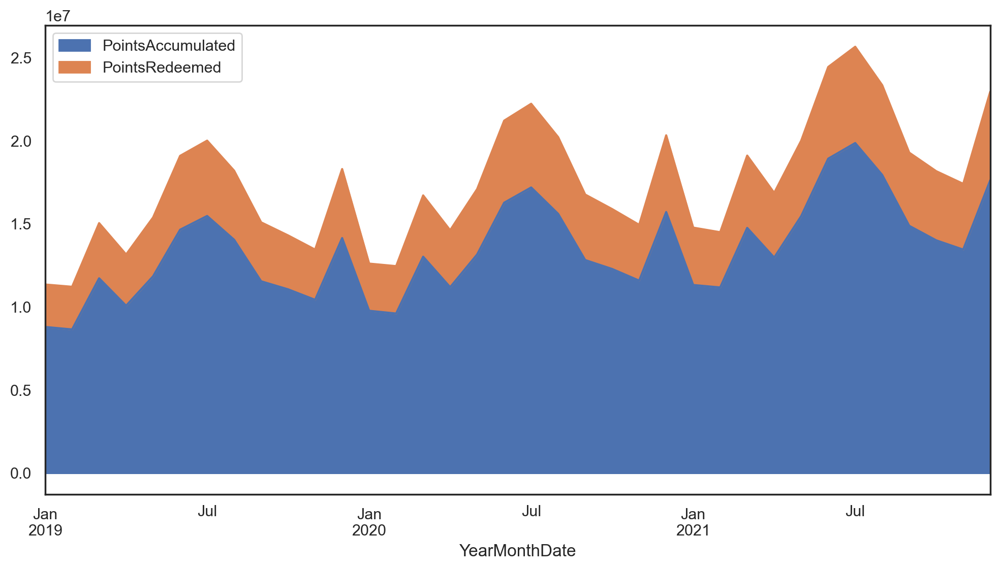

In [143]:
flightsDB.groupby('YearMonthDate')[['PointsAccumulated', 'PointsRedeemed']].sum().plot.area(figsize=(12,6))

The plot reveals that redeemed points consistently exceed accumulated points, indicating that customers are actively using their loyalty rewards rather than simply accumulating them. Once more, peaks in redemption and accumulation activity align with mid-year and end-of-year periods, suggesting strong travel demand during these times and reflecting the program’s effectiveness in driving repeat engagement through reward utilization.

<a class="anchor" id="6_2">

## **6.2.** CustomerDB

[Back to TOC](#toc)
</a>

Now, on the customerDB dataset, we create two lists to distinguish between metric and non-metric features. This separation helps us to analyze each group appropriately and ensures that our statistical and visual analyses are focused on the most relevant characteristics of customer behavior

In [144]:
# Transforming EnrollmentDateOpening and CancellationDate to datetime format
customerDB['EnrollmentDateOpening'] = pd.to_datetime(customerDB['EnrollmentDateOpening'], errors='coerce')
customerDB['CancellationDate'] = pd.to_datetime(customerDB['CancellationDate'], errors='coerce')

# Adding EnrollmentYear and CancellationYear columns to CustomerDB so we can add it to the metric features and analyze it later on visualizations
customerDB['EnrollmentYear'] = customerDB['EnrollmentDateOpening'].dt.year
customerDB['CancellationYear'] = customerDB['CancellationDate'].dt.year
#errors='coerce' will convert invalid parsing to NaT

In [145]:
dates_features = customerDB[["EnrollmentDateOpening", "CancellationDate"]].columns.tolist()

metric_features_CDB = customerDB.select_dtypes(include=['number']).columns.tolist()[1:] # Exclude 'Loyalty#' which is the first column
non_metric_features_CDB = customerDB.columns.drop(metric_features_CDB).to_list()[1:]

continuous_features_CDB = ["Latitude", "Longitude", "Income", "Customer Lifetime Value"]
discrete_features_CDB = customerDB[["EnrollmentYear", "CancellationYear"]].columns.tolist()
categorical_features_CDB = customerDB.select_dtypes(include= 'object', exclude='datetime').columns.tolist()

Now we show the lists that were defined before in a dataframe format so we can have a better view of the features that each list contain.

In [146]:
data = list(zip_longest(
    dates_features,
    metric_features_CDB,
    non_metric_features_CDB,
    continuous_features_CDB,
    discrete_features_CDB,
    categorical_features_CDB,
    fillvalue=""
))

headers = [
    "Date Features",
    "Metric Features",
    "Non-Metric Features",
    "Continuous Features",
    "Discrete Features",
    "Categorical Features"
]

print(tabulate(data, headers=headers, tablefmt="github"))


| Date Features         | Metric Features         | Non-Metric Features   | Continuous Features     | Discrete Features   | Categorical Features   |
|-----------------------|-------------------------|-----------------------|-------------------------|---------------------|------------------------|
| EnrollmentDateOpening | Latitude                | First Name            | Latitude                | EnrollmentYear      | First Name             |
| CancellationDate      | Longitude               | Last Name             | Longitude               | CancellationYear    | Last Name              |
|                       | Income                  | Customer Name         | Income                  |                     | Customer Name          |
|                       | Customer Lifetime Value | Country               | Customer Lifetime Value |                     | Country                |
|                       | EnrollmentYear          | Province or State     |                         |     

<a class="anchor" id="6_2_1">

### **6.2.1.** Metric Features Visualizations

[Back to TOC](#toc)
</a>

<p style="font-size:24px;">Histograms</p>

After distinguishing between metric and non-metric features, we observe that all metric features in the customerDB dataset are continuous. To explore their distributions, we present histograms for each feature. For a clearer representation, and to better visualize the underlying patterns, we overlay a smooth line on each histogram. This general analysis helps to identify trends and understand the overall behavior of these continuous features.

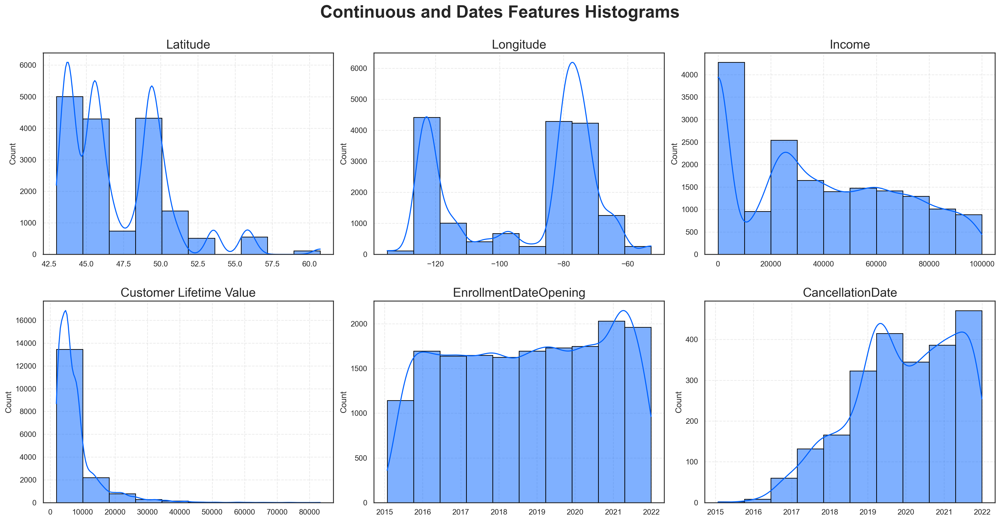

In [147]:
#To plot histograms we will use continuous and date features that were identified before

# Set minimal style
sns.set_style("white") # increase contrast

# Create a canvas for the metric features
fig, axes = plt.subplots(2, # set number of rows
                         ceil(len(continuous_features_CDB + dates_features) / 2), # adapt the number of columns to the number of features 
                         figsize=(20, 10),
                         constrained_layout=True) # Adjust automatically spacing between subplot and labels 

# Increase vertical space between rows
fig.set_constrained_layout_pads(h_pad=.2)

# Plot the data
# Iterate across axes objects and associate each histogram:
for ax, feat in zip(axes.flatten(), continuous_features_CDB + dates_features):
    sns.histplot(customerDB[feat],
                 bins=10,
                 kde=(feat in continuous_features_CDB + dates_features), #smooth line only for continuous features
                 ax=ax,
                 color="#0062FF",
                 edgecolor="black")
    ax.set_title(feat, fontsize=18)
    ax.grid(True, linestyle="--", alpha=0.4)
    ax.set_xlabel("")

# Layout
# Add title, make it bigger and bold and add space between title and first row of plots
plt.suptitle("Continuous and Dates Features Histograms", 
             fontsize = 25, fontweight="bold", y=1.05)

# Create the folder '../figures/eda' if it doesn't already exist
os.makedirs(os.path.join('..', 'figures', 'eda'), exist_ok=True)
    
# Save figure to a png file in the folder created before
plt.savefig(os.path.join('..', 'figures', 'eda', 'numeric_features_histograms.png'), dpi=200)

# Show plot
plt.show()

From the histograms above we can see that:

- `Latitude:` Shows a right skewed distribution, with very inconsistent values, suggesting that customers are located in several distinct regions, possibly corresponding to different branch or market areas.

- `Longitude:` Values show two strong clusters at the extremes, which may correspond to distinct geographical regions or countries where customers are concentrated.

- `Income`: The distribution is right-skewed with a heavy tail, biggest group being the first bin (least income), which represents low-budget travelers and it shows a sudden drop in the second bin, which could represent different customer segments (economy-class).

- `Customer Lifetime Value`: Heavily right-skewed distribution, with a very heavy tail, which shows that most customers have relatively low lifetime values, while a small minority contributes disproportionately high value.

- `EnrollmentDateOpening:` Appear to be relatively uniform from 2015 to 2021, with a slight increase toward more recent years. This suggests steady customer acquisition over time, possibly with stronger marketing or expansion after 2019.

- `CancellationDate:`The number of cancellations has been increasing steadily since 2016, peaking around 2021. This could indicate growing customer churn in recent years, perhaps due to increased competition, customer dissatisfaction, or changes in business strategy.

<p style="font-size:24px;">Boxplots</p>

To further analyze the distribution of metric features in the customerDB, we utilize boxplots. These visualizations were applied to continuous numerical features allow us to efficiently spot potential outliers and to summarize key aspects such as the spread, central tendency, and skewness of each feature. This approach supports a thorough assessment of data quality and guides subsequent analytical decisions.

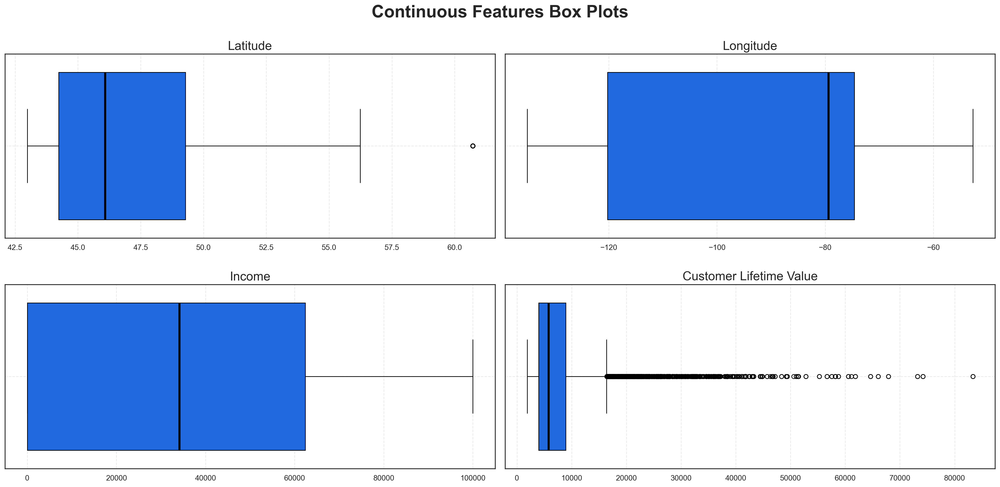

In [148]:
# Create canvas with the same structure as before
fig, axes = plt.subplots(2, 
                         ceil(len(continuous_features_CDB ) / 2), 
                         figsize=(20, 10),
                         constrained_layout=True) # Adjust automatically spacing between subplot and labels 

# Increase vertical space between rows
fig.set_constrained_layout_pads(h_pad=.2)

# Plot data
# Iterate across axes objects and associate each box plot:
for ax, feat in zip(axes.flatten(), continuous_features_CDB):
    # We need to reset the index to avoid errors since we haven't dealt with duplicate values yet
    sns.boxplot(x=customerDB[feat], ax=ax, 
                # Set inside color to blue
                color="#0062FF",
                # Set line colors to black
                boxprops=dict(edgecolor="black"),
                whiskerprops=dict(color="black"),
                capprops=dict(color="black"),
                medianprops=dict(color="black", linewidth=3),
                flierprops=dict(markeredgecolor="black")) 
    
    # Put grid with low opacity and dashed line so it's visible, but not distracting
    ax.grid(True, linestyle="--", alpha=0.4)

    # Put title of each graph with bigger font
    ax.set_title(feat, fontsize=18)

    # Hide x label since we already have the boxlplot title at the top
    ax.set_xlabel("") 

# Layout
# Add a centered title to the figure and plot it
plt.suptitle("Continuous Features Box Plots", 
             fontsize = 25, fontweight="bold")

# Create the folder '../figures/eda' if it doesn't already exist
os.makedirs(os.path.join('..', 'figures', 'eda'), exist_ok=True)

# Save figure to a png file in the folder created before
plt.savefig(os.path.join('..', 'figures', 'eda', 'numeric_features_histograms.png'), dpi=200)

# Show plot
plt.show()

From the boxplots above we can conclude that:

- `Latitude:` The values range between ~43-56.5°, with most values on the higher latitudes and one outlier more up north.
- `Longitude:` Values between -140° and -55° with a lot of values on lower longitudes, no outliers.
- The combination of these two features tells us AIA's customers are from North America, more specifically from Canada and the northern states of the USA.
- `Income:` There is a wide range of salaries, a quarter of the customers have income close to zero and another quarter has low-mid income, which pulls the median down and provokes right skewness. No outliers.
- `Customer Lifetime Value:` It's always at least ~1000$ and has a median of around 6000$. Has a very right skewed distribution with lots of outliers that represent the customers that are very profitable and thus important for the company.

<p style="font-size:24px;">Yearly Enrollments and Cancellations Trends</p>

To better understand the evolution of customer acquisition and retention over time, we plotted the yearly number of enrollments and cancellations. These visualizations provide a clear view of how customer engagement has changed across the years, highlighting potential growth patterns, market expansions, or customer churn tendencies.

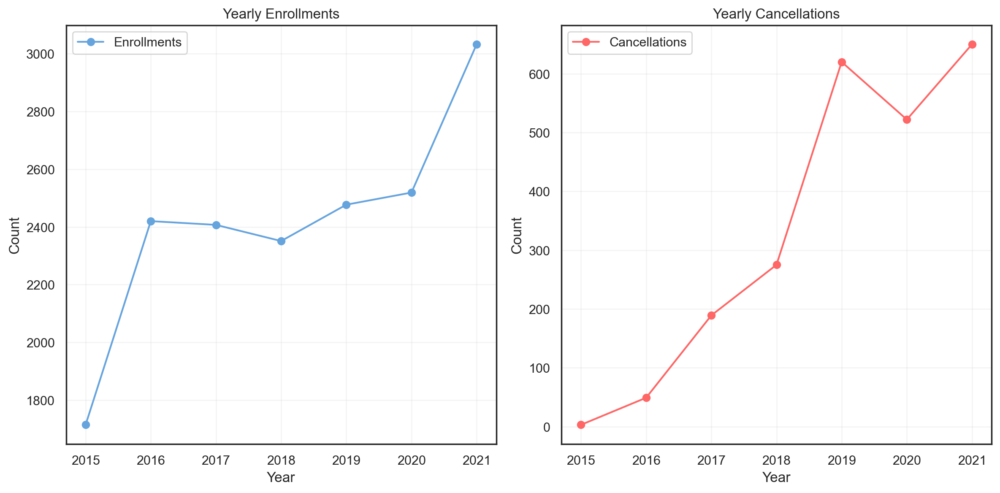

In [149]:
yearly_enrollment_counts = customerDB["EnrollmentYear"].value_counts().sort_index()
yearly_cancellation_counts = customerDB["CancellationYear"].value_counts().sort_index()

plt.figure(figsize=(12, 6))

plt.subplot(1,2,1)
plt.plot(yearly_enrollment_counts.index, yearly_enrollment_counts.values, marker='o', label='Enrollments', color='#66a4de')
plt.title("Yearly Enrollments")
plt.xlabel("Year")
plt.ylabel("Count")
plt.legend()
plt.grid(True, alpha=0.2)

plt.subplot(1,2,2)
plt.plot(yearly_cancellation_counts.index, yearly_cancellation_counts.values, marker='o', label='Cancellations', color='#ff6666')
plt.title("Yearly Cancellations")
plt.xlabel("Year")
plt.ylabel("Count")
plt.legend()
plt.grid(True, alpha=0.2)

plt.tight_layout()
plt.show()


From this new plots we can conclude that:

- `Yearly Enrollments plot:` Shows a relatively stable trend from 2016 to 2020, followed by a significant increase in 2021. This sharp rise likely corresponds to the 2021 promotional campaign observed earlier in the dataset, which successfully boosted new customer acquisitions.

- `Yearly Cancellations plot:` reveals a continuous upward trend from 2015 to 2021, with the highest cancellation rate also occurring in 2021. This pattern suggests that although customer acquisition increased, customer churn also grew proportionally, possibly as a side effect of attracting a large number of short-term or promotion-driven customers.

Overall, these trends indicate that the company experienced strong growth in 2021, but may need to further investigate retention strategies to reduce cancellations in the following periods.

<a class="anchor" id="6_2_2">

### **6.2.2.** Relationship between Metric Features (CustomerDB)

[Back to TOC](#toc)
</a>

<p style="font-size:24px;">Scatterplots</p>

Are used to explore the relationships between numerical features in the dataset. By plotting data points across two axes, they allow us to visualize how values vary together and to identify patterns such as correlations, groupings, or anomalies. This type of visualization helps reveal how different factors—like flight frequency, travel distance, and loyalty points—interact with one another. Overall, the scatterplots offer useful insights into customer behavior and help uncover possible trends and dependencies among features.

<p style="font-size:24px;">Initial Scatterplot</p>

We start by performing a general and straightforward analysis of several relationships between features that could potentially be significant. Based on the results of this initial exploration, we then focus on examining in greater detail the relationships that appear to be the most informative or meaningful for further analysis.

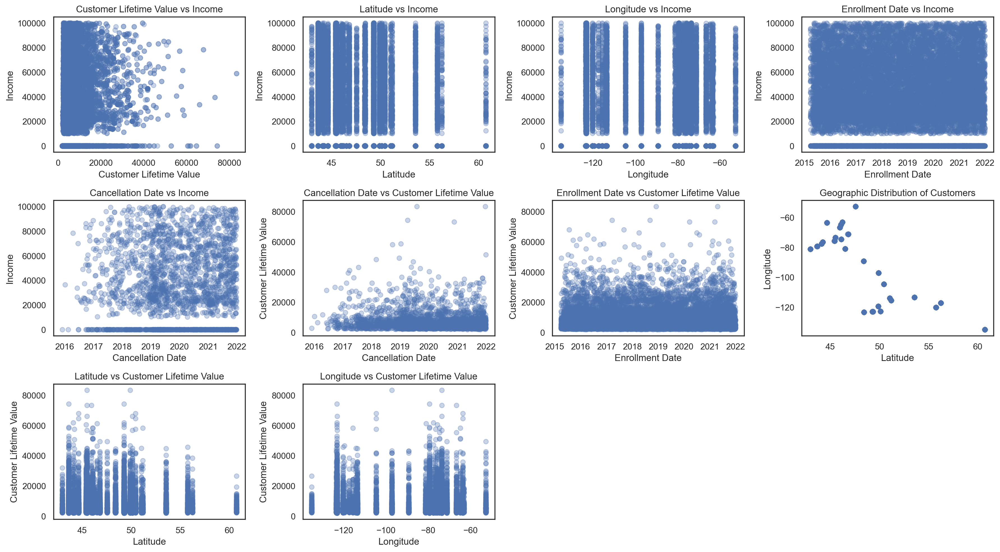

In [150]:
plt.figure(figsize=(18, 10))

# Customer Lifetime Value vs Income
plt.subplot(3, 4, 1)
plt.scatter(customerDB["Customer Lifetime Value"], customerDB["Income"], alpha=0.3)
plt.title("Customer Lifetime Value vs Income")
plt.xlabel("Customer Lifetime Value")
plt.ylabel("Income")

# Income vs Latitude
plt.subplot(3, 4, 2)
plt.scatter(customerDB["Latitude"], customerDB["Income"], alpha=0.3)
plt.title("Latitude vs Income")
plt.xlabel("Latitude")
plt.ylabel("Income")

#Income vs Longitude
plt.subplot(3, 4, 3)
plt.scatter(customerDB["Longitude"], customerDB["Income"], alpha=0.3)
plt.title("Longitude vs Income")
plt.xlabel("Longitude")
plt.ylabel("Income")

# Enrollment Date vs Income
plt.subplot(3, 4, 4)
plt.scatter(customerDB["EnrollmentDateOpening"], customerDB["Income"], alpha=0.3)
plt.title("Enrollment Date vs Income")
plt.xlabel("Enrollment Date")
plt.ylabel("Income")

# Cancellation Date vs Income
plt.subplot(3, 4, 5)
plt.scatter(customerDB["CancellationDate"], customerDB["Income"], alpha=0.3)
plt.title("Cancellation Date vs Income")
plt.xlabel("Cancellation Date")
plt.ylabel("Income")

#Cancelation Date vs Customer Lifetime Value
plt.subplot(3, 4, 6)
plt.scatter(customerDB["CancellationDate"], customerDB["Customer Lifetime Value"], alpha=0.3)
plt.title("Cancellation Date vs Customer Lifetime Value")
plt.xlabel("Cancellation Date")
plt.ylabel("Customer Lifetime Value")

#Enrollment Date vs Customer Lifetime Value
plt.subplot(3, 4, 7)
plt.scatter(customerDB["EnrollmentDateOpening"], customerDB["Customer Lifetime Value"], alpha=0.3)
plt.title("Enrollment Date vs Customer Lifetime Value")
plt.xlabel("Enrollment Date")
plt.ylabel("Customer Lifetime Value")

# Latitude vs Longitude
plt.subplot(3, 4, 8)
plt.scatter(customerDB["Latitude"], customerDB["Longitude"], alpha=0.3)
plt.title("Geographic Distribution of Customers")
plt.xlabel("Latitude")
plt.ylabel("Longitude")

# Customer Lifetime Value vs Latitude
plt.subplot(3, 4, 9)
plt.scatter(customerDB["Latitude"], customerDB["Customer Lifetime Value"], alpha=0.3)
plt.title("Latitude vs Customer Lifetime Value")
plt.xlabel("Latitude")
plt.ylabel("Customer Lifetime Value")

# Customer Lifetime Value vs Longitude
plt.subplot(3, 4, 10)
plt.scatter(customerDB["Longitude"], customerDB["Customer Lifetime Value"], alpha=0.3)
plt.title("Longitude vs Customer Lifetime Value")
plt.xlabel("Longitude")
plt.ylabel("Customer Lifetime Value")

plt.tight_layout()
plt.show()


The general scatterplot overview provided a first look at how numerical features relate to one another within the CustomerDB dataset.
Although the data have not yet been cleaned, several preliminary insights emerged:
- The relationship between Income and Customer Lifetime Value appears weak, but some customers with higher income levels do achieve higher lifetime values.
- Geographical features (Latitude and Longitude) show clear clustering, indicating that customer locations are recorded at a regional.
- Temporal features (Enrollment and Cancellation Dates) are spread throughout the observed period, suggesting consistent customer acquisition and churn over time.
- Some data quality issues are visible, such as overlapping points and potential zeros.

Even though these findings are exploratory, they already help define the directions for deeper analysis. In the next stage, we will concentrate on specific scatterplots that display patterns likely to provide valuable insights into customer behavior and the connections between flight activity, loyalty points, and redemption value.

<p style="font-size:24px;">Latitude vs Longitude</p>

Now we examine individually the relationship between customers’ recorded latitude and longitude values. Exploring this spatial distribution helps us visualize geographic patterns, identify clusters of customer locations, and gain insights into regional travel behaviors or market concentration.

/var/folders/x4/93zv09_n7r951k9d9t268vt80000gn/T/ipykernel_54198/3987941910.py:10: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


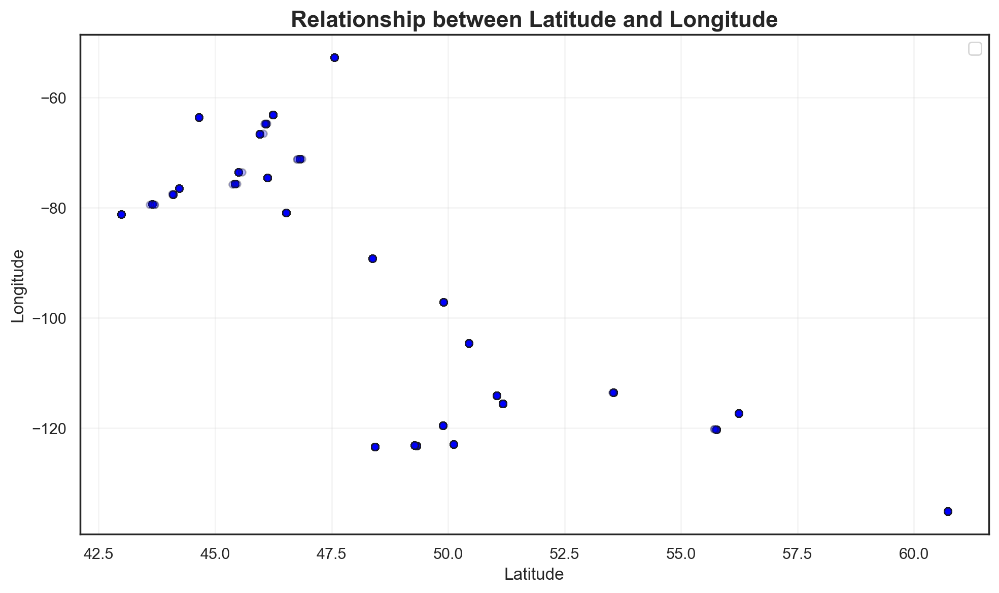

In [151]:
x = customerDB["Latitude"]
y = customerDB["Longitude"]

sns.set_style("white")
plt.figure(figsize=(10, 6))
plt.scatter(x, y, s=25, alpha=0.3, c='blue', edgecolor='k')
plt.title("Relationship between Latitude and Longitude", fontsize=16, fontweight='bold')
plt.xlabel("Latitude") 
plt.ylabel("Longitude") 
plt.legend()
plt.grid(True, alpha=0.2)
plt.tight_layout()
plt.show()

The graph is very underwhelming. We were expecting lots of data, but looks like there are very few Latitude-Longitude points, which doesn't allow us to make much conclusions.

In [152]:
lat_count = customerDB["Latitude"].count()
long_count = customerDB["Longitude"].count()

print(f"Latitude has {lat_count} values.")
print(f"Longitude has {long_count} values.")

Latitude has 16921 values.
Longitude has 16921 values.


In [153]:
lat_duplicated = customerDB["Latitude"].duplicated().sum()
long_duplicated = customerDB["Longitude"].duplicated().sum()

print(f"The Latitude column has {lat_duplicated} duplicated values, which represents {(lat_duplicated/lat_count*100).round(2)}% of the total data.")
print(f"The Longitude column has {long_duplicated} duplicated values, which represents {(long_duplicated/long_count*100).round(2)}% of the total data.")

The Latitude column has 16872 duplicated values, which represents 99.71% of the total data.
The Longitude column has 16872 duplicated values, which represents 99.71% of the total data.


This explains why we had so few points in the scatter plot. Let's see what exactly are the values.

In [154]:
customerDB[["Latitude","Longitude"]].value_counts()

Latitude   Longitude  
43.653225  -79.383186     3387
49.282730  -123.120740    2600
45.501690  -73.567253     2064
49.895138  -97.138374      676
50.116322  -122.957360     586
44.648766  -63.575237      541
45.421532  -75.697189      516
53.544388  -113.490930     510
44.101128  -77.576309      490
46.813877  -71.207977      481
55.759628  -120.237660     441
45.963589  -66.643112      432
50.445210  -104.618900     412
44.231171  -76.485954      406
46.118462  -74.596184      399
48.428421  -123.365650     391
45.428730  -75.713364      363
49.328625  -123.160190     315
48.380894  -89.247681      258
47.561508  -52.712578      258
46.522099  -80.953033      229
46.087818  -64.778229      215
51.048615  -114.070850     193
51.178398  -115.570800     190
42.984924  -81.245277      176
56.234180  -117.289380     113
60.721188  -135.056840     112
49.887951  -119.496010      80
46.238239  -63.131069       67
45.365906  -75.723181        1
43.690489  -79.436758        1
55.751178  -120.

By searching what these coordinates represent on Google Maps, we conclude they identify the city the customer is from and not their exact location, probably for privacy reasons.
For example, the first 3 coordinates represent Toronto, Vancouver and Montreal, which are all Canadian cities.

Since we already have a column that represents the name of the city the customer is from, we conclude the **columns for Latitude and Longitude are redundant**.

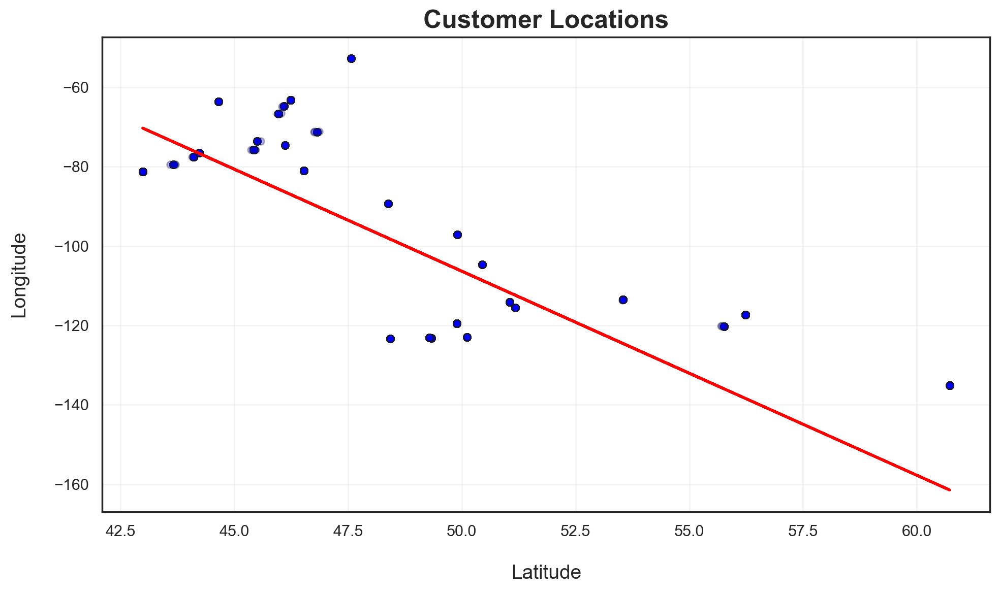

In [155]:
import numpy as np

x = customerDB["Latitude"]
y = customerDB["Longitude"]

# Scatter plot as before
plt.figure(figsize=(10, 6))
sns.set_style("white")
plt.scatter(x, y, s=25, alpha=0.3, c='blue', edgecolor='k')

# Fit a linear trend line
coeffs = np.polyfit(x, y, 1)
trend = np.poly1d(coeffs)
plt.plot(x, trend(x), color='red', linewidth=2)  # Line

plt.title("Customer Locations", fontsize=18, fontweight='bold')
plt.xlabel("Latitude", fontsize=14, labelpad=18)
plt.ylabel("Longitude", fontsize=14, labelpad=18)
plt.grid(True, alpha=0.2)
plt.tight_layout()
plt.show()


Plotting a trend line on the scatter plot, we can see a version of the geographic distribution of the cities. From this, we can say there are two main clusters of cities: the ones in the northeast and the ones in the southwest.

The trendline represents a link between the two groups of cities and could represent some routes of the flights taken.

To complement the analysis of the graphs above, we used a two-dimensional density plot (KDE plot), which allows us to visualize the areas with the highest concentration of points based on the Longitude and Latitude coordinates.

<Axes: xlabel='Longitude', ylabel='Latitude'>

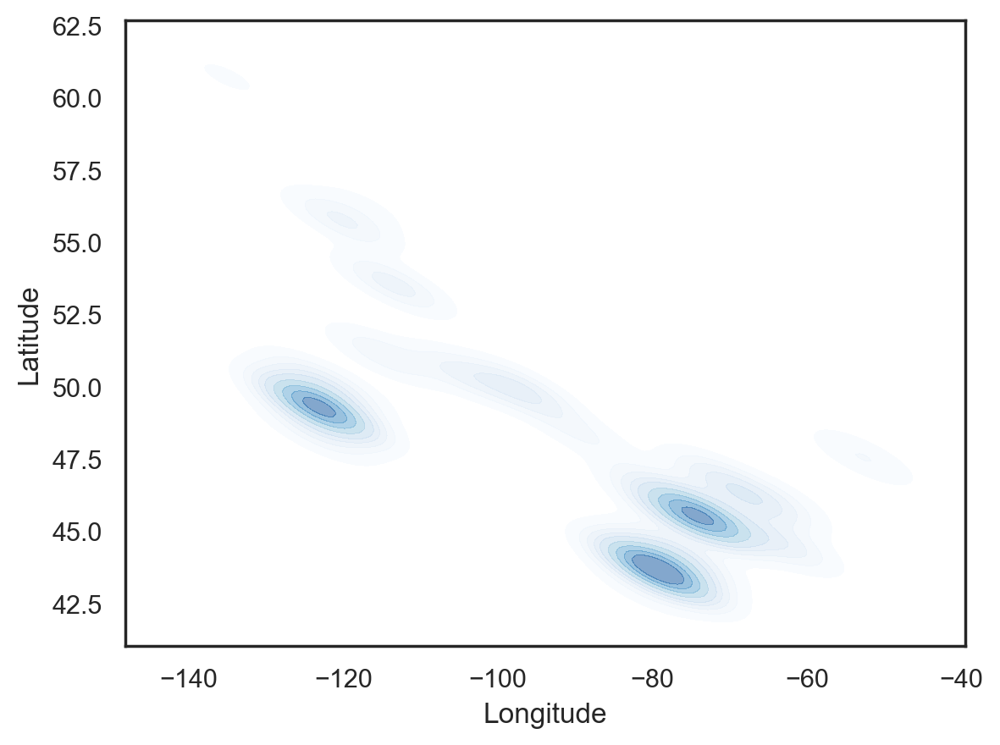

In [156]:
sns.kdeplot(data=customerDB, x='Longitude', y='Latitude', fill=True, cmap='Blues', alpha=0.5)

Through the graph, it is possible to confirm once again the previously identified concentration. It can be observed that the darker areas (with higher density) correspond to the regions previously highlighted as the main customer hubs, thus validating the detected geographical patterns.

<p style="font-size:24px;">Customer Lifetime Value and Income</p>

Given the business context, it is important to understand whether a customer's income is linked to their overall value for the company, as measured by Customer Lifetime Value. By analyzing the relationship between these two features, we can uncover whether higher-income clients tend to generate more revenue and loyalty over time. Identifying such patterns can guide targeted marketing strategies or segmentation in later project stages.

To ensure the analysis is based on valid and meaningful data, we first removed any records with missing values or zero income. We then use a scatter plot to visualize the association between income and Customer Lifetime Value.

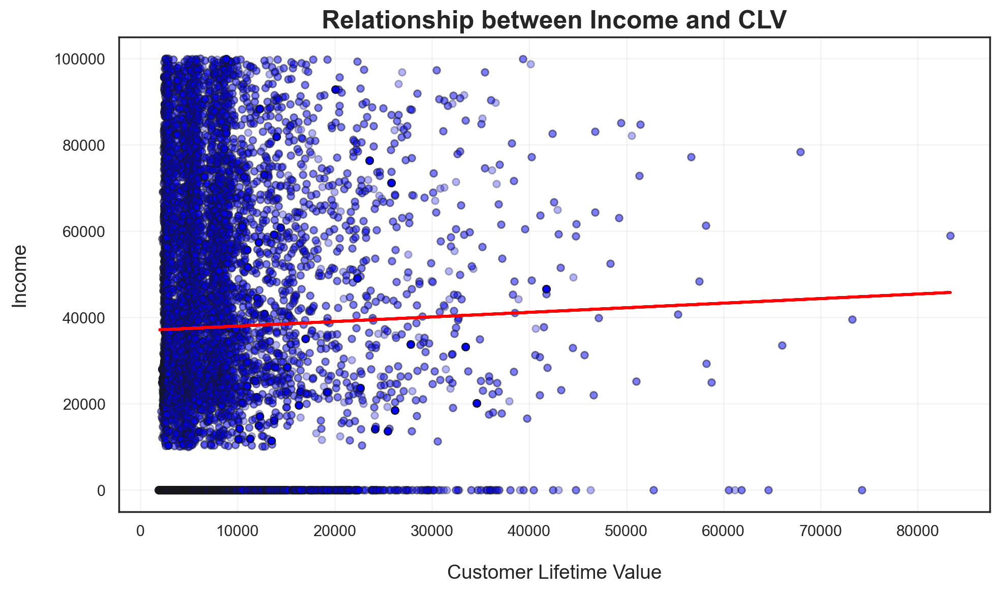

In [157]:
mask = (
    customerDB["Income"].notna() &
    (customerDB["Income"] >= 0) &
    customerDB["Customer Lifetime Value"].notna()
)

income_clean = customerDB.loc[mask, "Income"]
clv_clean = customerDB.loc[mask, "Customer Lifetime Value"]

plt.figure(figsize=(10, 6))
sns.set_style("white")
plt.scatter(clv_clean, income_clean, s=25, alpha=0.3, c='blue', edgecolor='k')

# Fit a linear trend line only on valid data
coeffs = np.polyfit(clv_clean, income_clean, 1)
trend = np.poly1d(coeffs)
plt.plot(clv_clean, trend(clv_clean), color='red', linewidth=2)

plt.title("Relationship between Income and CLV", fontsize=18, fontweight='bold')
plt.xlabel("Customer Lifetime Value", fontsize=14, labelpad=18)
plt.ylabel("Income", fontsize=14, labelpad=18)
plt.grid(True, alpha=0.2)
plt.tight_layout()
plt.show()


There is no clear relationship between customer income and Customer Lifetime Value (CLV) in this dataset. Across all income levels, there is a wide spread of CLV values, indicating that income is not a predictive factor for overall customer value. This suggests that other factors beyond income drive long-term customer engagement and spending.

<p style="font-size:24px;">Hexbinplots</p>

Hexbin plots will serve as an additional visualization method. They offer a more detailed representation of data density and distribution, making it easier to detect clusters, concentration zones, and underlying patterns that might not be as evident in standard scatterplots.

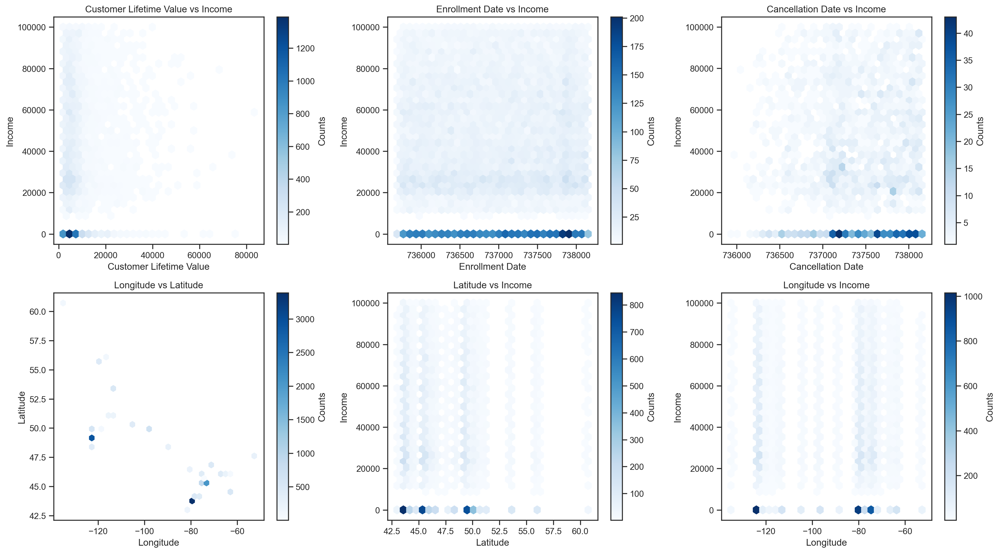

In [158]:
sns.set_style('ticks')
plt.figure(figsize=(18, 10))

# Income vs Customer Lifetime Value
plt.subplot(2, 3, 1)
plt.hexbin(customerDB["Customer Lifetime Value"], customerDB["Income"], gridsize=30, cmap="Blues", mincnt=1)
plt.title("Customer Lifetime Value vs Income")
plt.xlabel("Customer Lifetime Value")
plt.ylabel("Income")
plt.colorbar(label="Counts")

# Enrollment Date Opening vs Income
enrollment_ordinal = customerDB["EnrollmentDateOpening"].map(lambda x: x.toordinal()) # Convert EnrollmentDate to ordinal for regression, because the function that it's used needs numerical input
plt.subplot(2, 3, 2)
plt.hexbin(enrollment_ordinal, customerDB["Income"], gridsize=30, cmap="Blues", mincnt=1)
plt.title("Enrollment Date vs Income")
plt.xlabel("Enrollment Date")
plt.ylabel("Income")
plt.colorbar(label="Counts")

# Cancellation Date vs Income
cancellation_ordinal = customerDB["CancellationDate"].map(
    lambda x: x.toordinal() if pd.notna(x) else np.nan
) # Convert CancellationDate to ordinal for regression, because the function that it's used needs numerical input and handle NaT values
plt.subplot(2, 3, 3)
plt.hexbin(cancellation_ordinal, customerDB["Income"], gridsize=30, cmap="Blues", mincnt=1)
plt.title("Cancellation Date vs Income")
plt.xlabel("Cancellation Date")
plt.ylabel("Income")
plt.colorbar(label="Counts")

# Longitude vs Latitude
plt.subplot(2, 3, 4)
plt.hexbin(customerDB["Longitude"], customerDB["Latitude"], gridsize=40, cmap="Blues", mincnt=1)
plt.title("Longitude vs Latitude")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.colorbar(label="Counts")

# Latitude vs Income
plt.subplot(2, 3, 5)
plt.hexbin(customerDB["Latitude"], customerDB["Income"], gridsize=30, cmap="Blues", mincnt=1)
plt.title("Latitude vs Income")
plt.xlabel("Latitude")
plt.ylabel("Income")
plt.colorbar(label="Counts")

# Longitude vs Income
plt.subplot(2, 3, 6)
plt.hexbin(customerDB["Longitude"], customerDB["Income"], gridsize=30, cmap="Blues", mincnt=1)
plt.title("Longitude vs Income")
plt.xlabel("Longitude")
plt.ylabel("Income")
plt.colorbar(label="Counts")

plt.tight_layout()
plt.show()


The results show that data points are highly concentrated near zero values for income and lifetime value, suggesting a large number of customers with limited or missing financial data. The distributions appear mostly uniform, with no evident linear or non-linear relationships between the features.
The geographic hexbin plot (Longitude vs Latitude) indicates that customers are primarily clustered within specific regions, consistent with the expected concentration around major populated areas, but no additional insights can be drawn without mapping contextual information.

<a class="anchor" id="6_2_3">

### **6.2.3.** Categorical visualizations (CustomerDB)

[Back to TOC](#toc)
</a>

Before separating the metric and categorical features, it was necessary to filter out those that do not provide analytical insights.
features such as First Name, Last Name, Customer Name, and Postal Code were excluded, as they act merely as unique identifiers and do not contribute to understanding customer behavior or analytical patterns.
Now we will analyze the rest of the features.

<p style="font-size:24px;">Bar Plots</p>

The bar plot overview provides a general understanding of the categorical and discrete features in the CustomerDB dataset.
It helps identify dominant categories, potential imbalances, and overall data distribution before moving to more detailed analyses.

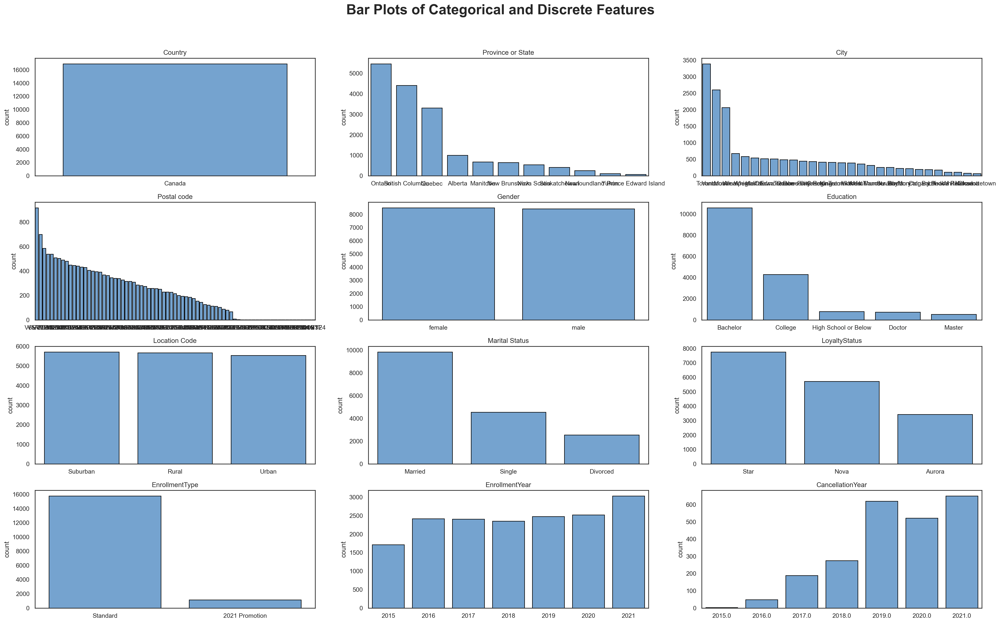

In [159]:
# To do bar plots we use Categorical + Discrete features + dates features
bar_plot_features = categorical_features_CDB[3:] + discrete_features_CDB # "[3:]" Exclude first name, last name, customer name cause they will not enter in our plots

sns.set(style="white")

fig, axes = plt.subplots(4, 3, figsize=(25, 15))

for ax, feat in zip(axes.flatten(), bar_plot_features):

    # The follow code defines the order of the values for the features EnrollmentYear and CancellationYear
    # In this way we can analyze the years in chronological order
    if pd.api.types.is_numeric_dtype(customerDB[feat]):
        order_vals = sorted(customerDB[feat].dropna().unique())
    else:
        order_vals = customerDB[feat].value_counts().index

    # Cria o gráfico
    sns.countplot(
        x=customerDB[feat],
        ax=ax,
        order=order_vals,
        color="#66a4de",
        edgecolor="black"
    )
    ax.set_title(feat, fontsize=12)
    ax.set_xlabel('') # Remove x-axis label for clarity

plt.suptitle("Bar Plots of Categorical and Discrete Features",
             fontsize=25, fontweight="bold", y=1.03)

plt.tight_layout()# Adjust spacing to prevent overlap
plt.show()


Most features present relatively balanced or interpretable distributions. For instance, Gender is well distributed, Marital Status and Education show more pronounced differences, with Married and Bachelor being the most common categories, respectively.

The the Postal Code, although it was included for completeness, the resulting plot confirms that this feature is highly granular, containing a large number of unique values. This makes it unsuitable for meaningful categorical visualization, as the plot becomes overcrowded and difficult to interpret.

The LoyaltyStatus feature also indicates a clear tier hierarchy, with Star being the most frequent status, followed by Nova and Aurora, which aligns with typical loyalty program structures.
In terms of EnrollmentType, the majority of customers joined through the Standard method, with only a small portion coming from the 2021 Promotion, indicating a limited campaign impact or a short promotional period.

Regarding EnrollmentYear and CancellationYear distributions suggest a steady inflow of new customers throughout the years, with visible cancellations occurring mainly from 2018 onwards, increasing toward 2021.
For further analysis, broader geographic groupings such as City or Province/State will be preferred, offering clearer regional insights.

Overall, these bar plots serve as an initial diagnostic step, highlighting the main categorical structures of the dataset. In the next phase, specific features with business relevance, such as LoyaltyStatus, Education, Marital Status, and EnrollmentType, will be explored in greater depth to extract more actionable insights.

Following the general overview of categorical features, we will now perform a more detailed analysis focusing on the City and Province or State features.
These two geographic features were selected because they offer valuable insights into customer distribution and potential regional differences in behavior and value.
While the initial bar plots already indicated strong variation across cities and provinces, their high number of categories made the overall patterns difficult to interpret.

<p style="font-size:24px;">City</p>

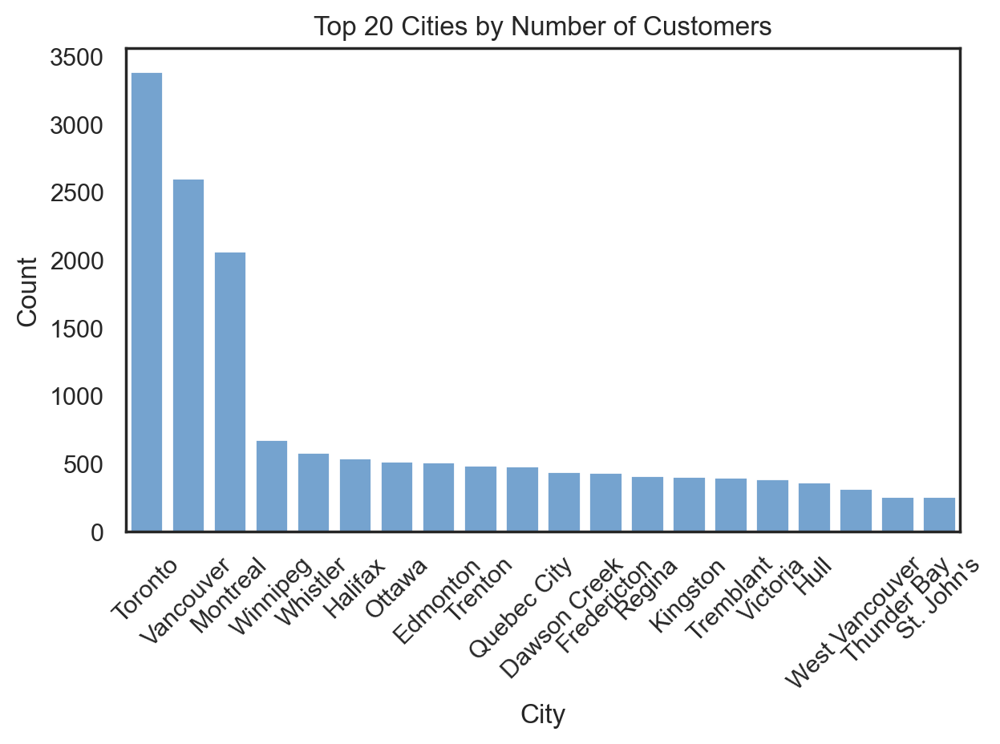

In [160]:
top_cities = customerDB["City"].value_counts().nlargest(20).index

sns.countplot(
    x="City",
    data=customerDB[customerDB["City"].isin(top_cities)],
    order=top_cities,    
    color="#66a4de"
)
plt.title("Top 20 Cities by Number of Customers")
plt.xlabel("City")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

The chart reveals that Toronto, Vancouver, and Montreal are the top three cities with the highest number of customers. This indicates that the company’s customer base is strongly concentrated in major urban centers, particularly in Ontario and Quebec. These cities should therefore be considered key markets for targeted marketing and customer retention initiatives.

<p style="font-size:24px;">Province or State</p>

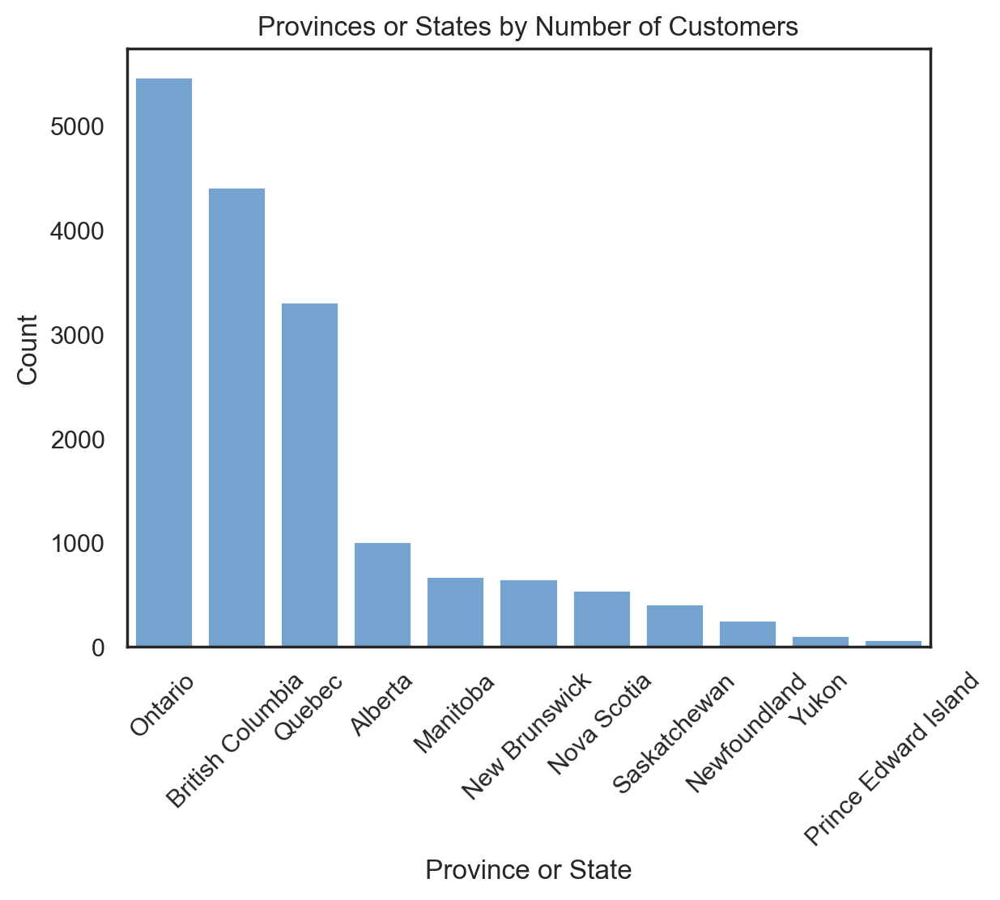

In [161]:
provinces_or_states = customerDB["Province or State"].value_counts().index

sns.countplot(
    x="Province or State",
    data=customerDB[customerDB["Province or State"].isin(provinces_or_states)],
    order=provinces_or_states,
    color="#66a4de"
)
plt.title("Provinces or States by Number of Customers")
plt.xlabel("Province or State")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

The results show that Ontario, British Columbia, and Quebec have the largest number of customers, indicating that most of the client base is concentrated in these provinces.

<p style="font-size:24px;">EnrollmentDateOpening</p>

A monthly enrollment plot was also created to analyze temporal trends in customer acquisition. The visualization reveals monthly variations and highlights potential seasonal or campaign-related effects that are not visible at the yearly level.

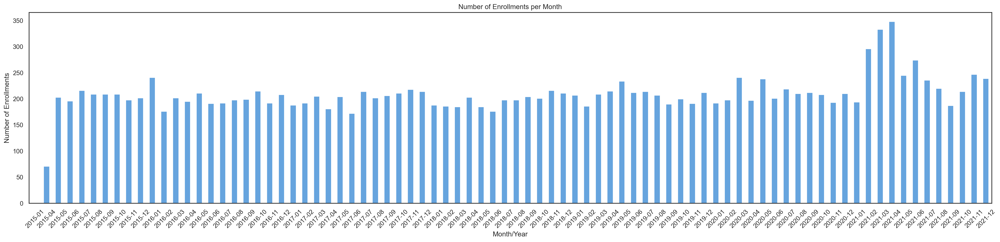

In [162]:
customerDB["EnrollmentDateOpening"] = pd.to_datetime(customerDB["EnrollmentDateOpening"])
monthly_enrollment = customerDB["EnrollmentDateOpening"].dt.to_period("M").value_counts().sort_index()

plt.figure(figsize=(30,6))
monthly_enrollment.plot(kind="bar", color="#66a4de")
plt.title("Number of Enrollments per Month")
plt.xlabel("Month/Year")
plt.ylabel("Number of Enrollments")
plt.xticks(rotation=45)
plt.show()

The monthly enrollment data shows a generally stable trend with noticeable peaks towards the end of each year, suggesting periodic increases in customer activity. This pattern may be linked to seasonal promotions or renewal cycles, indicating opportunities to reinforce marketing strategies during these high-demand periods.

<a class="anchor" id="6_2_4">

### **6.2.4.** Relationship between Categorical Features

[Back to TOC](#toc)
</a>

As mentioned earlier, we will now explore the possible relationships between the categorical features. This analysis will help us uncover patterns and gain insights that may be relevant for understanding customer behavior and supporting further analysis.

<p style="font-size:24px;">Stacked bar charts</p>

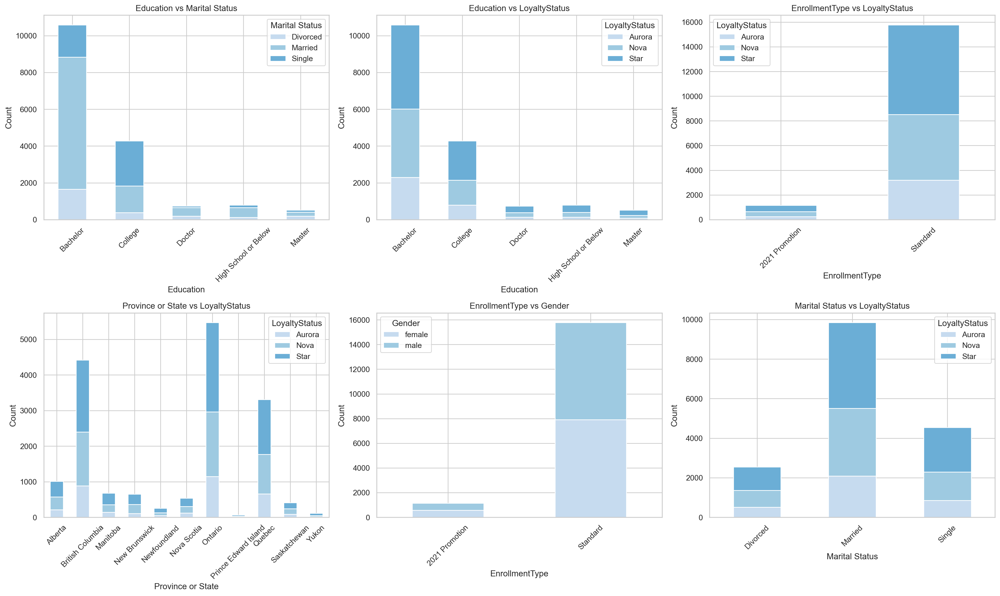

In [163]:
# Style setting
sns.set(style="whitegrid")

# Generate all 2-way combinations
pairs_to_plot = [
    ('Education', 'Marital Status'),
    ('Education', 'LoyaltyStatus'),
    ('EnrollmentType', 'LoyaltyStatus'),
    ('Province or State', 'LoyaltyStatus'),
    ('EnrollmentType', 'Gender'),
    ('Marital Status', 'LoyaltyStatus'),
]

# Create figure with subplots
fig, axes = plt.subplots(2, 3 , figsize=(20, 12))
axes = axes.flatten()

# Generate a plot for each pair
for i, (x, y) in enumerate(pairs_to_plot):
    pd.crosstab(customerDB[x], customerDB[y]).plot(kind='bar', stacked=True, ax=axes[i], color=['#c6dbef', '#9ecae1', '#6baed6', '#3182bd', '#08519c'])
    axes[i].set_title(f"{x} vs {y}")
    axes[i].set_xlabel(x)
    axes[i].set_ylabel("Count")
    axes[i].tick_params(axis='x', rotation=45)




# Delete unused subplots
for j in range(10, len(axes)):
    fig.delaxes(axes[j]) 
    
plt.tight_layout()
plt.show()

`Education vs Marital Status and Education vs LoyaltyStatus`:
As seen before, the predominant group of customers holds a "Bachelor" degree. Among these "Bachelor" customers, many are married (as shown in the first chart) and belong to the "Star" loyalty status (as seen in the second chart). This suggests that married customers with a "Bachelor" level of education tend to achieve the highest loyalty status ("Star") in the company.

`EnrollmentType vs LoyaltyStatus and EnrollmentType vs Gender`:
The analysis reveals that the "Standard" enrollment group has the highest customer concentration and represents the main segment of the database. Within this group, most customers reach the top loyalty statuses, especially "Star" and then "Nova". Additionally, the proportion of male and female customers is roughly equal among "Standard" members, indicating a balanced gender distribution in the core loyal segment.

`Province or State vs LoyaltyStatus`:
The combined analysis shows that most customers are located in British Columbia, Ontario, and Quebec, as previously identified. Within these key provinces, the majority of customers consistently belong to the highest loyalty status, "Star". This indicates that the most loyal and engaged clients are concentrated in these regions, highlighting them as strategic areas for targeted loyalty programs and marketing efforts.

`Marital Status vs LoyaltyStatus`:
As previously seen, the "Married" segment represents the largest proportion of customers. Within this group, most individuals hold the highest loyalty status, "Star", followed by "Nova". This indicates that the company's most loyal customers are predominantly married.









<p style="font-size:24px;">Stacked histograms by category</p>

These visualizations allow for a clear comparison of how features such as Enrollment Year, Income, and Cancellation Year vary according to Education level and Loyalty Status.
By stacking the data within each category, it becomes easier to observe proportional differences and identify potential patterns in customer enrollment, income distribution, and program retention across distinct loyalty groups.

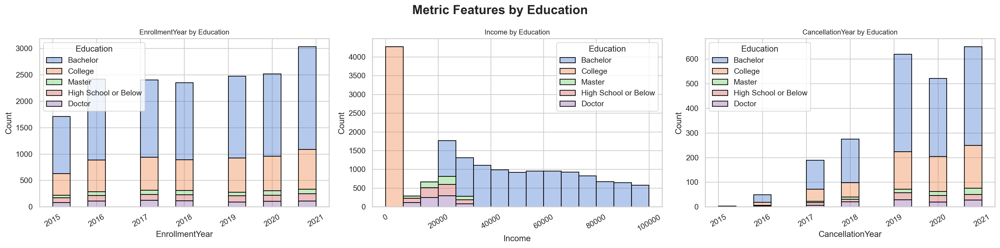

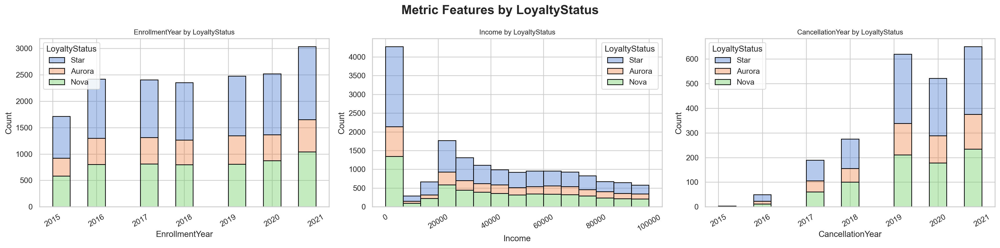

In [164]:
# Loop through each categorical feature for hue
for hue_var in ['Education', 'LoyaltyStatus']:
    fig, axes = plt.subplots(1, 3, figsize=(20, 5))

    for ax, feat in zip(axes.flatten(), ['EnrollmentYear', 'Income', 'CancellationYear']):
        sns.histplot(customerDB, x=feat, hue=hue_var, bins=15, ax=ax,
                     multiple='stack',
                     alpha=0.4, # Transparency for better visibility
                     edgecolor='black',  # Border color for better distinction
                     palette='muted'     # Muted color palette
                    )
        ax.set_title(f"{feat} by {hue_var}", fontsize=10)
        ax.tick_params(axis='x', rotation=30)

    plt.suptitle(f"Metric Features by {hue_var}", fontsize=18, fontweight="bold")
    plt.tight_layout()
    plt.show()

`Metric Features by Education:`
The number of customers has steadily increased over the years, with the majority in each enrollment year consistently coming from the "Bachelor" education category. Furthermore, these "Bachelor" customers tend to have a significantly higher income than those with other education levels, making this group both the largest and most financially valuable segment in the database. However, the number of cancellations has also increased significantly over the years. Among those who cancelled, customers with a "Bachelor" degree consistently represent the highest proportion. This suggests that while "Bachelor" clients dominate new enrollments and income, they also drive the majority of cancellations, highlighting a need to further investigate the retention and satisfaction levels of this critical segment.

`Metric Features by LoyaltyStatus:`
Across all three charts for this section, the "Star" loyalty status consistently represents the largest group, whether in terms of total customers, income, or cancellations. "Star" customers are typically the highest earners, but they also account for the majority of cancellations. This pattern reinforces the importance of monitoring and understanding the needs and retention challenges of the "Star" segment, as they are both the most valuable and the most at risk.

<p style="font-size:24px;">Customer Lifetime Value by Enrollment Year and Loyalty Status</p>

This line plot illustrates the evolution of Customer Lifetime Value (CLV) across different enrollment years, segmented by Loyalty Status.
The objective is to observe whether the year in which customers joined the loyalty program influences their overall lifetime value and to identify potential differences between loyalty tiers over time. The shaded areas represent the confidence intervals, helping assess variability within each group.

<Axes: xlabel='EnrollmentYear', ylabel='Customer Lifetime Value'>

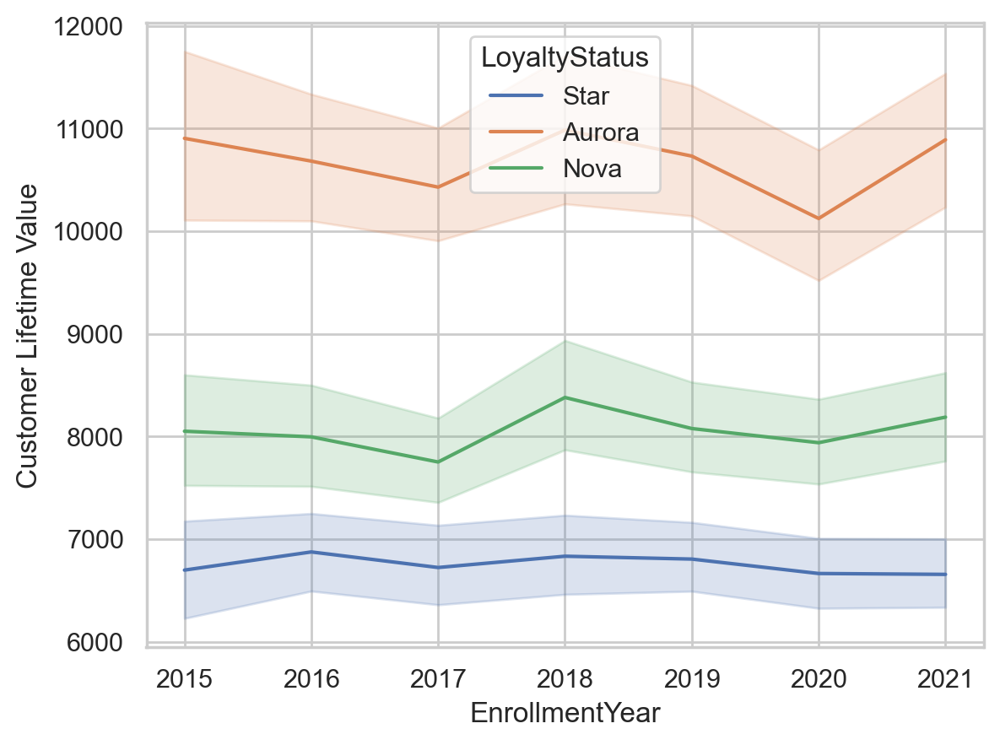

In [165]:
sns.lineplot(data=customerDB, x='EnrollmentYear', y='Customer Lifetime Value', hue='LoyaltyStatus')

The results show a clear separation between loyalty tiers, with Aurora members consistently achieving the highest Customer Lifetime Value, followed by Nova and Star. This suggest that higher loyalty status correlates with increased long-term customer value.
Although there are slight fluctuations across enrollment years, the relative hierarchy between tiers remains stable, suggesting that the loyalty program effectively retains and rewards high-value customers regardless of enrollment period.

<p style="font-size:24px;">Income Distribution by Education Level and Gender</p>

This boxplot visualizes the distribution of Income across different Education levels, with a further breakdown by Gender.
The purpose of this analysis is to explore how educational attainment influences income and to assess whether gender plays a significant role within each education category. Boxplots are particularly useful here as they display both the spread and central tendency of income, while also revealing potential outliers.

<Axes: xlabel='Education', ylabel='Income'>

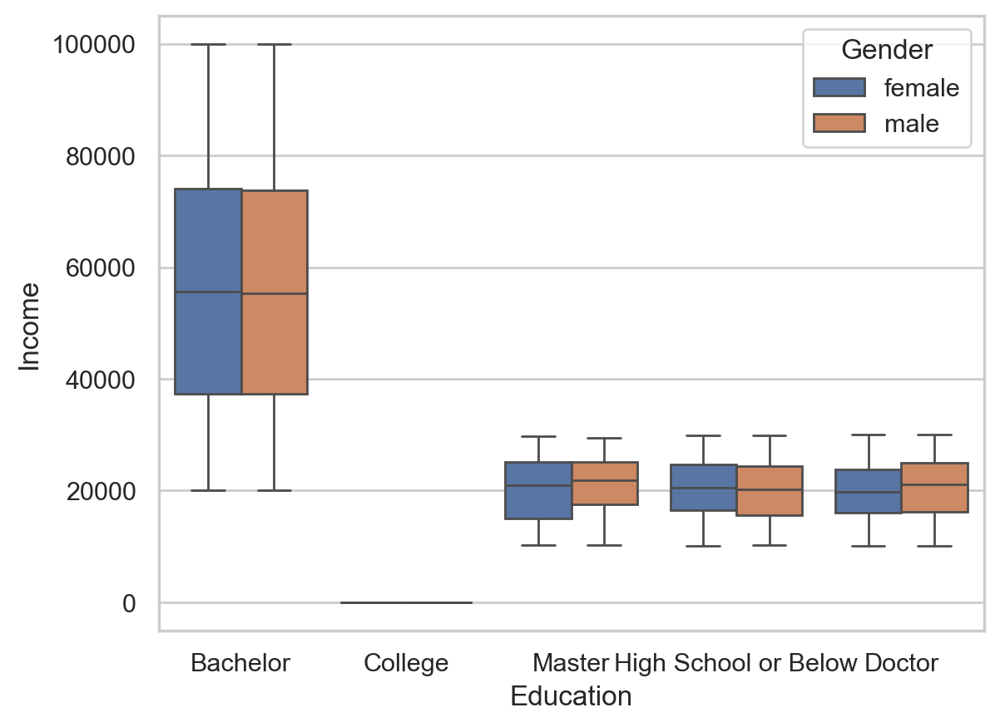

In [166]:
sns.boxplot(data=customerDB, x='Education', y='Income', hue='Gender')

The results show that Bachelor’s degree holders have substantially higher income levels compared to all other education categories, indicating a strong positive relationship between this education level and earning potential.
Across all education levels, income differences between genders are minimal, suggesting that gender does not have a pronounced impact on income within this dataset.
Education appears to be the primary factor driving income variation, while gender-based disparities are relatively insignificant.

<p style="font-size:24px;">Gender Distribution Across Education Levels</p>

This heatmap illustrates the distribution of education levels across genders, showing the proportion of males and females within each education category.
By normalizing the values by gender, it allows for a clear comparison of how educational attainment varies between men and women, highlighting potential trends or imbalances in the dataset.

<Axes: xlabel='Education', ylabel='Gender'>

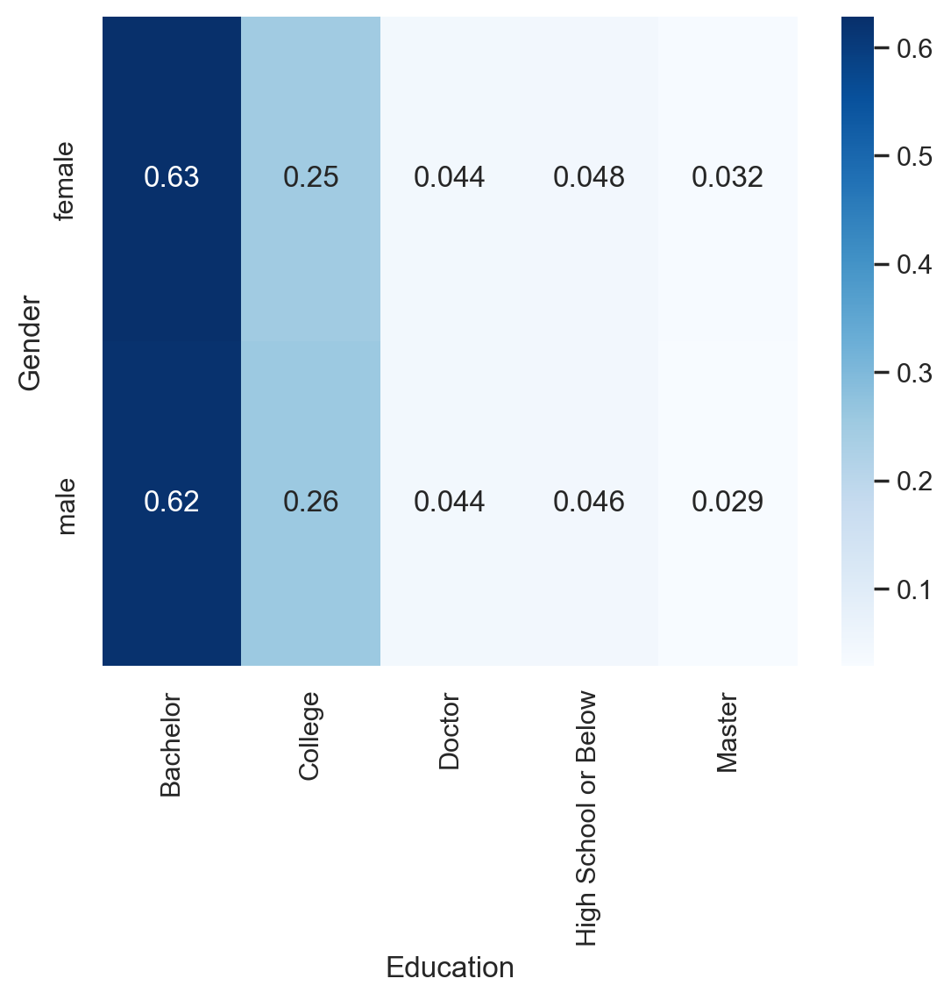

In [167]:
tab = pd.crosstab(customerDB['Gender'], customerDB['Education'], normalize='index')
sns.heatmap(tab, annot=True, cmap='Blues')

The results reveal a very similar distribution of education levels between genders. Both males and females have the highest representation among those with a Bachelor’s degree, followed by College education.
Advanced degrees such as Doctor or Master, as well as High School or Below, are considerably less common across both genders.
Overall, gender does not appear to significantly influence education level, suggesting a balanced educational profile between male and female customers.

<a class="anchor" id="7">

# **7. Geo-Spatial Insights (Extra 1)**

[Back to TOC](#toc)
</a>

<p style="font-size:24px;">Create Map</p>

For the visualisation to work inside the interpreter, we may need to remove security settings:

In VSCode, open @tag:workspaceTrust and remove the Security › Workspace › Trust: Enabled check**.** It asks to restart the VSCode.

Even with this precaution, we warn that it can take some time to load.

In [168]:
# Filter valid coordinates
customerDB_clean = customerDB.dropna(subset=['Longitude', 'Latitude', 'LoyaltyStatus', 'City'])

# Aggregate by city
city_summary = customerDB_clean.groupby(['City', 'Latitude', 'Longitude']).agg(
    Total_Customers=('LoyaltyStatus', 'count'),
    Star_Program=('LoyaltyStatus', lambda x: (x=='Star').sum()),
    Nova_Program=('LoyaltyStatus', lambda x: (x=='Nova').sum()),
    Aurora_Program=('LoyaltyStatus', lambda x: (x=='Aurora').sum())
).reset_index()

# Base map: center in mean of coordinates, full width
center_lat = city_summary['Latitude'].mean()
center_lon = city_summary['Longitude'].mean()
m = folium.Map(location=[center_lat, center_lon], zoom_start=5, width='100%', height=800)

# MarkerCluster
marker_cluster = MarkerCluster().add_to(m)

fill_colors = {"Star": "blue", "Nova": "green", "Aurora": "red"}

# Add one marker per city
for _, row in city_summary.iterrows():
    # Determine dominant loyalty program
    counts = {
        "Star": row['Star_Program'],
        "Nova": row['Nova_Program'],
        "Aurora": row['Aurora_Program']
    }
    dominant = max(counts, key=counts.get)
    color = fill_colors[dominant]

    # HTML popup
    html = f"""
    <div style="width: 250px; font-size: 10px; line-height: 1.2;">
        <b>City:</b> {row['City']}<br>
        <b>Total Customers:</b> {row['Total_Customers']}<br>
        <b>Star Program:</b> {row['Star_Program']}<br>
        <b>Nova Program:</b> {row['Nova_Program']}<br>
        <b>Aurora Program:</b> {row['Aurora_Program']}
    </div>
    """
    iframe = IFrame(html=html, width=100, height=80)
    popup = folium.Popup(iframe, max_width=300)

    # Scale bubble size more for visibility
    radius = max(5, np.sqrt(row['Total_Customers'])*1.3)  # sqrt scaling
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=radius,
        color='black',
        weight=0.5,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        popup=popup
    ).add_to(marker_cluster)

# Display map directly in Jupyter Notebook
display(m)


From the map we can see which are the cities with the most amount of customers by the size of the bubble, as well as which is the most common Loyalty Type by its color. Clicking on a bubble we can see the amount of customers that reside in that city as well as the details of how many there are for each Loyalty type.

Analysing the graph we can see many different cities all around Canada, some with large amounts of customers, but also others with just one. Blue is the dominating color, representing the Star Loyalty program.

<a class="anchor" id="8">

# **8. Interactive EDA Dashboard (Extra 2)**

[Back to TOC](#toc)
</a>

Enter this into the terminal to get the dashboard link:
- streamlit run app.py --server.headless true

<a class="anchor" id="8_1">

## **8.1.** Prerequisit Files

[Back to TOC](#toc)
</a>


First we need to create .py files to load the data and import the plots.

In [170]:
%%writefile requirements.txt
streamlit
pandas
matplotlib
seaborn
fastcore


Overwriting requirements.txt


<p style="font-size:24px;">Write data_loader.py file</p>

In [171]:
%%writefile data_loader.py
import pandas as pd
import os

def load_data():
    """Load FlightsDB, CustomerDB and Metadata CSVs with correct paths."""

    FILE_DIR = os.path.dirname(__file__)  # Folder where this .py file exists
    DATA_DIR = os.path.join(FILE_DIR, "data")  # Data folder next to app.py

    # Build reliable absolute paths
    flights_path = os.path.join(DATA_DIR, "DM_AIAI_FlightsDB.csv")
    customer_path = os.path.join(DATA_DIR, "DM_AIAI_CustomerDB.csv")
    metadata_path = os.path.join(DATA_DIR, "DM_AIAI_Metadata.csv")

    # Load CSVs
    flightsDB = pd.read_csv(flights_path, sep=",", index_col="Loyalty#")
    customerDB = pd.read_csv(customer_path, sep=",", index_col="Loyalty#")
    metaData = pd.read_csv(metadata_path, sep=";", header=None)

    # Feature lists
    non_metric_features_FDB = ["YearMonthDate"]
    metric_features_FDB = flightsDB.columns.drop(non_metric_features_FDB).to_list()
    continuous_FDB = ["DistanceKM", "PointsAccumulated", "PointsRedeemed", "DollarCostPointsRedeemed"]

    metric_features_CDB = customerDB.select_dtypes(include=['number']).columns.tolist()
    continuous_CDB = ["Latitude", "Longitude", "Income", "Customer Lifetime Value"]
    non_metric_features_CDB = customerDB.columns.drop(metric_features_CDB).to_list()

    # categorical_features_CDB = customerDB.select_dtypes(include= 'object', exclude='datetime').columns.tolist()
    # discrete_features_CDB = customerDB[["EnrollmentYear", "CancellationYear"]].columns.tolist()

    return (
        flightsDB, customerDB, metaData,
        non_metric_features_FDB, metric_features_FDB, continuous_FDB,
        metric_features_CDB, continuous_CDB, non_metric_features_CDB
    )


Overwriting data_loader.py


<p style="font-size:24px;">Write graph_functions.py file</p>

Write a file with all the `graph_functions.py` we will be using on the dashboard.

In [ ]:
%%writefile graph_functions.py
import matplotlib.pyplot as plt
import seaborn as sns
from math import ceil
import numpy as np
import pandas as pd

def location_scatter_CDB(df: pd.DataFrame, lon_col: str = "Longitude", lat_col: str = "Latitude",
                         show_trend: bool = True, figsize=(10, 6)):
    """
    Scatter plot of Longitude vs Latitude using ALL available points.
    - df: dataframe
    - lon_col, lat_col: column names for longitude & latitude
    - show_trend: whether to fit and show a linear trend line
    Returns: matplotlib.figure.Figure
    """
    if lon_col not in df.columns or lat_col not in df.columns:
        raise KeyError(f"Missing coordinates: expected '{lon_col}' and '{lat_col}' in dataframe.")

    coords = df[[lon_col, lat_col]].dropna()
    if coords.empty:
        raise ValueError("No coordinate data available for scatter plot.")

    x = coords[lon_col].values
    y = coords[lat_col].values

    sns.set_style("white")
    fig, ax = plt.subplots(figsize=figsize)
    ax.scatter(x, y, s=25, alpha=0.3, c='blue', edgecolor='k', linewidth=0.3)

    # Trend line if requested and we have variation
    try:
        if show_trend and len(x) >= 2 and np.nanstd(x) > 0 and np.nanstd(y) > 0:
            coeffs = np.polyfit(x, y, 1)
            trend = np.poly1d(coeffs)
            sort_idx = np.argsort(x)
            ax.plot(x[sort_idx], trend(x[sort_idx]), color='red', linewidth=2)
    except Exception:
        pass

    ax.set_title("Customer Locations", fontsize=18, fontweight='bold')
    ax.set_xlabel("Longitude", fontsize=14, labelpad=12)
    ax.set_ylabel("Latitude", fontsize=14, labelpad=12)
    ax.grid(True, alpha=0.2)
    fig.tight_layout()
    return fig

def plot_monthly_evolution(df, date_col, value_col,
                           title="Monthly Trend",
                           xlabel="Date",
                           ylabel="Value"):
    df = df.copy()
    df[date_col] = pd.to_datetime(df[date_col])
    df = df.sort_values(date_col)

    fig, ax = plt.subplots(figsize=(12, 6))
    sns.lineplot(
        x=date_col,
        y=value_col,
        data=df,
        marker="o",
        color="steelblue",
        ax=ax
    )

    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    plt.xticks(rotation=45)
    fig.tight_layout()
    
    return fig


Overwriting graph_functions.py


<a class="anchor" id="8_2">

## **8.2.** Write Streamlit Dashboard

[Back to TOC](#toc)
</a>

Write main streamlit file: `app.py`

In [174]:
%%writefile app.py
import streamlit as st
st.set_page_config(layout="wide")

import pandas as pd
import numpy as np
from data_loader import load_data
from graph_functions import plot_monthly_evolution, location_scatter_CDB


if st.session_state.get("__filters_cleared__", False):
    # Reset the flag
    st.session_state["__filters_cleared__"] = False
    # Streamlit will rerun and recreate widgets properly
    st.experimental_rerun()

# -------------------------
# Utility helpers
# -------------------------
def clear_all_filters():
    """Reset all filters safely."""
    for key in list(st.session_state.keys()):
        if key.startswith("C_") or key.startswith("F_"):
            # Multiselects: empty list
            if "Date" not in key:
                st.session_state[key] = []
            # Sliders: None
            else:
                st.session_state[key] = None

    # Additionally, for numeric sliders, reset to None so safe_slider uses full range
    for key in st.session_state.keys():
        if key.startswith("F_") and key not in ["F_Date"]:
            st.session_state[key] = None
        if key.startswith("C_") and "Date" not in key:
            st.session_state[key] = []



def safe_slider(label, min_val, max_val, key=None):
    """Create a slider safely. Handles session_state None values."""
    
    # Validate min/max
    if min_val is None or max_val is None or pd.isna(min_val) or pd.isna(max_val):
        st.sidebar.write(f"⚠️ Not enough data to filter `{label}`")
        return None

    try:
        imin, imax = float(min_val), float(max_val)
    except Exception:
        st.sidebar.write(f"⚠️ Cannot create slider for `{label}`")
        return None

    if imin >= imax:
        st.sidebar.write(f"⚠️ Not enough variation to filter `{label}`")
        return None

    # Retrieve current value from session_state
    val = st.session_state.get(key)

    # If val is invalid or contains None, reset to full range
    if (
        val is None
        or not isinstance(val, (tuple, list))
        or len(val) != 2
        or val[0] is None
        or val[1] is None
    ):
        val = (imin, imax)

    # Ensure both entries are floats
    try:
        val = (float(val[0]), float(val[1]))
    except Exception:
        val = (imin, imax)

    # Update session_state so next render uses this valid value
    st.session_state[key] = val

    return st.sidebar.slider(label, imin, imax, val, key=key)





# -------------------------
# Load data
# -------------------------
(
    flightsDB, customerDB, metaData,
    non_metric_features_FDB, metric_features_FDB, continuous_FDB,
    metric_features_CDB, continuous_CDB, non_metric_features_CDB
) = load_data()

# Remove Unnamed: 0 globally if present
if "Unnamed: 0" in customerDB.columns:
    customerDB.drop(columns=["Unnamed: 0"], inplace=True)

# -------------------------
# Sidebar navigation
# -------------------------
st.sidebar.title("📌 Navigation")
page = st.sidebar.radio("Go to:", ["Customer Explorer", "Flights Explorer", "Insights & Graphs"])

# -------------------------
# PAGE: Customer Explorer
# -------------------------
# At the very top of Customer Explorer page
st.session_state["__customer_df__"] = customerDB.copy()
df = st.session_state["__customer_df__"]

if page == "Customer Explorer":
    st.title("👤 Customer Database Explorer")
    df = customerDB.copy()

    st.sidebar.subheader("Filters")
    if st.sidebar.button("Clear All Filters"):
        clear_all_filters()

    # Convert date columns
    for date_col in ["EnrollmentDateOpening", "CancellationDate"]:
        if date_col in df.columns:
            df[date_col] = pd.to_datetime(df[date_col], errors="coerce")

    # Date filters
    for col, label in [("EnrollmentDateOpening", "Enrollment Date"), ("CancellationDate", "Cancellation Date")]:
        if col in df.columns:
            min_d, max_d = df[col].min(), df[col].max()
            if not pd.isna(min_d) and not pd.isna(max_d):
                # Use session_state to detect user selection
                ss_key = f"C_{col}"

                # Initialize session_state on first run
                if ss_key not in st.session_state:
                    st.session_state[ss_key] = None  # no filter applied yet

                # Show date input with current session_state or empty
                date_range = st.sidebar.date_input(
                    label,
                    value=st.session_state[ss_key] or (min_d.date(), max_d.date()),
                    key=ss_key
                )

                # Only filter df if user has changed the dates
                if date_range and isinstance(date_range, (list, tuple)) and len(date_range) == 2:
                    # Only filter if session_state has a value different from None
                    if st.session_state[ss_key] is not None:
                        start = pd.to_datetime(date_range[0])
                        end = pd.to_datetime(date_range[1])
                        df = df[df[col].between(start, end)]


    # Dropdown filters
    filter_cols = {
        "City": "City",
        "Province or State": "Province or State",
        "Gender": "Gender",
        "Education": "Education",
        "Location Code": "Location Code",
        "Marital Status": "Marital Status",
        "Loyalty Status": "LoyaltyStatus",
        "Enrollment Type": "EnrollmentType"
    }

    # Dropdown filters
    for label, col in filter_cols.items():
        if col in df.columns:
            opts = df[col].dropna().unique()
            opts = sorted(opts.tolist()) if opts is not None else []

            # Get stored selection, default to empty list
            ss_key = f"C_{col}"
            sel_default = st.session_state.get(ss_key, [])

            # Only keep defaults that exist in options
            sel_default = [v for v in sel_default if v in opts]

            # Save back to session_state
            st.session_state[ss_key] = sel_default

            sel = st.sidebar.multiselect(
                label,
                options=opts,
                default=sel_default,
                key=ss_key
            )

            if sel:
                df = df[df[col].isin(sel)]




    # Numeric sliders
    # Income slider
    if "Income" in df.columns:
        rng = safe_slider("Income", df["Income"].min(), df["Income"].max(), key="C_Income")
        if rng is None or len(rng) != 2:
            rng = (df["Income"].min(), df["Income"].max())
        df = df[df["Income"].between(rng[0], rng[1])]

    # Customer Lifetime Value slider
    if "Customer Lifetime Value" in df.columns:
        rng = safe_slider("Customer Lifetime Value", df["Customer Lifetime Value"].min(), df["Customer Lifetime Value"].max(), key="C_CLV")
        if rng is None or len(rng) != 2:
            rng = (df["Customer Lifetime Value"].min(), df["Customer Lifetime Value"].max())
        df = df[df["Customer Lifetime Value"].between(rng[0], rng[1])]




    # Empty check
    if df.empty:
        st.warning("⚠️ No records match your filters. Clear filters or broaden your selection.")
        st.stop()

    # ---------- KPI cards (Customer)
    kpi1, kpi2 = st.columns(2)
    total_clv = df["Customer Lifetime Value"].sum() if "Customer Lifetime Value" in df.columns else np.nan
    city_mode = df["City"].mode().iloc[0] if ("City" in df.columns and not df["City"].dropna().empty) else "—"
    kpi1.metric("Total Customer Lifetime Value", f"{total_clv:,.0f}")
    kpi2.metric("Most common City", f"{city_mode}")

    st.markdown("### Filtered Customer Data")
    st.dataframe(df, use_container_width=True, height=700)

    csv = df.to_csv(index=False).encode("utf-8")
    st.download_button("Download filtered data (CSV)", data=csv, file_name="filtered_customers.csv", mime="text/csv")

# -------------------------
# PAGE: Flights Explorer
# -------------------------
elif page == "Flights Explorer":
    st.title("✈️ Flight Records Explorer")
    df = flightsDB.copy()

    st.sidebar.subheader("Filters")
    if st.sidebar.button("Clear All Filters"):
        clear_all_filters()

    # Date filter
    if "YearMonthDate" in df.columns:
        df["YearMonthDate"] = pd.to_datetime(df["YearMonthDate"], errors="coerce")
        min_d, max_d = df["YearMonthDate"].min(), df["YearMonthDate"].max()
        if not pd.isna(min_d) and not pd.isna(max_d):
            date_range = st.sidebar.date_input("Year / Month", (min_d.date(), max_d.date()), key="F_Date")
            if isinstance(date_range, (list, tuple)) and len(date_range) == 2:
                df = df[df["YearMonthDate"].between(pd.to_datetime(date_range[0]), pd.to_datetime(date_range[1]))]

    # Numeric sliders
    slider_cols = [
        "NumFlights",
        "NumFlightsWithCompanions",
        "DistanceKM",
        "PointsAccumulated",
        "PointsRedeemed",
        "DollarCostPointsRedeemed"
    ]
    for col in slider_cols:
        if col in df.columns:
            rng = safe_slider(col, df[col].min(), df[col].max(), key=f"F_{col}")
            if rng is not None:
                df = df[df[col].between(rng[0], rng[1])]

    if df.empty:
        st.warning("⚠️ No flight records match your filters. Clear filters or broaden your selection.")
        st.stop()

    # KPI cards (Flights)
    f1, f2 = st.columns(2)
    total_accum = int(df["PointsAccumulated"].sum()) if "PointsAccumulated" in df.columns else 0
    total_redeemed = int(df["PointsRedeemed"].sum()) if "PointsRedeemed" in df.columns else 0

    f1.metric("Total Points Accumulated", f"{total_accum:,}")
    f2.metric("Total Points Redeemed", f"{total_redeemed:,}")

    st.markdown("### Filtered Flight Data")
    st.dataframe(df, use_container_width=True, height=700)

    csv = df.to_csv(index=False).encode("utf-8")
    st.download_button("Download filtered data (CSV)", data=csv, file_name="filtered_flights.csv", mime="text/csv")

# -------------------------
# PAGE: Insights & Graphs
# -------------------------
elif page == "Insights & Graphs":
    st.title("📊 Customer Insights Dashboard")

    # Location scatter
    st.markdown("---")
    st.subheader("Customer Location Scatter")

    if ("Longitude" in customerDB.columns) and ("Latitude" in customerDB.columns):
        try:
            fig_loc = location_scatter_CDB(
                customerDB,
                lon_col="Longitude",
                lat_col="Latitude",
                show_trend=True  
            )
            st.pyplot(fig_loc)
        except Exception as e:
            st.error(f"Failed to draw location scatter: {e}")
    else:
        st.info("Longitude/Latitude columns not found in CustomerDB; cannot display location scatter.")

    # Monthly evolution plot
    fig_monthly_evo = plot_monthly_evolution(
        df=flightsDB,
        date_col="YearMonthDate",
        value_col="NumFlights",
        title="Monthly Evolution of the Average Number of Flights per Customer",
        xlabel="Year/Month",
        ylabel="Average number of flights per customer"
    )

    st.pyplot(fig_monthly_evo)

    # Bar plots for categorical & discrete features
    # bar_plot_features = categorical_features_CDB[3:] + discrete_features_CDB

    # fig_bar = plot_bar_features(customerDB, bar_plot_features)
    # st.pyplot(fig_bar)

Overwriting app.py


<a class="anchor" id="9">

# **9. Feature Engineering**

[Back to TOC](#toc)
</a>

Now, we will re-import the data using loyalty as the index again, since it becomes relevant for the feature engineering stage.
At that point, having loyalty as the index will help organize and reference the data more effectively.

In [175]:
flightsDB = pd.read_csv('data/DM_AIAI_FlightsDB.csv', sep = ",", index_col= "Loyalty#")
customerDB = pd.read_csv('data/DM_AIAI_CustomerDB.csv', sep = ",", index_col= "Loyalty#")

Remove the 'Unnamed' column referring to a sequential numbering of the rows, as we set the column "Loyalty#" as the index

In [176]:
customerDB = customerDB.iloc[:, 1:]
customerDB

,First Name,Last Name,Customer Name,Country,Province or State,City,Latitude,Longitude,Postal code,Gender,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType
Loyalty#,,,,,,,,,,,,,,,,,,,
480934,Cecilia,Householder,Cecilia Householder,Canada,Ontario,Toronto,43.653225,-79.383186,M2Z 4K1,female,Bachelor,Urban,70146.0,Married,Star,2/15/2019,NaN,3839.14,Standard
549612,Dayle,Menez,Dayle Menez,Canada,Alberta,Edmonton,53.544388,-113.490930,T3G 6Y6,male,College,Rural,0.0,Divorced,Star,3/9/2019,NaN,3839.61,Standard
429460,Necole,Hannon,Necole Hannon,Canada,British Columbia,Vancouver,49.282730,-123.120740,V6E 3D9,male,College,Urban,0.0,Single,Star,7/14/2017,1/8/2021,3839.75,Standard
608370,Queen,Hagee,Queen Hagee,Canada,Ontario,Toronto,43.653225,-79.383186,P1W 1K4,male,College,Suburban,0.0,Single,Star,2/17/2016,NaN,3839.75,Standard
530508,Claire,Latting,Claire Latting,Canada,Quebec,Hull,45.428730,-75.713364,J8Y 3Z5,male,Bachelor,Suburban,97832.0,Married,Star,10/25/2017,NaN,3842.79,2021 Promotion
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100012,Ethan,Thompson,Ethan Thompson,Canada,Quebec,Quebec City,46.759733,-71.141009,Y0C 7D6,male,Bachelor,Suburban,NaN,Single,Star,2/27/2019,2/27/2019,NaN,Standard
100013,Layla,Young,Layla Young,Canada,Alberta,Edmonton,53.524829,-113.546357,L3S 9Y3,female,Bachelor,Rural,NaN,Married,Star,9/20/2017,9/20/2017,NaN,Standard
100014,Amelia,Bennett,Amelia Bennett,Canada,New Brunswick,Moncton,46.051866,-64.825428,G2S 2B6,male,Bachelor,Rural,NaN,Married,Star,11/28/2020,11/28/2020,NaN,Standard


<a class="anchor" id="9_1">

## **9.1.** FlightsDB

[Back to TOC](#toc)
</a>

Firstly, we have decided to add the following features aggregated by Loyalty# so that we have the totals of the existing features. The intent of this is to help us create even more meaningful features after and give the full picture of the existing monthly data.
- `TotalFlights:` Total number of flights taken by the customer over their entire membership period.

- `TotalFlightsWithCompanions:` Total number of flights taken with at least one companion.

- `TotalDistanceKM:` Total distance flown (in kilometers) across all flights taken by the customer.

- `TotalPointsAccumulated:` Total loyalty points earned throughout the customer’s history.

- `TotalPointsRedeemed:` Total loyalty points redeemed by the customer.

- `FlightsVariance:` Variance or standard deviation of number of flights per customer over time. Calculated as groupby(Loyalty#)['NumFlights'].var(). Measures consistency in travel patterns.


In [177]:
# Convert YearMonthDate to datetime
flightsDB['YearMonthDate'] = pd.to_datetime(flightsDB['YearMonthDate'])

# Make Loyalty# a column
flightsDB_reset = flightsDB.reset_index()

# Aggregate by customer (lifetime summary metrics) and rename in one step
flightsDB_agg = (
    flightsDB_reset.groupby('Loyalty#', as_index=False)  # keep Loyalty# as a column
    .agg(
        TotalFlights=('NumFlights', 'sum'),
        TotalFlightsWithCompanions=('NumFlightsWithCompanions', 'sum'),
        TotalDistanceKM=('DistanceKM', 'sum'),
        TotalPointsAccumulated=('PointsAccumulated', 'sum'),
        TotalPointsRedeemed=('PointsRedeemed', 'sum'),
        FlightsVariance=('NumFlights', 'var')
    )
)

# Preview
flightsDB_new = flightsDB_agg.copy()
flightsDB_new.describe().T

,count,mean,std,min,25%,50%,75%,max
Loyalty#,16737.0,549735.880445,258912.132453,100018.0,326603.000000,550434.000000,772019.0000,9.999860e+05
TotalFlights,16737.0,142.070443,82.116992,0.0,70.300000,163.000000,203.6000,5.394000e+02
TotalFlightsWithCompanions,16737.0,35.769086,23.797292,0.0,16.000000,36.800000,52.8000,1.447000e+02
TotalDistanceKM,16737.0,288616.904816,166916.274539,0.0,144081.000000,331589.400000,413994.2000,1.059681e+06
TotalPointsAccumulated,16737.0,28856.006327,16688.825594,0.0,14405.000000,33152.440000,41393.5200,1.059516e+05
TotalPointsRedeemed,16737.0,8552.045767,8751.750064,0.0,0.000000,6519.000000,13607.2000,5.752780e+04
FlightsVariance,16737.0,21.175935,10.911327,0.0,15.188635,23.298571,28.9785,5.039892e+01


We will add the following more complex features to our model in order to better analyse and segment the customers in the future.

- `PointsRedemptionRatio:` The proportion of earned points that a customer has redeemed. Calculated as PointsRedeemed / PointsAccumulated. Shows engagement with the loyalty program and redemption behavior.

- `TotalFlightWithCompanionRatio:` Ratio of flights where the customer traveled with companions. Calculated as NumFlightsWithCompanions / NumFlights. Reveals travel habits for group or family targeting.

- `Recency:` Number of months since the customer last took a trip. Calculated as the time difference between the dataset’s latest recorded date and the customer’s most recent active flight month. A core RFM metric used to evaluate engagement freshness and identify churn risk.

- `DistancePerFlight`: The average distance flown per flight per customer. This allows us to see which customers make short and long trips.

In [178]:
# Latest date in dataset 
latest_date = flightsDB['YearMonthDate'].max()

# PointsRedemptionRatio (Total)
flightsDB_new['PointsRedemptionRatio'] = np.where(
    flightsDB_new['TotalPointsAccumulated'] > 0,
    flightsDB_new['TotalPointsRedeemed'] / flightsDB_new['TotalPointsAccumulated'],
    0
)

# Total Flight With Companion Ratio (lifetime)
flightsDB_new['TotalFlightWithCompanionRatio'] = np.where(
    flightsDB_new['TotalFlights'] > 0,
    flightsDB_new['TotalFlightsWithCompanions'] / flightsDB_new['TotalFlights'],
    0
)

## Recency (months since last active flight)
# Compute last active flight per customer
active_flights = flightsDB[flightsDB['NumFlights'] > 0]
last_active_flight = active_flights.groupby('Loyalty#')['YearMonthDate'].max()

latest_date = flightsDB['YearMonthDate'].max()
flightsDB_new['Recency'] = (
    (latest_date - flightsDB_new['Loyalty#'].map(last_active_flight)).dt.days / 30
).fillna(99).astype(int) # Fill NaN (no active flights) with 99 to highlight inactivity


# Total Distance per Flight
flightsDB_new['DistancePerFlight'] = np.where(
    flightsDB_new['TotalFlights'] > 0,
    flightsDB_new['TotalDistanceKM'] / flightsDB_new['TotalFlights'],
    0
)

flightsDB_new.describe().T

,count,mean,std,min,25%,50%,75%,max
Loyalty#,16737.0,549735.880445,258912.132453,100018.0,326603.000000,550434.000000,772019.000000,9.999860e+05
TotalFlights,16737.0,142.070443,82.116992,0.0,70.300000,163.000000,203.600000,5.394000e+02
TotalFlightsWithCompanions,16737.0,35.769086,23.797292,0.0,16.000000,36.800000,52.800000,1.447000e+02
TotalDistanceKM,16737.0,288616.904816,166916.274539,0.0,144081.000000,331589.400000,413994.200000,1.059681e+06
TotalPointsAccumulated,16737.0,28856.006327,16688.825594,0.0,14405.000000,33152.440000,41393.520000,1.059516e+05
TotalPointsRedeemed,16737.0,8552.045767,8751.750064,0.0,0.000000,6519.000000,13607.200000,5.752780e+04
FlightsVariance,16737.0,21.175935,10.911327,0.0,15.188635,23.298571,28.978500,5.039892e+01
PointsRedemptionRatio,16737.0,0.287281,0.484801,0.0,0.000000,0.215097,0.419533,3.326772e+01
TotalFlightWithCompanionRatio,16737.0,0.235125,0.135974,0.0,0.163934,0.237791,0.308725,1.000000e+00
Recency,16737.0,10.041107,28.124541,0.0,0.000000,0.000000,1.000000,9.900000e+01


<a class="anchor" id="9_1_1">

### **9.1.1** Selecting Created Features
[Back to TOC](#toc)
</a>

To avoid creating redundant features, we will quickly analyse their correlation and drop the irrelevant ones.

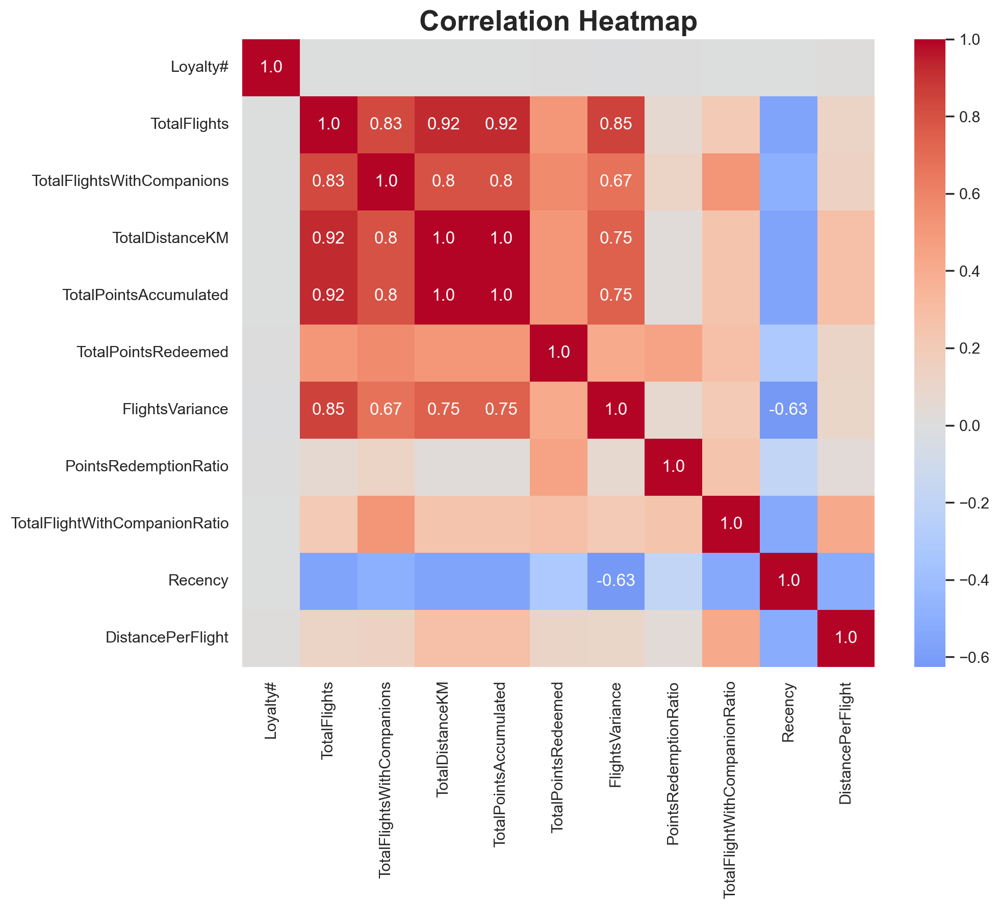

In [179]:
# Compute correlation matrix
corr = flightsDB_new.corr()

# Mask values < 0.5
mask_annot = np.abs(corr.values) >= 0.6
annot = np.where(mask_annot, np.round(corr.values, 2), "")

# Plot
plt.figure(figsize=(10, 8))
sns.heatmap(data=corr, annot=annot, fmt="", center=0, cmap="coolwarm")
plt.title("Correlation Heatmap", fontsize=20, fontweight="bold")
plt.show()


With this correlation matrix, we see that there are lots of redundant features and so, **we decided to keep only the following features:**

- `PointsRedemptionRatio`

- `TotalFlightWithCompanionRatio`

- `Recency`

- `DistancePerFlight`

We decided right away to drop the features related to the total values per customer and use them solely for calculations of other features since they all have high correlations between themselves. Only 'TotalPointsRedeemed' showed a lower correlation, but we dropped it as well since it had moderate correlation with the previous ones and 'PointsRedemptionRatio' whereas this displays much more valuable information.

'FlightsVariance' and 'Recency' also showed high negative correlation and we decided to keep only 'Recency' since its values are easier to interpret.

<a class="anchor" id="9_2">

## **9.2.** CustomerDB

[Back to TOC](#toc)
</a>

We have decided to add the following features to help us segment the customers later on.
- `IncomeBins:` Groups customers into discrete income categories ranging from low to very high. We divided this into 4 groups, each representing 20% of the dataset, one being very low since we saw there are a lot of customers with 0 income.

- `HouseholdType:` Combined indicator describing both marital status and location type of the customer.

- `MonthsSinceEnrollment:` Number of months since the customer joined the loyalty program.

- `CLVBins:` Categorizes customers into five groups based on their Customer Lifetime Value (CLV), from lowest to highest. Again, each group represents 20% of the dataset.

- `CLVvsCityMean`: Difference between the customer’s CLV and the average CLV for their city.

For the creation of the bins, we decided to do it with equal parts of the dataset because our goal is to analyse and segment the current data we have. It is not important if the bins represent realistic values in the real world since this is all the data we will be working with.


In [180]:
# Create expanded dataset
customerDB_expanded = customerDB.copy()
customerDB_new = pd.DataFrame()

# Convert enrollment and cancellation dates to datetime
customerDB['EnrollmentDateOpening'] = pd.to_datetime(customerDB_expanded['EnrollmentDateOpening'], errors='coerce')


## INCOME BINS
# Fill NaNs temporarily with -1
income_nonan = customerDB_expanded['Income'].fillna(-1)

# Compute quartiles
try:
    temp_bins = pd.qcut(income_nonan, q=4, duplicates='drop')
    bins_labels = ['Very Low', 'Low', 'Medium', 'High'][:len(temp_bins.cat.categories)]
    customerDB_expanded['IncomeBins'] = pd.qcut(
        income_nonan,
        q=4,
        labels=bins_labels,
        duplicates='drop'
    )
    # Replace the -1 bin with 'Unknown'
    customerDB_expanded['IncomeBins'] = customerDB_expanded['IncomeBins'].cat.add_categories(['Unknown'])
    customerDB_expanded.loc[income_nonan == -1, 'IncomeBins'] = 'Unknown'
except ValueError:
    customerDB_expanded['IncomeBins'] = pd.Series(['Unknown']*len(customerDB_expanded))



# HouseholdType → Marital + Location
customerDB_expanded['HouseholdType'] = (
    customerDB_expanded['Location Code'].fillna('Unknown') + '-' +
    customerDB_expanded['Marital Status'].fillna('Unknown')
)


# MonthsSinceEnrollment
reference_date = pd.Timestamp.today()
customerDB_expanded['MonthsSinceEnrollment'] = (
    (reference_date - customerDB['EnrollmentDateOpening']).dt.days / 30
).fillna(0).clip(lower=0)


# IsActive
customerDB_expanded['IsActive'] = customerDB_expanded['CancellationDate'].isna().astype(int)


# Fill NaNs temporarily with -1
clv_nonan = customerDB_expanded['Customer Lifetime Value'].fillna(-1)

## CLV BINS
# Compute quartiles
try:
    temp_bins = pd.qcut(clv_nonan, q=5, duplicates='drop')
    clv_labels = ["Very Low", "Low", "Medium", "High", "Very High"][:len(temp_bins.cat.categories)]
    customerDB_expanded['CLVBins'] = pd.qcut(
        clv_nonan,
        q=5,
        labels=clv_labels,
        duplicates='drop'
    )
    # Replace the -1 bin with 'Unknown'
    customerDB_expanded['CLVBins'] = customerDB_expanded['CLVBins'].cat.add_categories(['Unknown'])
    customerDB_expanded.loc[clv_nonan == -1, 'CLVBins'] = 'Unknown'
except ValueError:
    customerDB_expanded['CLVBins'] = pd.Series(['Unknown']*len(customerDB_expanded))


# ---  CLV vs City Mean ---
customerDB_expanded['CLVvsCityMean'] = (
    customerDB_expanded['Customer Lifetime Value'] - customerDB_expanded.groupby('City')['Customer Lifetime Value'] \
    .transform('mean')
)

# Copy new columns to customerDB_new
cols_to_copy = [
    'IncomeBins',
    'HouseholdType',
    'MonthsSinceEnrollment',
    'IsActive',
    'CLVBins',
    'CLVvsCityMean'
]

customerDB_new[cols_to_copy] = customerDB_expanded[cols_to_copy]

# Preview result
customerDB_expanded.describe(include='all').T


,count,unique,top,freq,mean,std,min,25%,50%,75%,max
First Name,16921,4941,Deon,13,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Last Name,16921,15404,Salberg,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Customer Name,16921,16921,Cecilia Householder,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Country,16921,1,Canada,16921,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Province or State,16921,11,Ontario,5468,NaN,NaN,NaN,NaN,NaN,NaN,NaN
City,16921,29,Toronto,3390,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Latitude,16921.0,NaN,NaN,NaN,47.1745,3.307971,42.984924,44.231171,46.087818,49.28273,60.721188
Longitude,16921.0,NaN,NaN,NaN,-91.814768,22.242429,-135.05684,-120.23766,-79.383186,-74.596184,-52.712578
Postal code,16921,75,V6E 3D9,917,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Gender,16921,2,female,8497,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<a class="anchor" id="9_2_1">

### **9.2.1** Selecting Created Features
[Back to TOC](#toc)
</a>

See if it makes sense to keep aall created features.

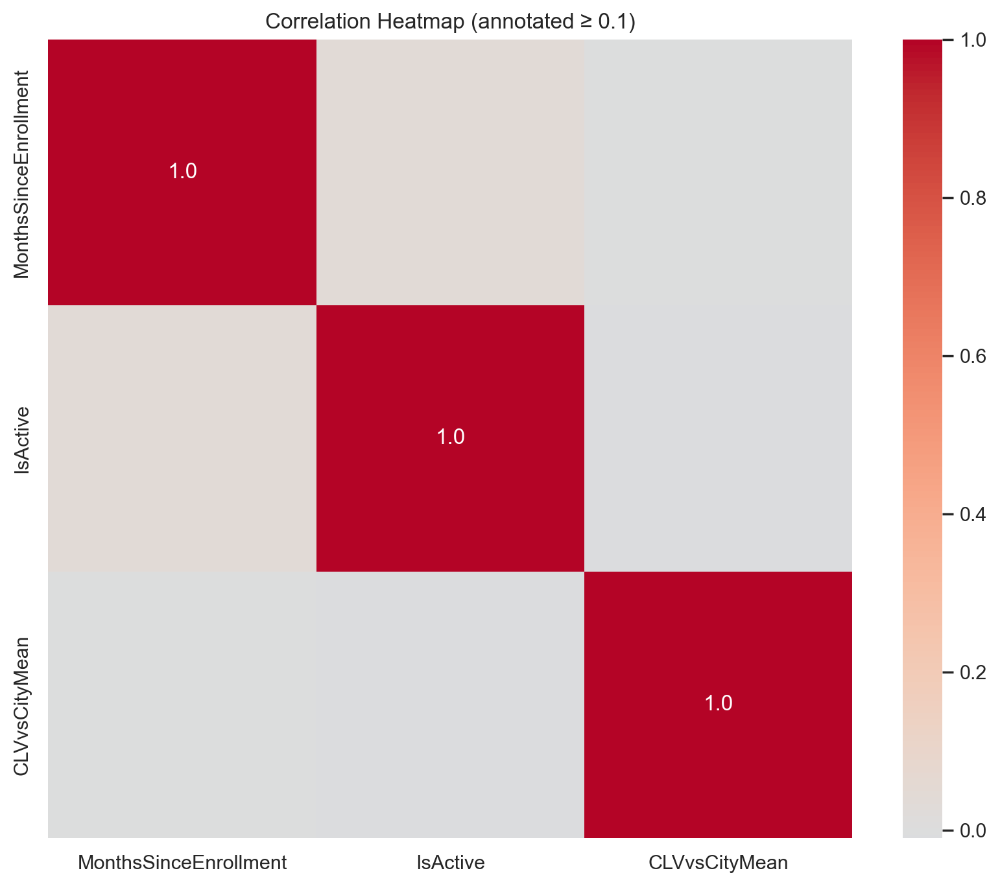

In [181]:
customerDB_new_cont = customerDB_new.select_dtypes(include=[np.number])

# Compute correlation matrix
corr = customerDB_new_cont.corr()

# Mask values > 0.6
mask_annot = np.abs(corr.values) >= 0.6
annot = np.where(mask_annot, np.round(corr.values, 2), "")

# Plot
plt.figure(figsize=(10, 8))
sns.heatmap(data=corr, annot=annot, fmt="", center=0, cmap="coolwarm")
plt.title("Correlation Heatmap (annotated ≥ 0.1)")
plt.show()


Since the correlation between all the numeric features is very low, we have decided to keep them all.

<a class="anchor" id="9_3">

## **9.3.** Feature Engineering with Merged Datasets

[Back to TOC](#toc)
</a>

<a class="anchor" id="9_3_1">

### **9.3.1** Merge Datasets
[Back to TOC](#toc)
</a>


In [182]:
# Create a second expanded flightsDB, keeping only one row per customer with aggregated features
flightsDB_expanded = flightsDB.merge(flightsDB_new, on='Loyalty#', how='right')

# Merge customerDB_expanded with flightsDB_expanded on Loyalty#
dfs_merged = customerDB_expanded.join(flightsDB_expanded, on="Loyalty#", how="left")

# Fill only numeric columns with 0
num_cols = dfs_merged.select_dtypes(include=['number']).columns
dfs_merged[num_cols] = dfs_merged[num_cols].fillna(0)

# Keep categorical NA values untouched

<a class="anchor" id="9_3_2">

### **9.3.2** Add Features
[Back to TOC](#toc)
</a>


We have decided to add the following features to help us segment the customers later on.
- `FlightsPerMonthOfMembership:` Average number of flights a customer takes per month of membership. Calculated as TotalFlights / MonthsSinceEnrollment. Captures travel frequency relative to how long the customer has been in the program.

- `DistancePerCLV:` Total distance traveled by the customer normalized by their Customer Lifetime Value (CLV). Calculated as TotalDistanceKM / Customer Lifetime Value. Helps identify high-travel customers relative to their monetary value.

- `PointsRedeemedPerTotalCLV:` Loyalty points redeemed per dollar of CLV. Calculated as TotalPointsRedeemed / Customer Lifetime Value. Shows engagement efficiency in terms of spending vs. earned value.

- `RedemptionRateByLoyaltyStatus:` Customer’s points redemption relative to the average points redeemed for their loyalty tier. Calculated as TotalPointsRedeemed / mean(TotalPointsRedeemed per LoyaltyStatus). Captures how actively customers in a tier redeem points compared to peers.

- `DistanceTraveledByEducationLevel:` Customer’s total distance traveled relative to the average distance for their education level. Calculated as TotalDistanceKM / mean(TotalDistanceKM per Education group). Helps understand travel behavior patterns by education segment.


In [183]:
# Defensive helper for zero-division
def safe_div(numerator, denominator):
    return (numerator / denominator).replace([np.inf, -np.inf], 0).fillna(0)

# Flights per year of membership
dfs_merged["FlightsPerYearOfMembership"] = safe_div(
    dfs_merged["TotalFlights"],
    dfs_merged["MonthsSinceEnrollment"] / 12
)

# Distance per CLV
dfs_merged["DistancePerCLV"] = safe_div(
    dfs_merged["TotalDistanceKM"],
    dfs_merged["Customer Lifetime Value"]
)

# Points redeemed per CLV dollar
dollar_redeemed = flightsDB.groupby('Loyalty#')['DollarCostPointsRedeemed'].sum()
dfs_merged["PointsRedeemedPerCLVDollar"] = safe_div(
    dfs_merged["TotalPointsRedeemed"],
    dfs_merged.index.map(dollar_redeemed)
)

# Redemption rate by loyalty status
loyalty_points_mean = dfs_merged.groupby("LoyaltyStatus")["TotalPointsRedeemed"].transform("mean")
dfs_merged["RedemptionRateByLoyaltyStatus"] = safe_div(
    dfs_merged["TotalPointsRedeemed"],
    loyalty_points_mean
)

# Distance traveled by education level
edu_distance_mean = dfs_merged.groupby("Education")["TotalDistanceKM"].transform("mean")
dfs_merged["DistanceTraveledByEducationLevel"] = safe_div(
    dfs_merged["TotalDistanceKM"],
    edu_distance_mean
)

# Preview
dfs_merged.describe().T

,count,mean,min,25%,50%,75%,max,std
Latitude,16921.0,47.1745,42.984924,44.231171,46.087818,49.28273,60.721188,3.307971
Longitude,16921.0,-91.814768,-135.05684,-120.23766,-79.383186,-74.596184,-52.712578,22.242429
Income,16921.0,37713.409787,0.0,0.0,34112.0,62375.0,99981.0,30378.754775
Customer Lifetime Value,16921.0,7981.015757,0.0,3971.35,5771.61,8936.82,83325.38,6864.608367
MonthsSinceEnrollment,16921.0,86.219674,46.833333,64.8,85.366667,107.1,131.133333,23.965966
IsActive,16921.0,0.863483,0.0,1.0,1.0,1.0,1.0,0.343347
CLVvsCityMean,16921.0,0.0,-6767.170102,-3996.415625,-2142.902095,962.220831,75236.176746,6853.83106
Loyalty#,16921.0,550197.393771,100011.0,326823.0,550896.0,772438.0,999999.0,259251.503597
Year,16921.0,1141.979138,0.0,0.0,2019.0,2020.0,2021.0,1001.376131
Month,16921.0,3.667809,0.0,0.0,2.0,7.0,12.0,4.144635


<a class="anchor" id="9_3_3">

### **9.3.3** Select Created Features
[Back to TOC](#toc)
</a>

Analyse if it makes sense to keep all the features

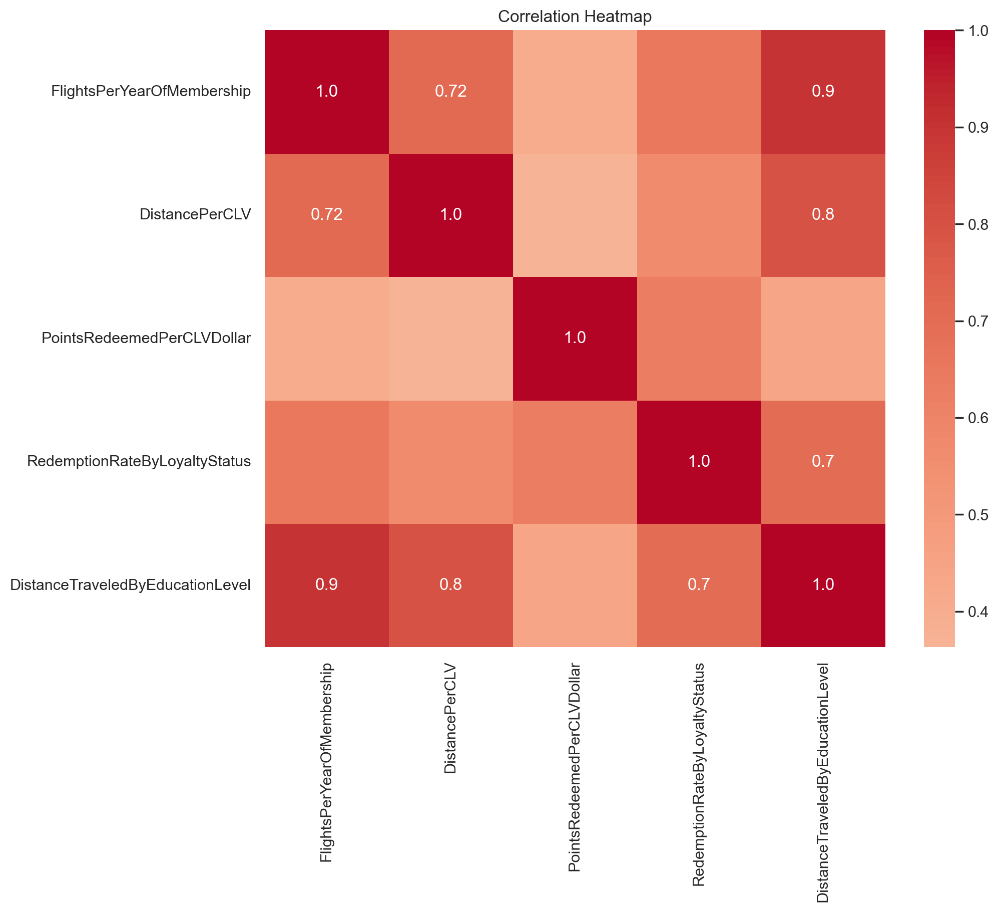

In [184]:
dfs_merged_new = dfs_merged[['FlightsPerYearOfMembership', 
                             'DistancePerCLV', 
                             'PointsRedeemedPerCLVDollar', 
                             'RedemptionRateByLoyaltyStatus', 
                             'DistanceTraveledByEducationLevel']]

# Compute correlation matrix
corr = dfs_merged_new.corr()

# Mask values
mask_annot = np.abs(corr.values) >= 0.7
annot = np.where(mask_annot, np.round(corr.values, 2), "")

# Plot
plt.figure(figsize=(10, 8))
sns.heatmap(data=corr, annot=annot, fmt="", center=0, cmap="coolwarm")
plt.title("Correlation Heatmap")
plt.show()


Analysing the correlation matrix:
- `FlightsPerYearOfMembership & DistanceTraveledByEducationLevel (0.9):`This is a very strong correlation. Likely, customers who fly more also travel longer distances, and education level might be correlated with flying habits possibly because frequent flyers are often business travelers.

- `DistancePerCLV & DistanceTraveledByEducationLevel (0.8):` Customers with higher travel distances for their CLV also have higher distances associated with their education level, suggesting a socioeconomic influence on travel patterns once again.

- `FlightsPerYearOfMembership & DistancePerCLV & DistanceTraveledByEducationLevel:` All three combinations reinforce that flight frequency, travel distance, and socioeconomic status are interlinked, likely capturing overlapping behavioral patterns in high-value customer groups.

- `FlightsPerYearOfMembership & DistancePerCLV (0.72):` Frequent fliers are likely to accumulate greater distance per unit of customer lifetime value (CLV).

- `RedemptionRateByLoyaltyStatus & DistanceTraveledByEducationLevel (0.7):` Higher educational status may correlate with strategic redemption, as well-educated customers could be more aware of program benefits and optimize point/redemption behavior.

To conclude, we chose to **keep only FlightsPerYearOfMembership and RedemptionRateByLoyaltyStatus.**

In [185]:
dfs_merged = dfs_merged.drop(columns=[
    'DistancePerCLV',
    'PointsRedeemedPerCLVDollar',
    'DistanceTraveledByEducationLevel'])

dfs_merged_new = dfs_merged_new.drop(columns=[
    'DistancePerCLV',
    'PointsRedeemedPerCLVDollar',
    'DistanceTraveledByEducationLevel'])

dfs_merged_new.columns

Index(['FlightsPerYearOfMembership', 'RedemptionRateByLoyaltyStatus'], dtype='object')

<a class="anchor" id="9_4">

## **9.4.** Summary of Engineered Features

[Back to TOC](#toc)
</a>

To summarise, we chose to keep:

FLIGHTSDB

- `PointsRedemptionRatio`
- `TotalFlightWithCompanionRatio`
- `Recency`
- `DistancePerFlight`

CUSTOMERSDB

- `IncomeBins`
- `HouseholdType`
- `MonthsSinceEnrollment`
- `CLVBins`
- `CLVvsCityMean`

MERGED DATASETS

- `FlightsPerYearOfMembership`
- `RedemptionRateByLoyaltyStatus`

<a class="anchor" id="10">

# **10. Engineered Features' Visualisations**

[Back to TOC](#toc)
</a>

<a class="anchor" id="10_1">

## **10.1.** FlightsDB

[Back to TOC](#toc)
</a>

Update flightsDB_new with only the features that we kept.

In [186]:
flightsDB_new = flightsDB_new.drop(columns=[
    'TotalFlights',
    'TotalFlightsWithCompanions',
    'TotalDistanceKM',
   'TotalPointsAccumulated'
], errors='ignore')

flightsDB_new.head()

,Loyalty#,TotalPointsRedeemed,FlightsVariance,PointsRedemptionRatio,TotalFlightWithCompanionRatio,Recency,DistancePerFlight
0,100018,20562.8,21.338944,0.387873,0.214876,0,2306.350587
1,100102,18760.6,27.233611,0.553345,0.234962,0,1369.053694
2,100140,4896.0,24.899492,0.113353,0.250000,1,1992.761993
3,100214,12908.6,16.253611,0.354109,0.175423,0,3246.675868
4,100272,10891.4,32.355492,0.253564,0.284871,1,2304.884657


<p style="font-size:24px;">Histograms</p>

Create feature with all engineered features and another one with just the continuous ones.

In [187]:
flightsDB_new_cont = flightsDB_new[['PointsRedemptionRatio','TotalFlightWithCompanionRatio','Recency', 'DistancePerFlight']]
flightsDB_new_cont.head()

,PointsRedemptionRatio,TotalFlightWithCompanionRatio,Recency,DistancePerFlight
0,0.387873,0.214876,0,2306.350587
1,0.553345,0.234962,0,1369.053694
2,0.113353,0.250000,1,1992.761993
3,0.354109,0.175423,0,3246.675868
4,0.253564,0.284871,1,2304.884657


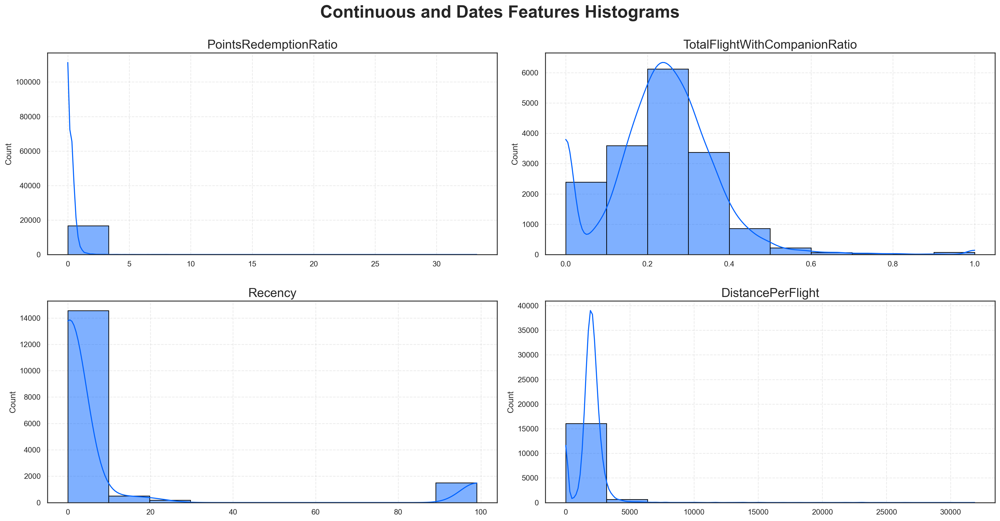

In [188]:
#To plot histograms we will use continuous and date features that were identified before

# Set minimal style
sns.set_style("white") # increase contrast

# Create a canvas for the metric features
fig, axes = plt.subplots(2, # set number of rows
                         2, 
                         figsize=(20, 10),
                         constrained_layout=True) # Adjust automatically spacing between subplot and labels 

# Increase vertical space between rows
fig.set_constrained_layout_pads(h_pad=.2)

# Plot the data
# Iterate across axes objects and associate each histogram:
for ax, feat in zip(axes.flatten(), flightsDB_new_cont):
    sns.histplot(flightsDB_new[feat],
                 bins=10,
                 kde=(feat in flightsDB_new_cont), #smooth line only for continuous features
                 ax=ax,
                 color="#0062FF",
                 edgecolor="black")
    ax.set_title(feat, fontsize=18)
    ax.grid(True, linestyle="--", alpha=0.4)
    ax.set_xlabel("")

# Layout
# Add title, make it bigger and bold and add space between title and first row of plots
plt.suptitle("Continuous and Dates Features Histograms", 
             fontsize = 25, fontweight="bold", y=1.05)

# Create the folder '../figures/eda' if it doesn't already exist
os.makedirs(os.path.join('..', 'figures', 'eda'), exist_ok=True)
    
# Save figure to a png file in the folder created before
plt.savefig(os.path.join('..', 'figures', 'eda', 'numeric_features_histograms.png'), dpi=200)

# Show plot
plt.show()

- `PointsRedemptionRatio:` Most customers redeem a small fraction of their points, with the distribution sharply skewed toward low ratios and very few high redeemers present.
- `TotalFlightWithCompanionRatio:` The majority of travelers have low companion ratios, concentrating around 0.2–0.3, but a small minority frequently travel with companions.
- `Recency:` Customer activity is heavily biased towards recent periods, though a distant subgroup has not transacted for a long time, suggesting few inactive accounts among many actives.
- `DistancePerFlight:` Most customers take short flights, but the distribution has a pronounced long tail, revealing a smaller group often undertaking much longer journeys.

<p style="font-size:24px;">Boxplot</p>

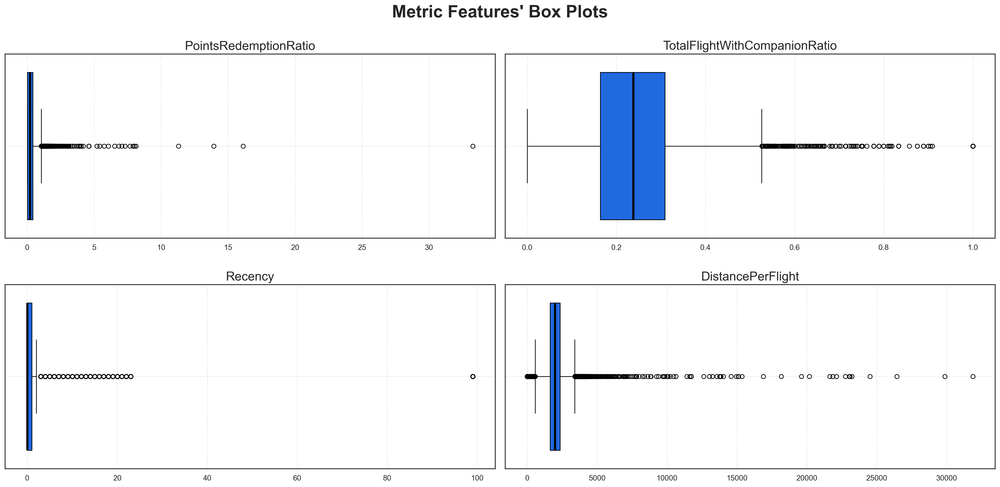

In [189]:
# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(2, 
                         2, 
                         figsize=(20, 10),
                         constrained_layout=True) # Adjust automatically spacing between subplot and labels 

# Increase vertical space between rows
fig.set_constrained_layout_pads(h_pad=.2)

# Plot data
# Iterate across axes objects and associate each box plot:
for ax, feat in zip(axes.flatten(), flightsDB_new_cont): 
    sns.boxplot(x=flightsDB_new_cont[feat], ax=ax,
                # Set inside color to blue
                color="#0062FF",
                # Set line colors to black
                boxprops=dict(edgecolor="black"),
                whiskerprops=dict(color="black"),
                capprops=dict(color="black"),
                medianprops=dict(color="black", linewidth=3),
                flierprops=dict(markeredgecolor="black"))
    
    # Put grid with low opacity and dashed line so it's visible, but not distracting
    ax.grid(True, linestyle="--", alpha=0.4)

    # Put title of each graph with bigger font
    ax.set_title(feat, fontsize=18)

    # Hide x label since we already have the boxlplot title at the top
    ax.set_xlabel("")
    
# Layout
# Add title and make it bigger
plt.suptitle("Metric Features' Box Plots", 
             fontsize = 25, fontweight="bold")

# Create the folder '../figures/eda' if it doesn't already exist
os.makedirs(os.path.join('..', 'figures', 'eda'), exist_ok=True)

# Save figure to a png file in the folder created before
plt.savefig(os.path.join('..', 'figures', 'eda', 'numeric_features_boxplots.png'), dpi=200)

# Show plot
plt.show()

From the boxplots we take these conclusions:
- `PointsRedemptionRatio:` The redemption ratio is tightly concentrated between 0 and 1 for most, though there are several outliers redeeming more points than the ones that were accumulated. This is an error in the data that might be costly to the company.

- `TotalFlightWithCompanionRatio:` The majority of customers have a companion ratio between 0.1 and 0.3, with a few extreme outliers close to 1, showing that only a small subset consistently flies with companions.​

- `Recency:` Most customers have low recency scores, suggesting frequent engagement, but a substantial tail with large values reveals a segment of rarely active or lapsed users.​

- `DistancePerFlight:` Short-haul flights dominate, yet several significant outliers travel over 10,000 km per flight, indicating a distinct group of long-distance travelers within the customer base.

<p style="font-size:24px;">Scatter Plots</p>

To assess correlation, we have selected a few pairs of features that we thought could bring additional insights. 

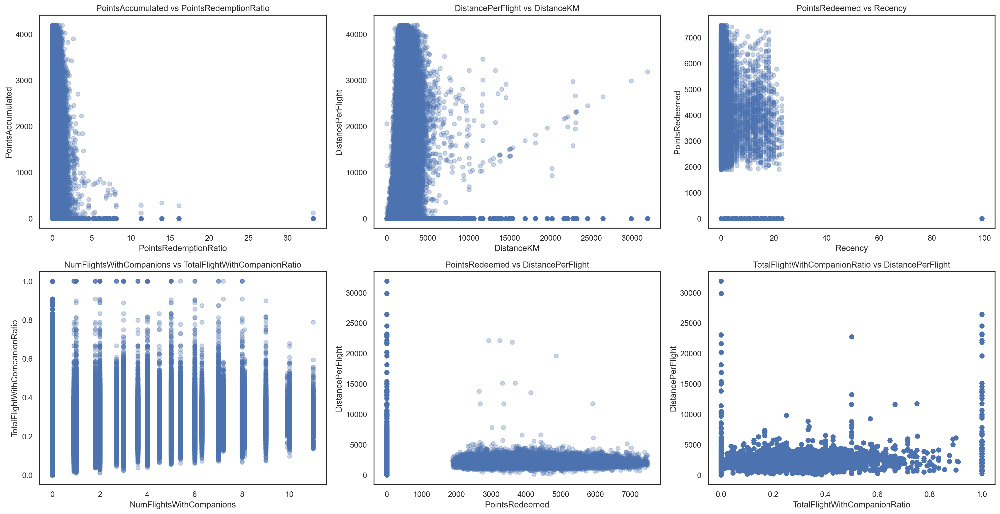

In [190]:
# Scatterplots for selected pairs
plt.figure(figsize=(20, 15))

# 1. PointsAccumulated vs PointsRedemptionRatio
plt.subplot(3, 3, 1)
plt.scatter(flightsDB_expanded["PointsRedemptionRatio"], flightsDB_expanded["PointsAccumulated"], alpha=0.3)
plt.title("PointsAccumulated vs PointsRedemptionRatio")
plt.xlabel("PointsRedemptionRatio")
plt.ylabel("PointsAccumulated")

# 2. DistanceKM vs DistancePerFlight
plt.subplot(3, 3, 2)
plt.scatter(flightsDB_expanded["DistancePerFlight"], flightsDB_expanded["DistanceKM"], alpha=0.3)
plt.title("DistancePerFlight vs DistanceKM")
plt.xlabel("DistanceKM")
plt.ylabel("DistancePerFlight")

# 3. PointsRedeemed vs Recency
plt.subplot(3, 3, 3)
plt.scatter(flightsDB_expanded["Recency"], flightsDB_expanded["PointsRedeemed"], alpha=0.3)
plt.title("PointsRedeemed vs Recency")
plt.xlabel("Recency")
plt.ylabel("PointsRedeemed")

# 4. NumFlightsWithCompanions vs TotalFlightWithCompanionRatio
plt.subplot(3, 3, 4)
plt.scatter(flightsDB_expanded["NumFlightsWithCompanions"], flightsDB_expanded["TotalFlightWithCompanionRatio"], alpha=0.3)
plt.title("NumFlightsWithCompanions vs TotalFlightWithCompanionRatio")
plt.xlabel("NumFlightsWithCompanions")
plt.ylabel("TotalFlightWithCompanionRatio")

# 5. PointsRedeemed vs DistancePerFlight
plt.subplot(3, 3, 5)
plt.scatter(flightsDB_expanded["PointsRedeemed"], flightsDB_expanded["DistancePerFlight"], alpha=0.3)
plt.title("PointsRedeemed vs DistancePerFlight")
plt.xlabel("PointsRedeemed")
plt.ylabel("DistancePerFlight")

# 6. DistancePerFlight vs TotalFlightWithCompanionRatio
plt.subplot(3, 3, 6)
plt.scatter(flightsDB_expanded["TotalFlightWithCompanionRatio"], flightsDB_expanded["DistancePerFlight"], alpha=0.3)
plt.title("TotalFlightWithCompanionRatio vs DistancePerFlight")
plt.xlabel("TotalFlightWithCompanionRatio")
plt.ylabel("DistancePerFlight")

plt.tight_layout()
plt.show()


Conclusions:
- `PointsAccumulated vs PointsRedemptionRatio:` It is difficult to take any conclusions, but we can see that customers who accumulate the most points have slightly lower redemption ratios than the ones that do not accumulate as much.

- `DistancePerFlight vs DistanceKM:` Again, there are not many conclusions to take, but we can see a light linear correlation between the two features for a small number of observations.

- `PointsRedeemed vs Recency:` Most point redemptions occur among recently active customers, but there is a segment with high redemption and long recency, indicating potentially lapsed users.

- `NumFlightsWithCompanions vs TotalFlightWithCompanionRatio:` Ratios stay in between 0.1 and 0.6 for most observations, regardless of the number of flights, but for customers with low numbers of flights the ratio tends to be higher.

- `PointsRedeemed vs DistancePerFlight:` Higher point redeemers may be associated with smaller distances per flight, indicating points are more often used on small-distance journeys.

- `TotalFlightWithCompanionRatio vs DistancePerFlight:` The companion ratio does not strongly predict flight distance, but there are groups who both travel together and take longer trips.

<a class="anchor" id="10_2">

## **10.2.** CustomerDB

[Back to TOC](#toc)
</a>

<p style="font-size:24px;">Histograms</p>

We will compare the new metric features MonthsSinceEnrollment and CLVvsCityMean.

In [191]:
customerDB_new_cont = customerDB_new.select_dtypes(include=[np.number]).drop(columns=['IsActive'])
customerDB_new_categ = customerDB_new[['IncomeBins', 'HouseholdType', 'CLVBins', 'IsActive']]

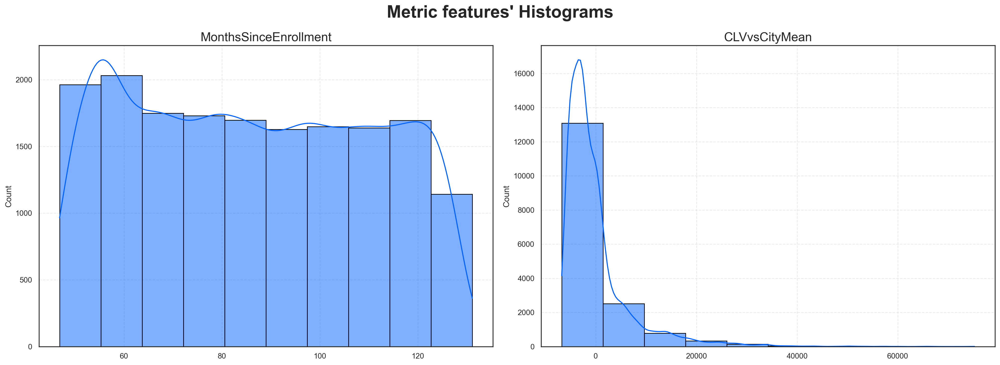

In [192]:
# Set number of rows and columns
sp_rows_CDB_new = 1
sp_cols_CDB_new = 2

# Set style
sns.set_style("white") # increase contrast

# Create figure
fig, axes = plt.subplots(sp_rows_CDB_new,
                         sp_cols_CDB_new,
                         figsize=(20, 7),
                         constrained_layout=True)

# Additional spacing between rows
fig.set_constrained_layout_pads(h_pad=.2)

# Plot data
for ax, feat in zip(axes.flatten(), customerDB_new_cont):
    
    sns.histplot(customerDB_new_cont[feat],
                 bins=10,
                 kde=(feat in customerDB_new_cont.columns), #smooth line only for continuous features
                 ax=ax,
                 color="#0062FF",
                 edgecolor="black")
    
    ax.set_title(feat, fontsize=18)
    ax.grid(True, linestyle="--", alpha=0.4)
    ax.set_xlabel("")

# Global title
plt.suptitle("Metric features' Histograms",
             fontsize=25,
             fontweight="bold",
             y=1.05)

# Save figure
os.makedirs(os.path.join('..', 'figures', 'eda'), exist_ok=True)
fig.savefig(os.path.join('..', 'figures', 'eda', 'customerDB_new_features.png'),
            dpi=200)

# display output
plt.show()


Conclusions:

- `MonthsSinceEnrollment:` Customer tenure is evenly distributed with most customers enrolled between 50 and 130 months ago, indicating a stable acquisition rate over time and no heavy skew toward new or old members.

- `CLVvsCityMean:` The majority of customers have a customer lifetime value (CLV) near their city’s average, but there is a pronounced long tail showing a small segment with dramatically higher CLV than the norm, highlighting valuable outliers.

<p style="font-size:24px;">Boxplots</p>

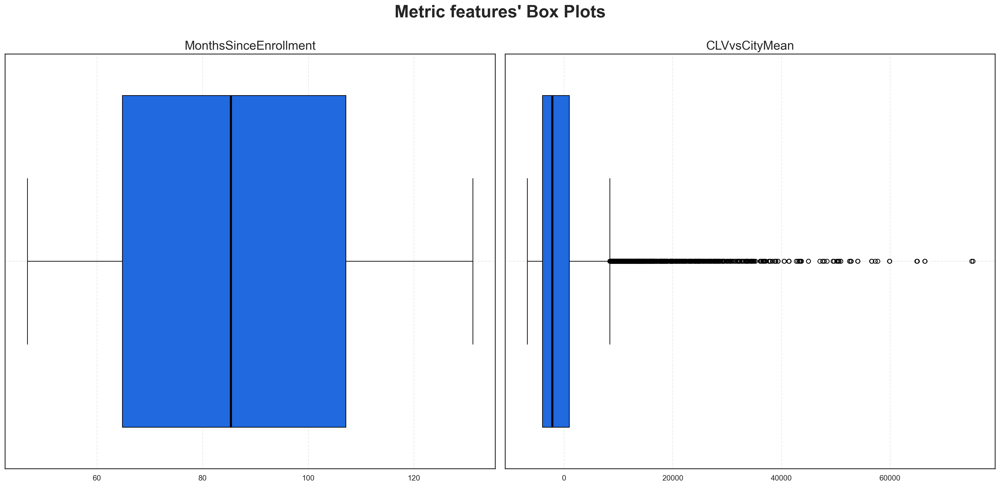

In [193]:
# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(sp_rows_CDB_new, 
                         sp_cols_CDB_new, 
                         figsize=(20, 10),
                         constrained_layout=True) # Adjust automatically spacing between subplot and labels 

# Increase vertical space between rows
fig.set_constrained_layout_pads(h_pad=.2)

# Plot data
# Iterate across axes objects and associate each box plot:
for ax, feat in zip(axes.flatten(), customerDB_new_cont):
    sns.boxplot(x=customerDB_new_cont[feat].reset_index(drop=True), ax=ax,
                color="#0062FF",
                boxprops=dict(edgecolor="black"),
                whiskerprops=dict(color="black"),
                capprops=dict(color="black"),
                medianprops=dict(color="black", linewidth=3),
                flierprops=dict(markeredgecolor="black"))

    
    # Put grid with low opacity and dashed line so it's visible, but not distracting
    ax.grid(True, linestyle="--", alpha=0.4)

    # Put title of each graph with bigger font
    ax.set_title(feat, fontsize=18)

    # Hide x label since we already have the boxlplot title at the top
    ax.set_xlabel("")
    
# Layout
# Add title and make it bigger
plt.suptitle("Metric features' Box Plots", 
             fontsize = 25, fontweight="bold")

# Create the folder '../figures/eda' if it doesn't already exist
os.makedirs(os.path.join('..', 'figures', 'eda'), exist_ok=True)

# Save figure to a png file in the folder created before
plt.savefig(os.path.join('..', 'figures', 'eda', 'numeric_features_boxplots.png'), dpi=200)

# Show plot
plt.show()

Conclusions:
- `MonthsSinceEnrollment:` The distribution is symmetric with minimal outliers, indicating most customers have been enrolled for a similar span, and tenure is not heavily skewed by extreme cases.
- `CLVvsCityMean:` The box plot reveals a strong right skew with numerous high-value outliers, showing that while most customers are near their city’s CLV mean, a few have much higher CLV, standing far apart from the main group.

<p style="font-size:24px;">Bar Plots</p>

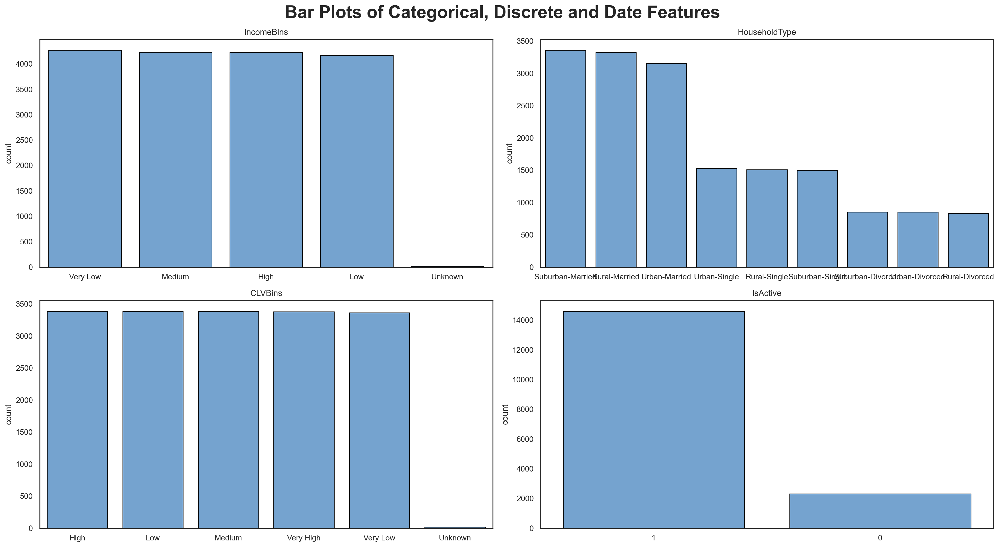

In [194]:
# To do bar plots we use Categorical + Discrete features + dates features

sns.set(style="white")

fig, axes = plt.subplots(2, 2, figsize=(20, 11))

for ax, feat in zip(axes.flatten(), customerDB_new_categ):
    sns.countplot(x=customerDB_new_categ[feat], ax=ax, 
                  order=customerDB_new_categ[feat].value_counts().index, color="#66a4de", edgecolor="black") 
    ax.set_title(feat)
    ax.set_xlabel('') # Remove x-axis label for clarity

plt.suptitle("Bar Plots of Categorical, Discrete and Date Features", fontsize=25, fontweight="bold")
plt.tight_layout() # Adjust spacing to prevent overlap
plt.show()

Conclusions:
- `IncomeBins:` Income is evenly distributed across all bins except 'Unknown,' which is much less frequent, suggesting successful segmentation and few missing values.
- `HouseholdType:` Married households, especially in suburban and rural settings, dominate the dataset, while divorced and single households are less common.
- `CLVBins:` The customer base is evenly segmented across CLV bins except 'Unknown,' indicating balanced customer value groups and minimal missing data.
- `IsActive:` The majority of customers are active, with a far smaller group of inactive users, highlighting a generally engaged customer population.

<p style="font-size:24px;">Comparing New Categorical Features</p>

We will compare these new categorical features: IncomeBins, HouseholdType and CLVBins.

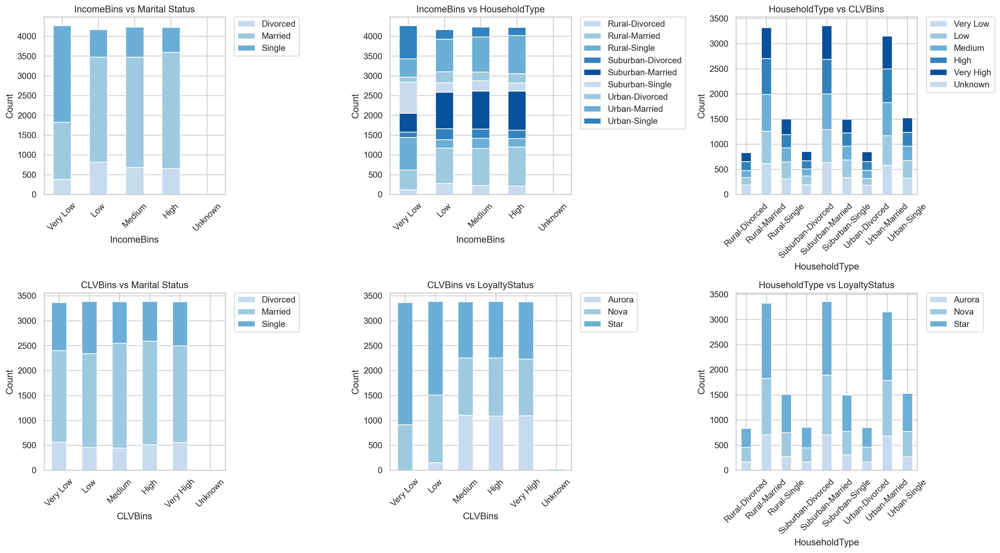

In [195]:
# Style setting
sns.set(style="whitegrid")

# Generate all 2-way combinations
pairs_to_plot = [
    ('IncomeBins', 'Marital Status'),
    ('IncomeBins', 'HouseholdType'),
    ('HouseholdType', 'CLVBins'),
    ('CLVBins', 'Marital Status'),
    ('CLVBins', 'LoyaltyStatus'),
    ('HouseholdType', 'LoyaltyStatus'),
]

# Create figure with subplots
fig, axes = plt.subplots(2, 3 , figsize=(18, 10))
axes = axes.flatten()

# Generate a plot for each pair
for i, (x, y) in enumerate(pairs_to_plot):
    pd.crosstab(dfs_merged[x], dfs_merged[y]).plot(kind='bar', stacked=True, ax=axes[i], color=['#c6dbef', '#9ecae1', '#6baed6', '#3182bd', '#08519c'])
    axes[i].set_title(f"{x} vs {y}")
    axes[i].set_xlabel(x)
    axes[i].set_ylabel("Count")
    axes[i].tick_params(axis='x', rotation=45)
    axes[i].legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

    

# Delete unused subplots
for j in range(10, len(axes)):
    fig.delaxes(axes[j]) 
    
plt.tight_layout()
plt.show()

Conclusions:
- `IncomeBins vs Marital Status:` Across most income bins, married customers consistently represent the largest segment, except for the 'Very Low' bin, which probably represents the younger customers. Singles and divorced are each a smaller but steady proportion except for the first bin, indicating marital status is relatively independent of income tier.

- `IncomeBins vs HouseholdType:` Regardless of income group, suburban-married and rural-married households are dominant, while single and divorced types, especially in urban and suburban settings, are much less frequent.

- `HouseholdType vs CLVBins:` In terms of frequency, high and very high CLV categories are most associated with married households (especially rural and suburban), confirming their value. However, in relative terms, the CLV bins are equally distributed in all household types.

- `CLVBins vs Marital Status:` Higher CLV bins have a slightly greater share of married customers, while single and divorced customers are distributed more evenly across value tiers.

- `CLVBins vs LoyaltyStatus:` Aurora and Nova loyalty statuses become more prevalent in higher CLV bins, suggesting that highly valuable customers are also likely to hold premium loyalty tiers.

- `HouseholdType vs LoyaltyStatus:` The Loyalty Status distributions are constant through all the Household Types, the differences being very minimal.

<a class="anchor" id="10_3">

## **10.3.** Merged Datasets

[Back to TOC](#toc)
</a>

We only created numeric features for merged datasets.

<p style="font-size:24px;">Histograms</p>

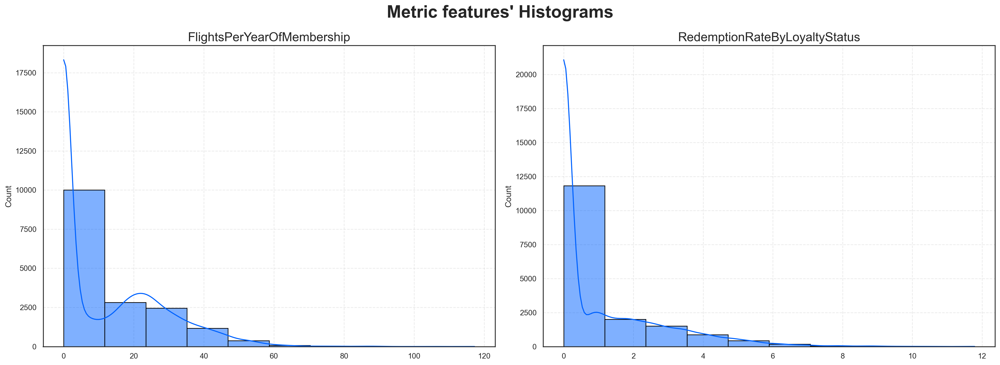

In [196]:
# Set number of rows and columns
sp_rows_merged = 1
sp_cols_merged = 2

# Set style
sns.set_style("white") # increase contrast

# Create figure
fig, axes = plt.subplots(sp_rows_merged,
                         sp_cols_merged,
                         figsize=(20, 7),
                         constrained_layout=True)

# Additional spacing between rows
fig.set_constrained_layout_pads(h_pad=.2)

# Plot data
for ax, feat in zip(axes.flatten(), dfs_merged_new):
    
    sns.histplot(dfs_merged_new[feat],
                 bins=10,
                 kde=(feat in dfs_merged_new.columns), #smooth line only for continuous features
                 ax=ax,
                 color="#0062FF",
                 edgecolor="black")
    
    ax.set_title(feat, fontsize=18)
    ax.grid(True, linestyle="--", alpha=0.4)
    ax.set_xlabel("")

# Global title
plt.suptitle("Metric features' Histograms",
             fontsize=25,
             fontweight="bold",
             y=1.05)

# Save figure
os.makedirs(os.path.join('..', 'figures', 'eda'), exist_ok=True)
fig.savefig(os.path.join('..', 'figures', 'eda', 'dfs_merged_new.png'),
            dpi=200)

# display output
plt.show()

Conclusions:
- `FlightsPerYearOfMembership:` Most customers take relatively few flights per year, but the distribution reveals a long right tail, highlighting a smaller segment who fly frequently and may represent high-value or business traveler groups.

- `RedemptionRateByLoyaltyStatus:` The majority of customers are in par with their loyalty status, shown by the sharp drop-off in observations as rates increase, indicating that only a few loyalty members regularly take advantage of redemption opportunities at high levels.

<p style="font-size:24px;">Boxplots</p>

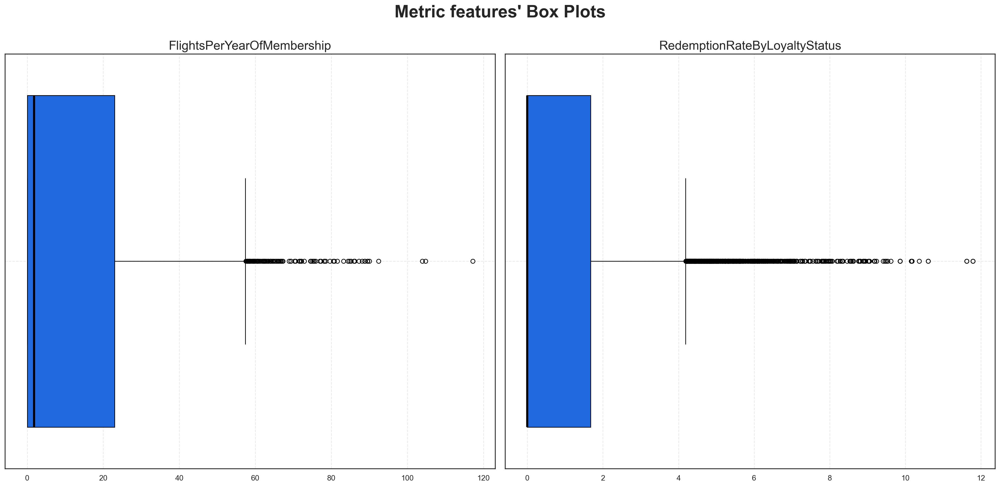

In [197]:
# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(sp_rows_merged, 
                         sp_cols_merged, 
                         figsize=(20, 10),
                         constrained_layout=True) # Adjust automatically spacing between subplot and labels 

# Increase vertical space between rows
fig.set_constrained_layout_pads(h_pad=.2)

# Plot data
# Iterate across axes objects and associate each box plot:
for ax, feat in zip(axes.flatten(), dfs_merged_new):
    sns.boxplot(x=dfs_merged_new[feat].reset_index(drop=True), ax=ax,
                color="#0062FF",
                boxprops=dict(edgecolor="black"),
                whiskerprops=dict(color="black"),
                capprops=dict(color="black"),
                medianprops=dict(color="black", linewidth=3),
                flierprops=dict(markeredgecolor="black"))

    
    # Put grid with low opacity and dashed line so it's visible, but not distracting
    ax.grid(True, linestyle="--", alpha=0.4)

    # Put title of each graph with bigger font
    ax.set_title(feat, fontsize=18)

    # Hide x label since we already have the boxlplot title at the top
    ax.set_xlabel("")
    
# Layout
# Add title and make it bigger
plt.suptitle("Metric features' Box Plots", 
             fontsize = 25, fontweight="bold")

# Create the folder '../figures/eda' if it doesn't already exist
os.makedirs(os.path.join('..', 'figures', 'eda'), exist_ok=True)

# Save figure to a png file in the folder created before
plt.savefig(os.path.join('..', 'figures', 'eda', 'numeric_features_boxplots.png'), dpi=200)

# Show plot
plt.show()

Conclusions:
- `FlightsPerYearOfMembership:` Most customers average a modest number of flights per year, but from the third quartile up to the upper whisker, there emerges a distinct group of highly frequent flyers who stand out as the most engaged segment in the dataset. Moreover, there is a significant number of outliers that fly very frequently.

- `RedemptionRateByLoyaltyStatus:` The majority of loyalty members redeem at a low to moderate rate; nevertheless, there is a long tail of high redemption outliers, indicating varied usage of loyalty benefits.

.